In [1]:
import tensorflow as tf
import pandas as pd
import numpy as np
import math
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Dropout
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt
import itertools
import random as python_random
from keras.initializers import GlorotUniform
from keras.initializers import Orthogonal
from keras.initializers import HeNormal
from keras.initializers import HeUniform
from keras.initializers import RandomNormal
from keras.regularizers import L1L2

np.random.seed(42)
tf.random.set_seed(42)
python_random.seed(42)

2024-06-08 04:48:27.057168: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-06-08 04:48:27.077289: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-08 04:48:27.077304: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-08 04:48:27.077855: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-06-08 04:48:27.081351: I tensorflow/core/platform/cpu_feature_guar

In [2]:
def load_data(filepath):
    return pd.read_csv(filepath, parse_dates=['Date'])

In [3]:
def create_sequences(data, target, n_steps):
    X, y = [], []
    # print("data", data[:15])
    # print("target", target[:15])
    for i in range(len(data) - n_steps):
        X.append(data[i:(i + n_steps)])
        y.append(target[i + n_steps])
    return np.array(X), np.array(y)

In [4]:
def modify_data(data):
    result = None
    # print(data)

    # copy LMCADY_acu_5d_log into a new column ACU_5D and shift it by 5 days
    data['ACU_5D'] = data['LMCADY_acu_5d_log']
    data['ACU_5D'] = data['ACU_5D'].shift(5)

    data['ACU_4D'] = data['LMCADY'].rolling(window=4).sum()
    data['ACU_3D'] = data['LMCADY'].rolling(window=3).sum()
    data['ACU_2D'] = data['LMCADY'].rolling(window=2).sum()

    data.dropna(inplace=True)
    data.reset_index(drop=True, inplace=True)

    result = data
    # print(result.head(10))
    return result

In [5]:
def prepare_data(df, target_column, n_steps, feature_list = []):

    df = modify_data(df)
    df.to_csv('../output/modified_data.csv', index=False)

    features = df.drop(columns=[target_column, 'LMCADY_std_5d_log'])
    features = features.drop(columns = ['Date'])
    features = features[feature_list]
    print("Features utilizados:",features.columns)

    target = df[target_column]

    scaler = StandardScaler()
    features_scaled = scaler.fit_transform(features)
    X, y = create_sequences(features_scaled, target, n_steps)
    # for i in range(15):
    #     print(X[i][0][0], y[i])
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.05, shuffle = False)

    return X_train, X_test, y_train, y_test

In [6]:
def rmse(y_true, y_pred):
    return tf.sqrt(tf.reduce_mean(tf.square(y_true - y_pred)))

In [7]:
def build_model(input_shape, md_prm: dict):
    model = Sequential()
    initializer = md_prm['initializer']  # Usando Orthogonal como inicializador

    # Añadiendo más capas LSTM y dropout
    model.add(LSTM(md_prm['lstm_units1'], return_sequences=True, input_shape=input_shape, kernel_initializer=initializer, activation='relu', dropout=0.15))
    model.add(LSTM(md_prm['lstm_units2'], return_sequences=True, kernel_initializer=initializer, activation='relu', dropout=0.15))
    model.add(LSTM(md_prm['lstm_units2'], kernel_initializer=initializer, activation='relu'))  # Capa adicional LSTM
    model.add(Dense(50, activation='relu', kernel_initializer=initializer))  # Capa Dense adicional
    model.add(Dense(1, kernel_initializer=initializer))

    model.compile(optimizer=Adam(learning_rate=0.0001), loss='mean_squared_error', metrics=[rmse])
    return model


In [8]:
def train_model(model, X_train, y_train, epochs, batch_size, verbose):

    early_stopping = EarlyStopping(
        monitor             ='val_loss',
        patience            =75,
        verbose             =1,
        restore_best_weights=True
    )

    history = model.fit(
        X_train, y_train,
        epochs              =epochs,
        batch_size          =batch_size,
        verbose             =verbose,
        callbacks           =[early_stopping],
        validation_split    =0.05
    )

    return history

In [9]:
def evaluate_model(model, X_test, y_test):
    return model.evaluate(X_test, y_test)

In [10]:
def plot_predictions(y_true, y_pred, n=-1, title="Prediction vs Actual Data", markersize=3, rmse=None):
    if n != -1:
        n = min(n, len(y_true), len(y_pred))

        y_true = y_true[-n:]
        y_pred = y_pred[-n:]

    plt.figure(figsize=(18, 2.5))
    plt.plot(y_true, label='Actual Values', marker='o', linestyle='-', markersize=markersize)

    # Plot the RMSE lines if rmse is provided
    if rmse is not None:
        plt.axhline(y= rmse, color='green', linestyle='--', linewidth=0.7)
        plt.axhline(y=-rmse, color='green', linestyle='--', linewidth=0.7)

        tot_pred = 0
        prof = 0
        loss = 0

        # plot green markers beyond the rmse range
        for i in range(len(y_pred)):
            if (y_pred[i] > rmse or y_pred[i] < - rmse):
                # print("{} {}".format(y_pred[i],y_true[i]))
                if (y_true[i] > 0 and y_pred[i] > 0) or (y_true[i] < 0 and y_pred[i] < 0):
                    plt.plot(i, y_pred[i], 'gx', markersize=markersize+1)
                    prof += 1
                else:
                    plt.plot(i, y_pred[i], 'rx', markersize=markersize+1)
                    loss += 1
                tot_pred += 1
            else:
                plt.plot(i, y_pred[i], marker='x', color='orange', markersize=markersize-1)

    else:
        plt.plot(y_true, label='Actual Values'   , marker='o', linestyle='-' , markersize=markersize)
        plt.plot(y_pred, label='Predicted Values', marker='x', linestyle='--', markersize=markersize)

    plt.axhline(y=0, color='gray', linestyle='--', linewidth=0.7)

    plt.title(title)
    plt.xlabel('Index')
    plt.ylabel('Value')
    plt.legend()
    plt.show()

    return tot_pred, prof, loss

In [11]:
def trend_accuracy(y_true, y_pred):
    trend_up_true = 0
    trend_down_true = 0
    trend_up_pred = 0
    trend_down_pred = 0

    for j in range(len(y_true)-1):
        if y_true[j] > 0.0:
            trend_up_pred += 1
            if y_pred[j] > 0.0:
                trend_up_true += 1
        if y_true[j] < 0.0:
            trend_down_pred += 1
            if y_pred[j] < 0.0:
                trend_down_true += 1

    trend_true = trend_up_true + trend_down_true
    trend_pred = trend_up_pred + trend_down_pred

    trend_up_accuracy = trend_up_true/trend_up_pred
    trend_down_accuracy = trend_down_true/trend_down_pred
    trend_accuracy = trend_true/trend_pred

    return trend_accuracy, trend_up_accuracy, trend_down_accuracy

In [12]:
n_steps_options     = [40,60,120]
batch_size_options  = [256,128]
epochs_options      = [300]

lstm_units_options1 = [75,25]
lstm_units_options2 = [25]
initializer         = [ GlorotUniform(seed=42), 
                        HeNormal(seed=42), 
                        HeUniform(seed=42), 
                        Orthogonal(seed=42)
                        ]
activation_options  = ['relu']
dropout_options     = [.15]
num_layers_options  = [2]

# # caso seleccionado
# n_steps_options     = [120]
# batch_size_options  = [256]
# epochs_options      = [300]

# lstm_units_options  = [25]
# activation_options  = ['relu']
# dropout_options     = [.15]
# num_layers_options  = [2]

# variable_options = ['LMCADS03','LMCADY','SPX','MXWD','XAU','XAG','ACU_5D','ACU_4D','ACU_3D','ACU_2D']
# modified_lists = [variable_options[:i] + variable_options[i+1:] for i in range(len(variable_options))]
# print(modified_lists)
modified_lists = [['LMCADS03','LMCADY','SPX','MXWD','XAG','XAU','ACU_5D','ACU_4D','ACU_3D','ACU_2D']]

# combinations
model_params_combinations = list(itertools.product(
    n_steps_options     ,
    lstm_units_options1,
    lstm_units_options2,
    initializer        ,
    activation_options,
    dropout_options,
    num_layers_options,
    batch_size_options,
    epochs_options,
    modified_lists
))
target_column = 'LMCADY_acu_5d_log'

In [13]:
n_iterations = len(model_params_combinations)
print("Total iterations: {}".format(n_iterations))

Total iterations: 144


In [14]:
def run_model_iterations():
    top_results = []
    i = 1
    for params in model_params_combinations:
        n_steps, lstm_units1, lstm_units2, initializer, activation, dropout, num_layers, batch_size, epochs, var_options = params
        try:

            # data load
            df = load_data("../input/copper_log_returns_5d_final.csv")
            print("\nIteration {}/{}".format(i, n_iterations))
            # print("Params: n_steps: {}, lstm_units1: {}, lstm_units2: {}, activation: {}, dropout: {}, num_layers: {}".format(
            #     n_steps, lstm_units1, lstm_units2, activation, dropout, num_layers)
            # )

            print("Train : batch    > {}".format(batch_size))
            print("        epochs   > {}".format(epochs))
            print("        n_steps  > {}".format(n_steps))
            
            # data preparation
            # print("Variables used: {}".format(var_options))
            X_train, X_test, y_train, y_test = prepare_data(df, target_column, n_steps, var_options)

            # build model
            model_params = {
                'lstm_units1'   : lstm_units1,
                'lstm_units2'   : lstm_units2,
                'activation'    : activation,
                'dropout'       : dropout,
                'num_layers'    : num_layers,
                'initializer'   : initializer
            }
            print("Model params: \n{}".format(model_params))

            input_shape = (X_train.shape[1], X_train.shape[2])
            print("Input shape: {}".format(input_shape))
            model = build_model(input_shape, model_params)
            print(model.summary())

            # model train
            if True:
                history = train_model(model, X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=0)

                # model evaluation
                y_pred      = model.predict(X_test)
                rmse_score  = math.sqrt(mean_squared_error(y_test, y_pred))
                std_dev     = np.std(y_test)

                print("Pred std dev: {:.6f}, test std dev: {:.6f}".format(np.std(y_pred), std_dev))

                if rmse_score < std_dev:
                    diff = rmse_score - std_dev + abs(np.std(y_pred) - std_dev)/4.0
                else:
                    diff = (rmse_score - std_dev) + abs(np.std(y_pred) - std_dev)/2.0

                # diff = (rmse_score - std_dev) + abs(np.std(y_pred) - std_dev)/2.0
                tren_acc, trend_up, trend_down = trend_accuracy(y_test, y_pred)
                result = {
                    'md_prm'    : model_params,
                    'n_steps'   : n_steps,
                    'batch_size': batch_size,
                    'epochs'    : epochs,
                    'rmse'      : rmse_score,
                    'std_dev'   : std_dev,
                    'diff'      : diff,
                    'predictions': y_pred,
                    'true_values': y_test,
                    'feature_list': var_options,
                    'tr_ac': tren_acc,
                    'tr_up': trend_up,
                    'tr_down': trend_down
                }

                # print("RMSE: {:.6f}, STD_DEV: {:.6f}, DIFF: {:.6f}".format(rmse_score, std_dev, diff))
                print("RMSE: {:.6f}, STD_DEV: {:.6f}, STD_PRD: {:.6f}, OBJDIFF: {:.6f}, RDIFF: {:.6f}".format(rmse_score, std_dev, np.std(y_pred), diff, (rmse_score - std_dev)))

                print("Trend: {:.2f}, Up: {:.2f}, Down: {:.2f}".format(tren_acc*100, trend_up*100, trend_down*100))

                top_results.append(result)
                top_results = sorted(top_results, key=lambda x: x['diff'])
                tot_pred, prof, loss = plot_predictions(result['true_values'], result['predictions'], -1, title="It. {}".format(i),rmse = rmse_score)
                print("Total TH Pred.: {}".format(tot_pred))
                if tot_pred != 0:
                    print("TH Pred. acc. : {:.2f}".format(prof*100.0/tot_pred))

            print("Completed Iteration {}/{}".format(i, n_iterations))
        except Exception as ex:
            print(f"An error occurred: {ex}. Skipping this combination.")
        i += 1
    return top_results


Iteration 1/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (40, 10)


2024-06-08 04:48:28.278560: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-08 04:48:28.297215: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-08 04:48:28.297337: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 40, 25)            3600      
                                                                 
 lstm_1 (LSTM)               (None, 25)                5100      
                                                                 
 dense (Dense)               (None, 1)                 26        
                                                                 
Total params: 8726 (34.09 KB)
Trainable params: 8726 (34.09 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
None


2024-06-08 04:48:31.274120: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902
2024-06-08 04:48:31.603470: I external/local_xla/xla/service/service.cc:168] XLA service 0x74937814bf70 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-06-08 04:48:31.603484: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 3080, Compute Capability 8.6
2024-06-08 04:48:31.606348: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1717840111.657588  864970 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


Restoring model weights from the end of the best epoch: 20.
Epoch 95: early stopping
9/9 [==============================] - 0s 2ms/step
Pred std dev: 0.007593, test std dev: 0.021968
RMSE: 0.021396, STD_DEV: 0.021968, STD_PRD: 0.007593, OBJDIFF: 0.003022, RDIFF: -0.000572
Trend: 59.27, Up: 76.71, Down: 39.53


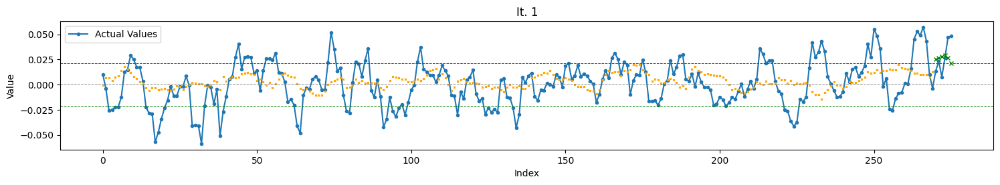

Total TH Pred.: 6
TH Pred. acc. : 100.00
Completed Iteration 1/144

Iteration 2/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (40, 10)
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_2 (LSTM)               (None, 40, 25)            3600      
                                                                 
 lstm_3 (LSTM)               (None, 25)                5100      
                                                                 
 dense_1 (Dense)             (None, 1)                 2

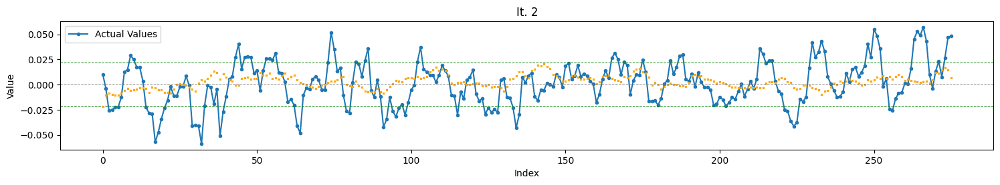

Total TH Pred.: 0
Completed Iteration 2/144

Iteration 3/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (40, 10)
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (None, 40, 25)            3600      
                                                                 
 lstm_5 (LSTM)               (None, 25)                5100      
                                                                 
 dense_2 (Dense)             (None, 1)                 26        
              

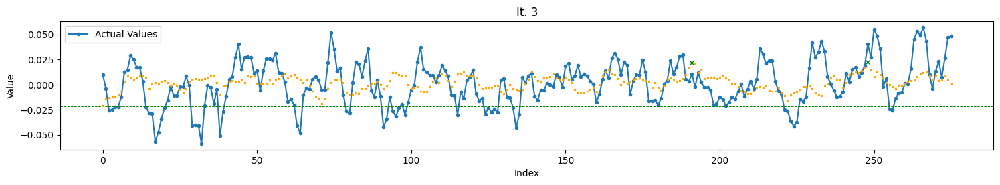

Total TH Pred.: 2
TH Pred. acc. : 100.00
Completed Iteration 3/144

Iteration 4/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (40, 10)
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_6 (LSTM)               (None, 40, 25)            3600      
                                                                 
 lstm_7 (LSTM)               (None, 25)                5100      
                                                                 
 dense_3 (Dense)             (None, 1)                 26    

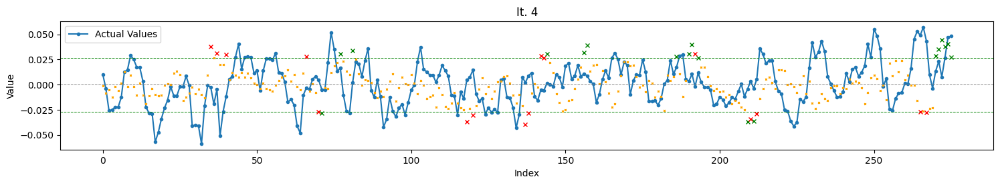

Total TH Pred.: 34
TH Pred. acc. : 52.94
Completed Iteration 4/144

Iteration 5/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (40, 10)
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_8 (LSTM)               (None, 40, 25)            3600      
                                                                 
 lstm_9 (LSTM)               (None, 25)                5100      
                                                                 
 dense_4 (Dense)             (None, 1)                 26    

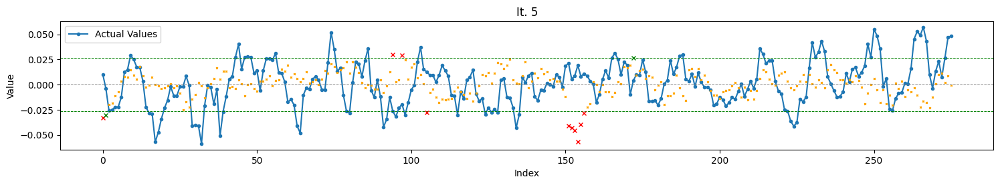

Total TH Pred.: 12
TH Pred. acc. : 16.67
Completed Iteration 5/144

Iteration 6/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (40, 10)
Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_10 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_11 (LSTM)              (None, 25)                5100      
                                                                 
 dense_5 (Dense)             (None, 1)                 26     

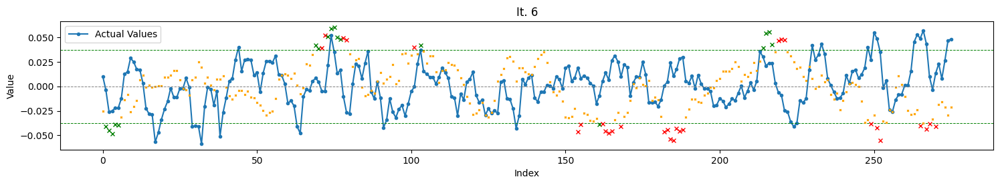

Total TH Pred.: 47
TH Pred. acc. : 38.30
Completed Iteration 6/144

Iteration 7/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (40, 10)
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_12 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_13 (LSTM)              (None, 25)                5100      
                                                                 
 dense_6 (Dense)             (None, 1)                 26   

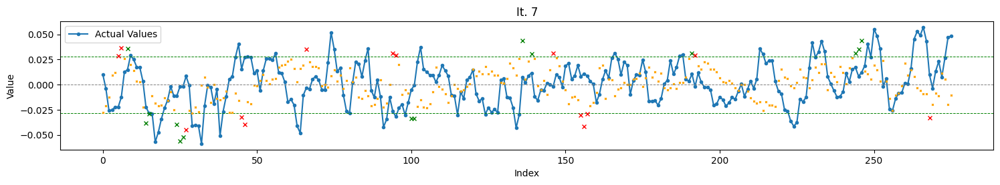

Total TH Pred.: 28
TH Pred. acc. : 50.00
Completed Iteration 7/144

Iteration 8/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (40, 10)
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_14 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_15 (LSTM)              (None, 25)                5100      
                                                                 
 dense_7 (Dense)             (None, 1)                 26   

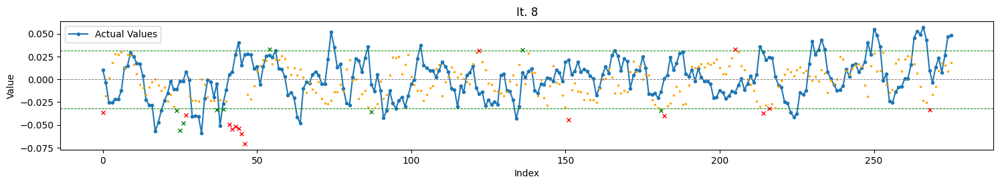

Total TH Pred.: 24
TH Pred. acc. : 37.50
Completed Iteration 8/144

Iteration 9/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (40, 10)
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_16 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_17 (LSTM)              (None, 25)                5100      
                                                                 
 dense_8 (Dense)             (None, 1)                 26    

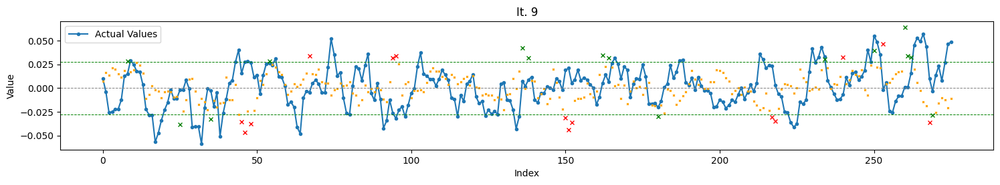

Total TH Pred.: 29
TH Pred. acc. : 51.72
Completed Iteration 9/144

Iteration 10/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (40, 10)
Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_18 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_19 (LSTM)              (None, 25)                5100      
                                                                 
 dense_9 (Dense)             (None, 1)                 26 

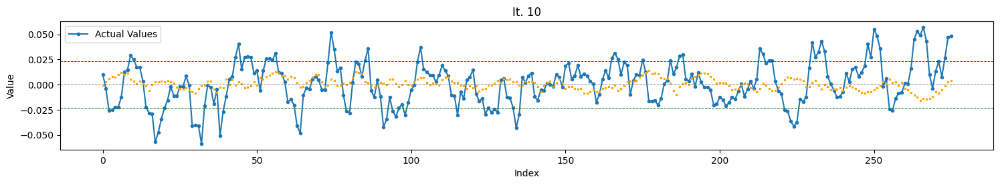

Total TH Pred.: 0
Completed Iteration 10/144

Iteration 11/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (40, 10)
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_20 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_21 (LSTM)              (None, 25)                5100      
                                                                 
 dense_10 (Dense)            (None, 1)                 26        
             

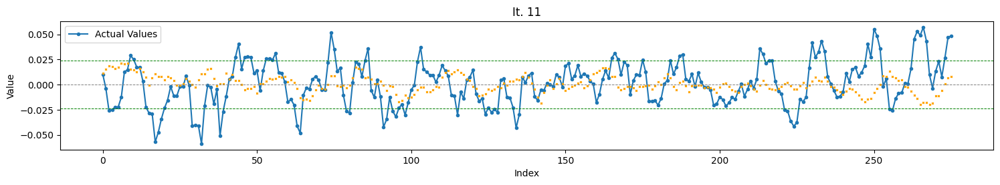

Total TH Pred.: 0
Completed Iteration 11/144

Iteration 12/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (40, 10)
Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_22 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_23 (LSTM)              (None, 25)                5100      
                                                                 
 dense_11 (Dense)            (None, 1)                 26        
              

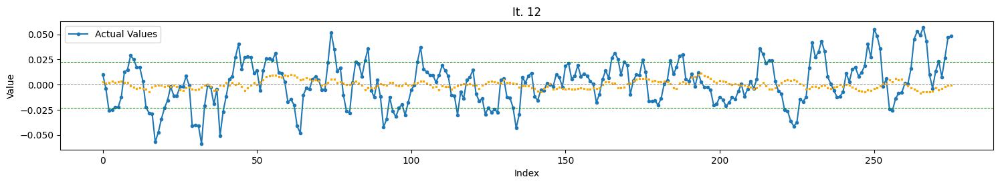

Total TH Pred.: 0
Completed Iteration 12/144

Iteration 13/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (40, 10)
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_24 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_25 (LSTM)              (None, 75)                30300     
                                                                 
 dense_12 (Dense)            (None, 1)                 76        
          

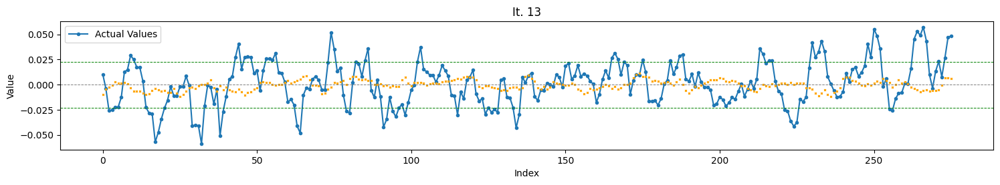

Total TH Pred.: 0
Completed Iteration 13/144

Iteration 14/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (40, 10)
Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_26 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_27 (LSTM)              (None, 75)                30300     
                                                                 
 dense_13 (Dense)            (None, 1)                 76        
          

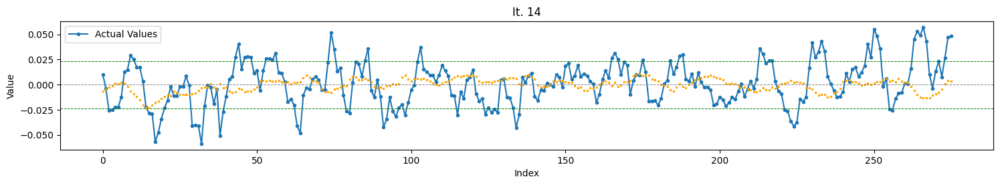

Total TH Pred.: 0
Completed Iteration 14/144

Iteration 15/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (40, 10)
Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_28 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_29 (LSTM)              (None, 75)                30300     
                                                                 
 dense_14 (Dense)            (None, 1)                 76        
           

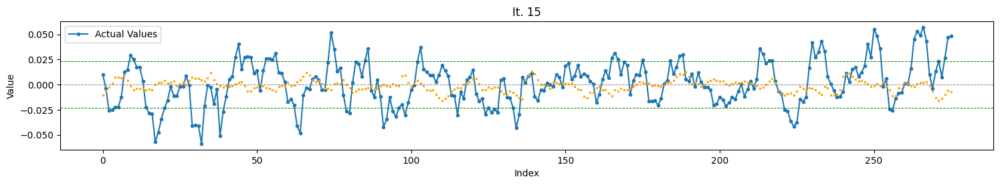

Total TH Pred.: 0
Completed Iteration 15/144

Iteration 16/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (40, 10)
Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_30 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_31 (LSTM)              (None, 75)                30300     
                                                                 
 dense_15 (Dense)            (None, 1)                 76        
               

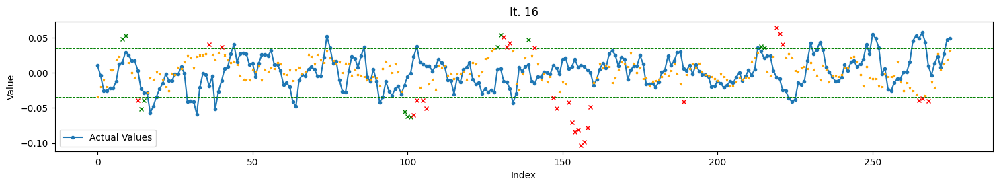

Total TH Pred.: 40
TH Pred. acc. : 30.00
Completed Iteration 16/144

Iteration 17/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (40, 10)
Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_32 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_33 (LSTM)              (None, 75)                30300     
                                                                 
 dense_16 (Dense)            (None, 1)                 76 

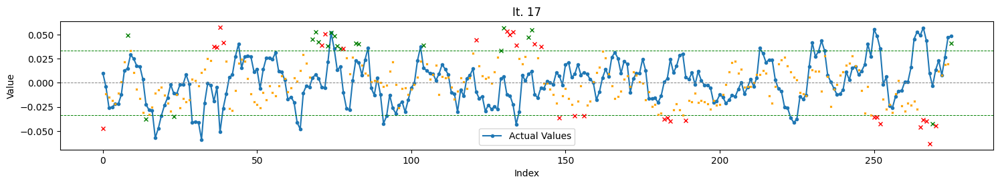

Total TH Pred.: 50
TH Pred. acc. : 40.00
Completed Iteration 17/144

Iteration 18/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (40, 10)
Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_34 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_35 (LSTM)              (None, 75)                30300     
                                                                 
 dense_17 (Dense)            (None, 1)                 76  

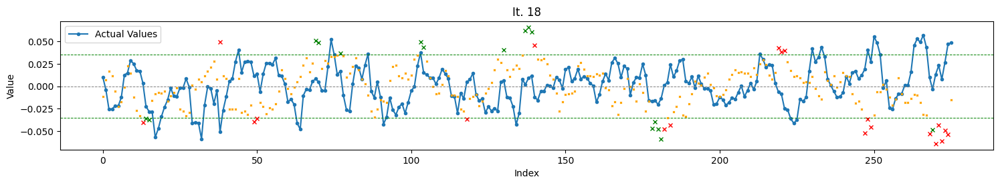

Total TH Pred.: 36
TH Pred. acc. : 44.44
Completed Iteration 18/144

Iteration 19/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (40, 10)
Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_36 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_37 (LSTM)              (None, 75)                30300     
                                                                 
 dense_18 (Dense)            (None, 1)                 76

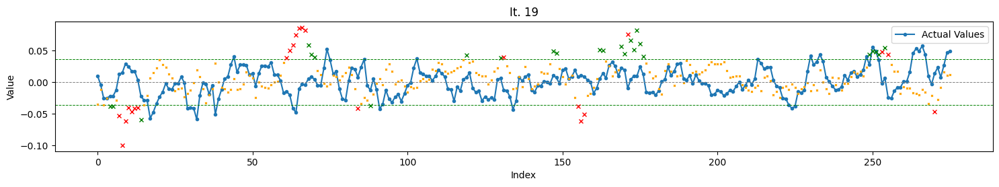

Total TH Pred.: 48
TH Pred. acc. : 52.08
Completed Iteration 19/144

Iteration 20/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (40, 10)
Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_38 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_39 (LSTM)              (None, 75)                30300     
                                                                 
 dense_19 (Dense)            (None, 1)                 76

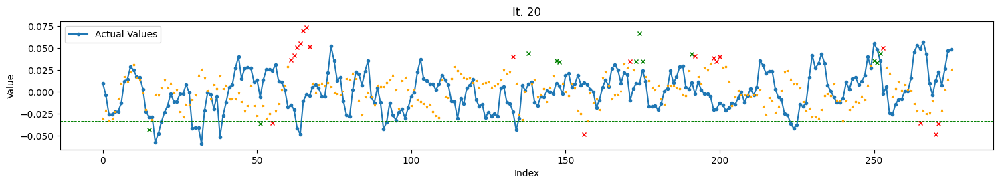

Total TH Pred.: 31
TH Pred. acc. : 38.71
Completed Iteration 20/144

Iteration 21/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (40, 10)
Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_40 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_41 (LSTM)              (None, 75)                30300     
                                                                 
 dense_20 (Dense)            (None, 1)                 76 

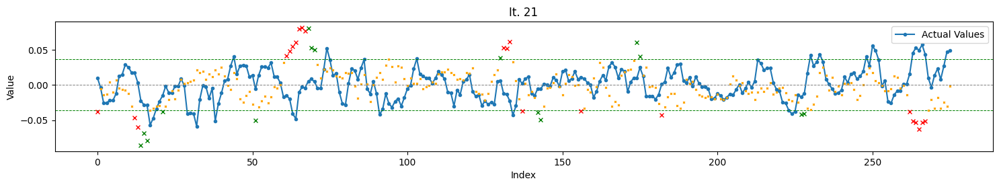

Total TH Pred.: 37
TH Pred. acc. : 40.54
Completed Iteration 21/144

Iteration 22/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (40, 10)
Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_42 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_43 (LSTM)              (None, 75)                30300     
                                                                 
 dense_21 (Dense)            (None, 1)                 7

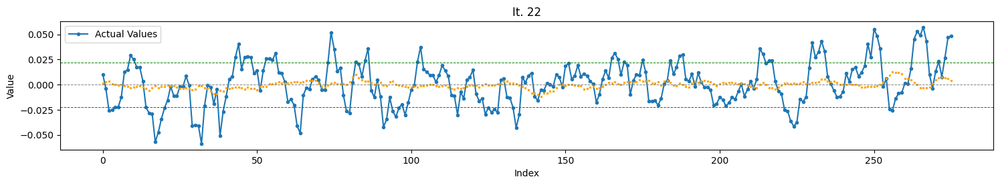

Total TH Pred.: 0
Completed Iteration 22/144

Iteration 23/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (40, 10)
Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_44 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_45 (LSTM)              (None, 75)                30300     
                                                                 
 dense_22 (Dense)            (None, 1)                 76        
             

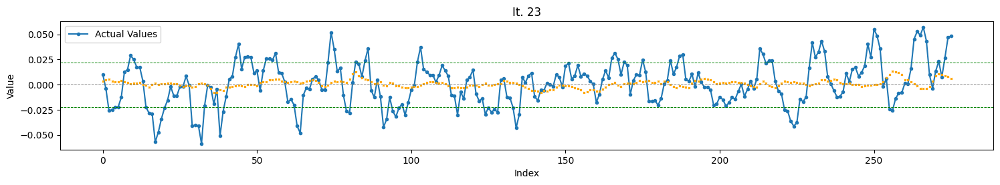

Total TH Pred.: 0
Completed Iteration 23/144

Iteration 24/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (40, 10)
Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_46 (LSTM)              (None, 40, 25)            3600      
                                                                 
 lstm_47 (LSTM)              (None, 75)                30300     
                                                                 
 dense_23 (Dense)            (None, 1)                 76        
              

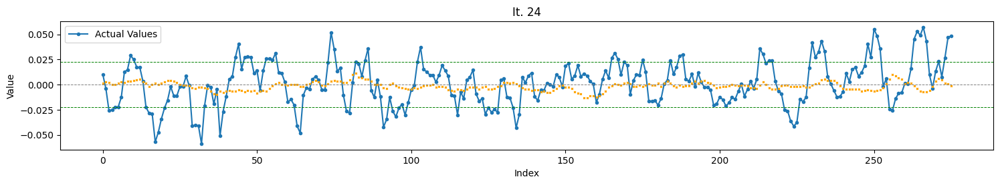

Total TH Pred.: 0
Completed Iteration 24/144

Iteration 25/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (40, 10)
Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_48 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_49 (LSTM)              (None, 25)                10100     
                                                                 
 dense_24 (Dense)            (None, 1)                 26        
          

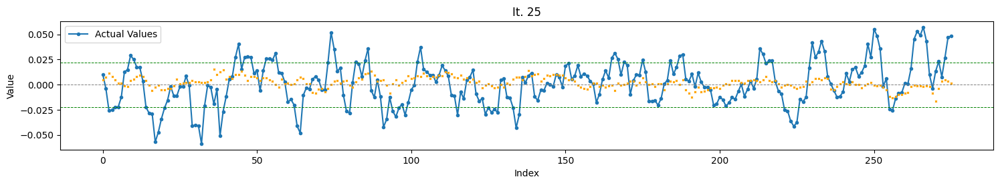

Total TH Pred.: 0
Completed Iteration 25/144

Iteration 26/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (40, 10)
Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_50 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_51 (LSTM)              (None, 25)                10100     
                                                                 
 dense_25 (Dense)            (None, 1)                 26        
          

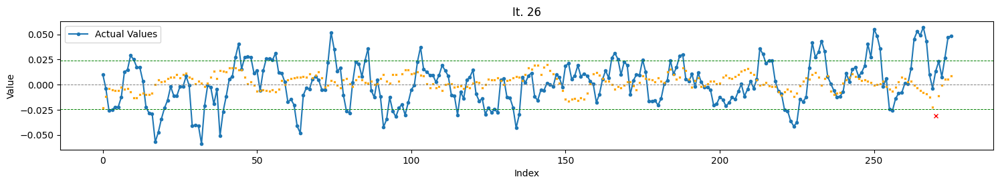

Total TH Pred.: 1
TH Pred. acc. : 0.00
Completed Iteration 26/144

Iteration 27/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (40, 10)
Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_52 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_53 (LSTM)              (None, 25)                10100     
                                                                 
 dense_26 (Dense)            (None, 1)                 2

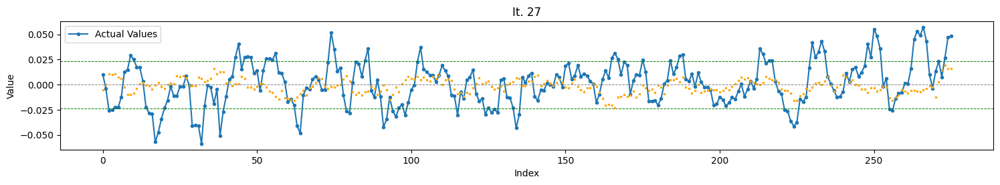

Total TH Pred.: 0
Completed Iteration 27/144

Iteration 28/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (40, 10)
Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_54 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_55 (LSTM)              (None, 25)                10100     
                                                                 
 dense_27 (Dense)            (None, 1)                 26        
               

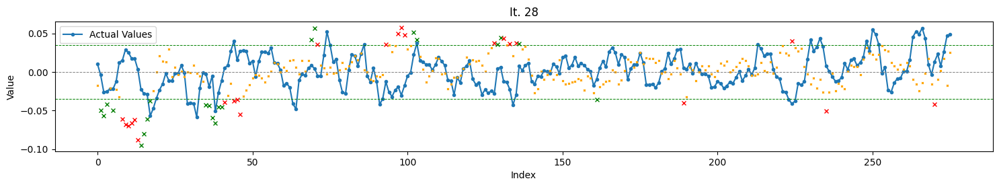

Total TH Pred.: 45
TH Pred. acc. : 48.89
Completed Iteration 28/144

Iteration 29/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (40, 10)
Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_56 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_57 (LSTM)              (None, 25)                10100     
                                                                 
 dense_28 (Dense)            (None, 1)                 26 

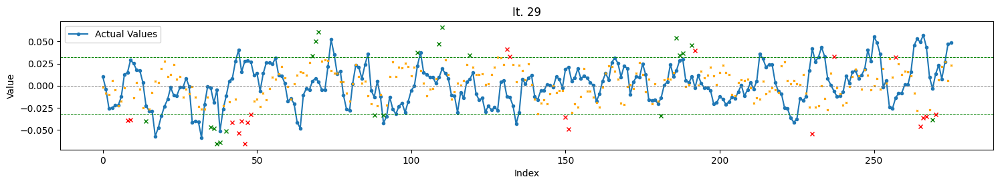

Total TH Pred.: 41
TH Pred. acc. : 51.22
Completed Iteration 29/144

Iteration 30/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (40, 10)
Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_58 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_59 (LSTM)              (None, 25)                10100     
                                                                 
 dense_29 (Dense)            (None, 1)                 26  

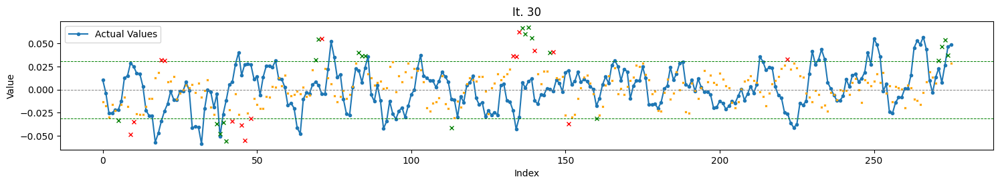

Total TH Pred.: 37
TH Pred. acc. : 56.76
Completed Iteration 30/144

Iteration 31/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (40, 10)
Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_60 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_61 (LSTM)              (None, 25)                10100     
                                                                 
 dense_30 (Dense)            (None, 1)                 26

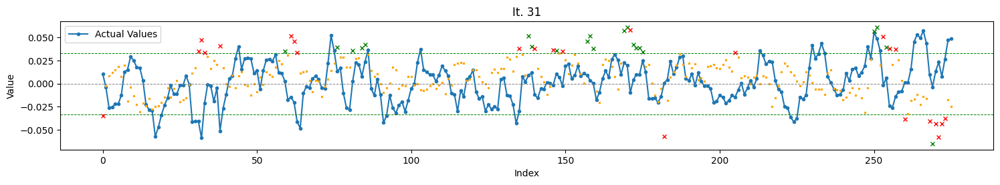

Total TH Pred.: 45
TH Pred. acc. : 46.67
Completed Iteration 31/144

Iteration 32/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (40, 10)
Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_62 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_63 (LSTM)              (None, 25)                10100     
                                                                 
 dense_31 (Dense)            (None, 1)                 26

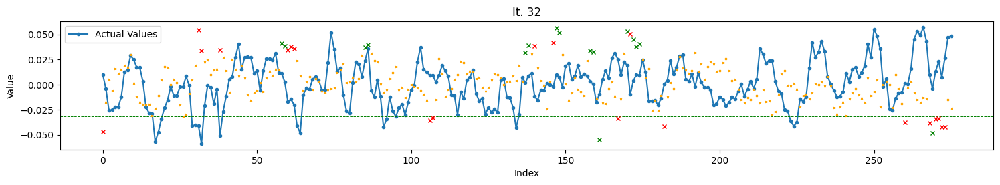

Total TH Pred.: 36
TH Pred. acc. : 44.44
Completed Iteration 32/144

Iteration 33/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (40, 10)
Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_64 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_65 (LSTM)              (None, 25)                10100     
                                                                 
 dense_32 (Dense)            (None, 1)                 26 

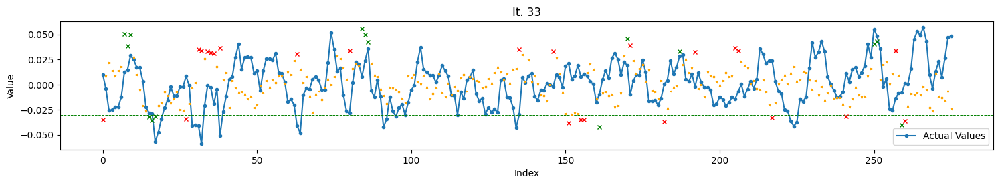

Total TH Pred.: 39
TH Pred. acc. : 38.46
Completed Iteration 33/144

Iteration 34/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (40, 10)
Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_66 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_67 (LSTM)              (None, 25)                10100     
                                                                 
 dense_33 (Dense)            (None, 1)                 2

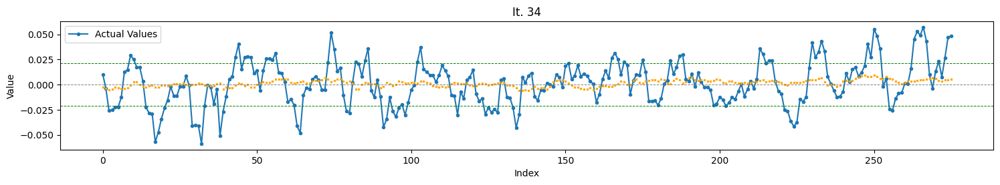

Total TH Pred.: 0
Completed Iteration 34/144

Iteration 35/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (40, 10)
Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_68 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_69 (LSTM)              (None, 25)                10100     
                                                                 
 dense_34 (Dense)            (None, 1)                 26        
             

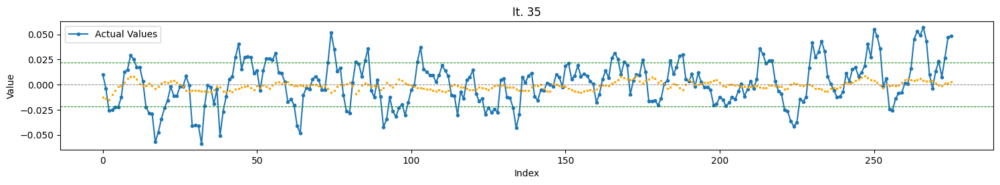

Total TH Pred.: 0
Completed Iteration 35/144

Iteration 36/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (40, 10)
Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_70 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_71 (LSTM)              (None, 25)                10100     
                                                                 
 dense_35 (Dense)            (None, 1)                 26        
              

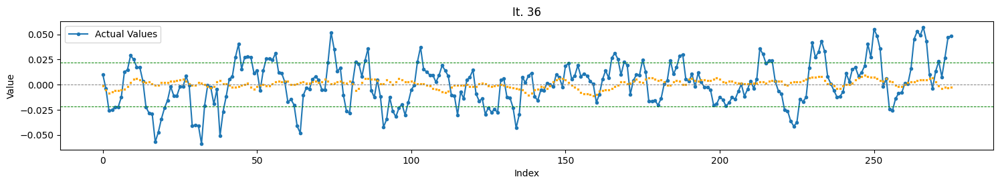

Total TH Pred.: 0
Completed Iteration 36/144

Iteration 37/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (40, 10)
Model: "sequential_36"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_72 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_73 (LSTM)              (None, 75)                45300     
                                                                 
 dense_36 (Dense)            (None, 1)                 76        
          

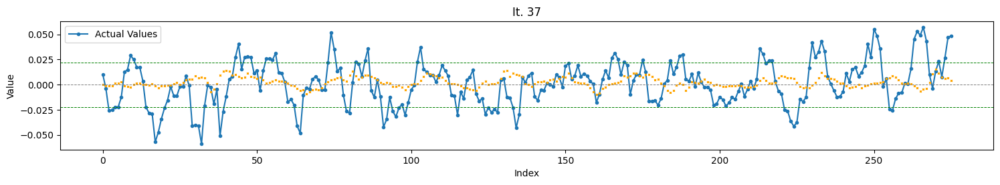

Total TH Pred.: 0
Completed Iteration 37/144

Iteration 38/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (40, 10)
Model: "sequential_37"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_74 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_75 (LSTM)              (None, 75)                45300     
                                                                 
 dense_37 (Dense)            (None, 1)                 76        
          

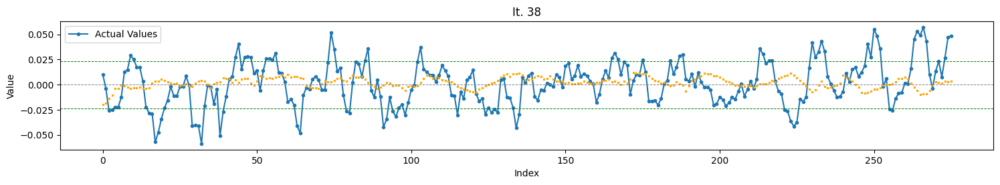

Total TH Pred.: 0
Completed Iteration 38/144

Iteration 39/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (40, 10)
Model: "sequential_38"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_76 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_77 (LSTM)              (None, 75)                45300     
                                                                 
 dense_38 (Dense)            (None, 1)                 76        
           

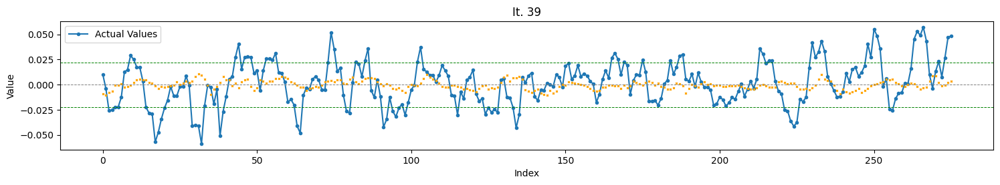

Total TH Pred.: 0
Completed Iteration 39/144

Iteration 40/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (40, 10)
Model: "sequential_39"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_78 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_79 (LSTM)              (None, 75)                45300     
                                                                 
 dense_39 (Dense)            (None, 1)                 76        
               

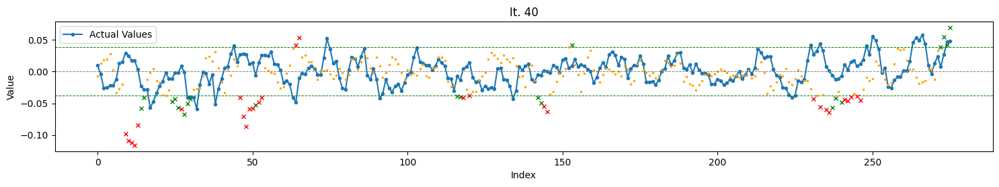

Total TH Pred.: 49
TH Pred. acc. : 42.86
Completed Iteration 40/144

Iteration 41/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (40, 10)
Model: "sequential_40"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_80 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_81 (LSTM)              (None, 75)                45300     
                                                                 
 dense_40 (Dense)            (None, 1)                 76 

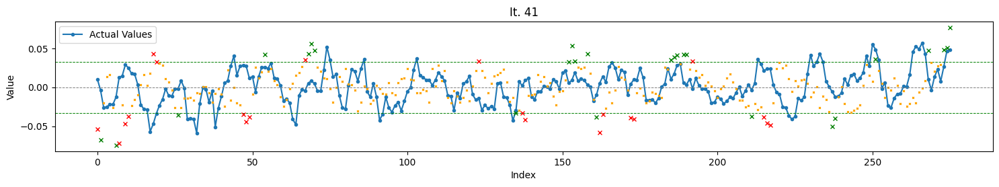

Total TH Pred.: 47
TH Pred. acc. : 55.32
Completed Iteration 41/144

Iteration 42/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (40, 10)
Model: "sequential_41"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_82 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_83 (LSTM)              (None, 75)                45300     
                                                                 
 dense_41 (Dense)            (None, 1)                 76  

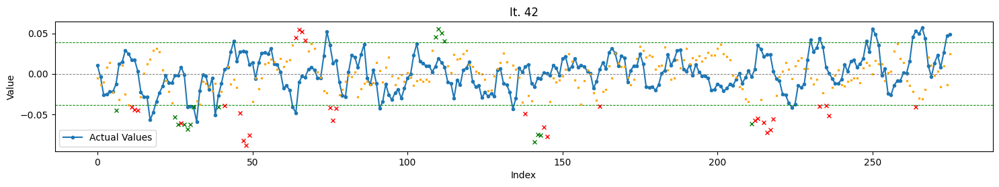

Total TH Pred.: 46
TH Pred. acc. : 34.78
Completed Iteration 42/144

Iteration 43/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (40, 10)
Model: "sequential_42"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_84 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_85 (LSTM)              (None, 75)                45300     
                                                                 
 dense_42 (Dense)            (None, 1)                 76

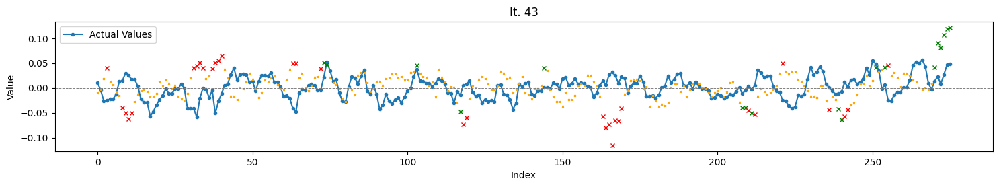

Total TH Pred.: 50
TH Pred. acc. : 36.00
Completed Iteration 43/144

Iteration 44/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (40, 10)
Model: "sequential_43"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_86 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_87 (LSTM)              (None, 75)                45300     
                                                                 
 dense_43 (Dense)            (None, 1)                 76

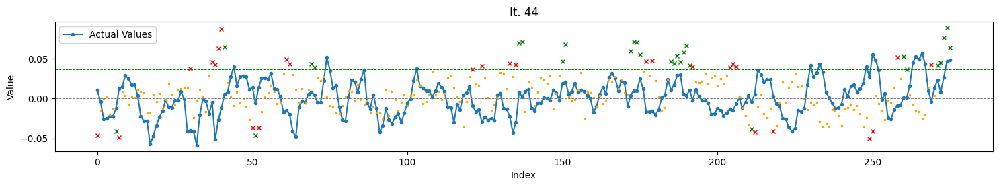

Total TH Pred.: 55
TH Pred. acc. : 50.91
Completed Iteration 44/144

Iteration 45/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (40, 10)
Model: "sequential_44"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_88 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_89 (LSTM)              (None, 75)                45300     
                                                                 
 dense_44 (Dense)            (None, 1)                 76 

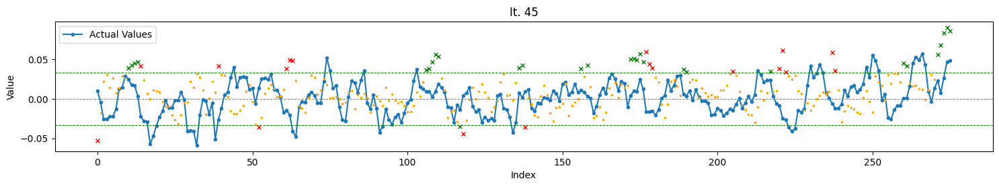

Total TH Pred.: 47
TH Pred. acc. : 61.70
Completed Iteration 45/144

Iteration 46/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (40, 10)
Model: "sequential_45"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_90 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_91 (LSTM)              (None, 75)                45300     
                                                                 
 dense_45 (Dense)            (None, 1)                 7

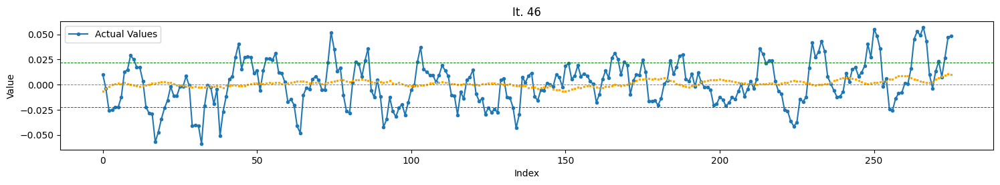

Total TH Pred.: 0
Completed Iteration 46/144

Iteration 47/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (40, 10)
Model: "sequential_46"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_92 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_93 (LSTM)              (None, 75)                45300     
                                                                 
 dense_46 (Dense)            (None, 1)                 76        
             

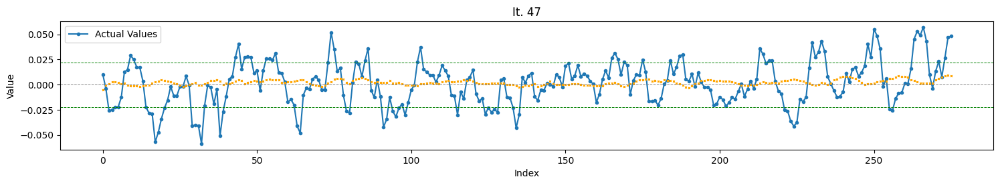

Total TH Pred.: 0
Completed Iteration 47/144

Iteration 48/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 40
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (40, 10)
Model: "sequential_47"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_94 (LSTM)              (None, 40, 75)            25800     
                                                                 
 lstm_95 (LSTM)              (None, 75)                45300     
                                                                 
 dense_47 (Dense)            (None, 1)                 76        
              

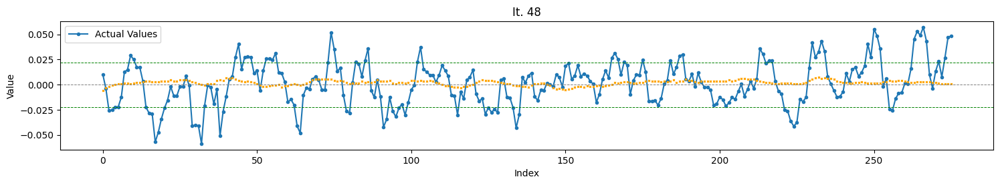

Total TH Pred.: 0
Completed Iteration 48/144

Iteration 49/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (60, 10)
Model: "sequential_48"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_96 (LSTM)              (None, 60, 25)            3600      
                                                                 
 lstm_97 (LSTM)              (None, 25)                5100      
                                                                 
 dense_48 (Dense)            (None, 1)                 26        
          

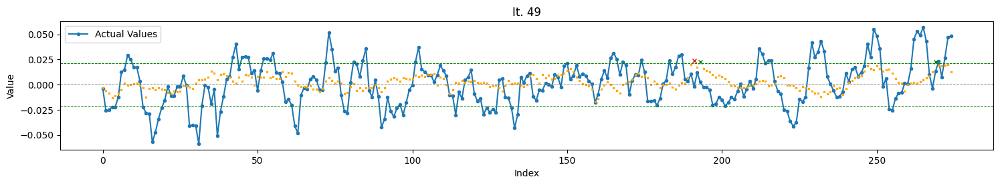

Total TH Pred.: 3
TH Pred. acc. : 66.67
Completed Iteration 49/144

Iteration 50/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (60, 10)
Model: "sequential_49"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_98 (LSTM)              (None, 60, 25)            3600      
                                                                 
 lstm_99 (LSTM)              (None, 25)                5100      
                                                                 
 dense_49 (Dense)            (None, 1)                

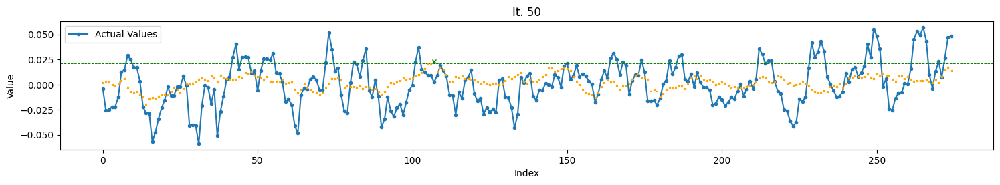

Total TH Pred.: 1
TH Pred. acc. : 100.00
Completed Iteration 50/144

Iteration 51/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (60, 10)
Model: "sequential_50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_100 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_101 (LSTM)             (None, 25)                5100      
                                                                 
 dense_50 (Dense)            (None, 1)                

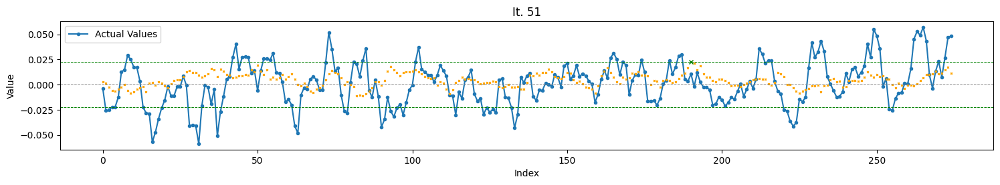

Total TH Pred.: 1
TH Pred. acc. : 100.00
Completed Iteration 51/144

Iteration 52/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (60, 10)
Model: "sequential_51"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_102 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_103 (LSTM)             (None, 25)                5100      
                                                                 
 dense_51 (Dense)            (None, 1)                 26 

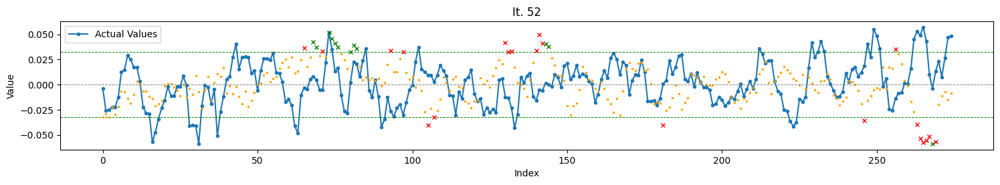

Total TH Pred.: 33
TH Pred. acc. : 36.36
Completed Iteration 52/144

Iteration 53/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (60, 10)
Model: "sequential_52"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_104 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_105 (LSTM)             (None, 25)                5100      
                                                                 
 dense_52 (Dense)            (None, 1)                 26 

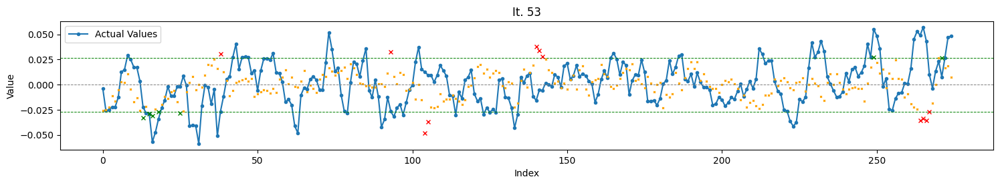

Total TH Pred.: 18
TH Pred. acc. : 38.89
Completed Iteration 53/144

Iteration 54/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (60, 10)
Model: "sequential_53"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_106 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_107 (LSTM)             (None, 25)                5100      
                                                                 
 dense_53 (Dense)            (None, 1)                 26  

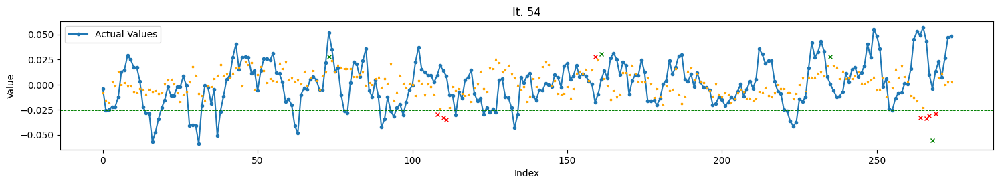

Total TH Pred.: 12
TH Pred. acc. : 33.33
Completed Iteration 54/144

Iteration 55/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (60, 10)
Model: "sequential_54"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_108 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_109 (LSTM)             (None, 25)                5100      
                                                                 
 dense_54 (Dense)            (None, 1)                 26

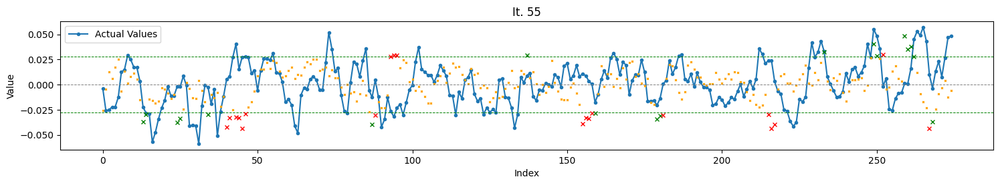

Total TH Pred.: 38
TH Pred. acc. : 47.37
Completed Iteration 55/144

Iteration 56/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (60, 10)
Model: "sequential_55"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_110 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_111 (LSTM)             (None, 25)                5100      
                                                                 
 dense_55 (Dense)            (None, 1)                 26

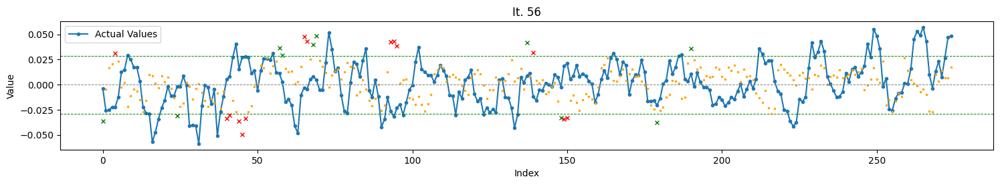

Total TH Pred.: 24
TH Pred. acc. : 41.67
Completed Iteration 56/144

Iteration 57/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (60, 10)
Model: "sequential_56"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_112 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_113 (LSTM)             (None, 25)                5100      
                                                                 
 dense_56 (Dense)            (None, 1)                 26 

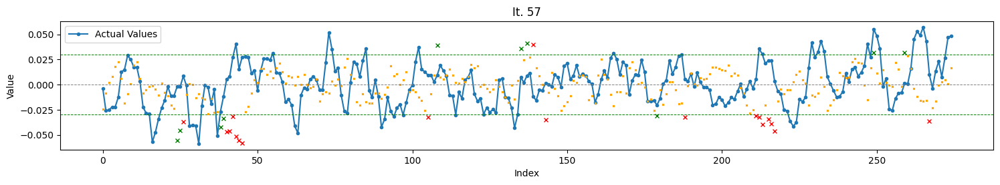

Total TH Pred.: 28
TH Pred. acc. : 35.71
Completed Iteration 57/144

Iteration 58/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (60, 10)
Model: "sequential_57"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_114 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_115 (LSTM)             (None, 25)                5100      
                                                                 
 dense_57 (Dense)            (None, 1)                 2

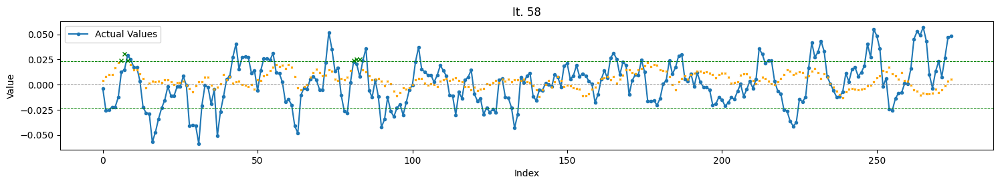

Total TH Pred.: 6
TH Pred. acc. : 100.00
Completed Iteration 58/144

Iteration 59/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (60, 10)
Model: "sequential_58"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_116 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_117 (LSTM)             (None, 25)                5100      
                                                                 
 dense_58 (Dense)            (None, 1)                 2

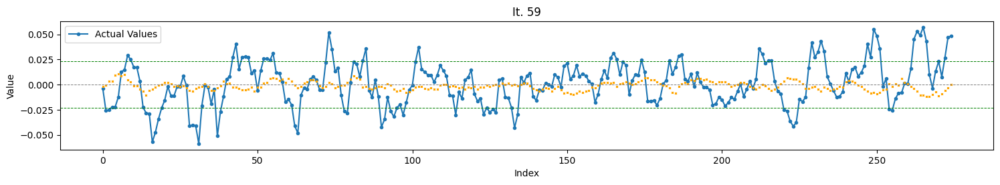

Total TH Pred.: 0
Completed Iteration 59/144

Iteration 60/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (60, 10)
Model: "sequential_59"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_118 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_119 (LSTM)             (None, 25)                5100      
                                                                 
 dense_59 (Dense)            (None, 1)                 26        
              

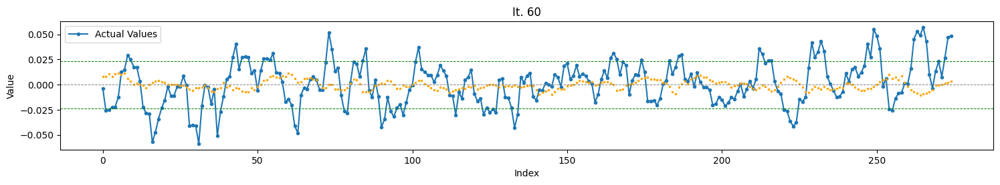

Total TH Pred.: 0
Completed Iteration 60/144

Iteration 61/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (60, 10)
Model: "sequential_60"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_120 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_121 (LSTM)             (None, 75)                30300     
                                                                 
 dense_60 (Dense)            (None, 1)                 76        
          

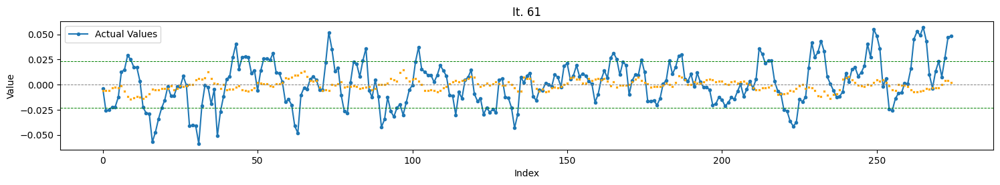

Total TH Pred.: 0
Completed Iteration 61/144

Iteration 62/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (60, 10)
Model: "sequential_61"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_122 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_123 (LSTM)             (None, 75)                30300     
                                                                 
 dense_61 (Dense)            (None, 1)                 76        
          

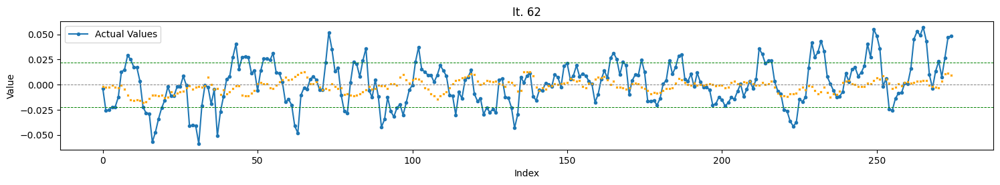

Total TH Pred.: 0
Completed Iteration 62/144

Iteration 63/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (60, 10)
Model: "sequential_62"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_124 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_125 (LSTM)             (None, 75)                30300     
                                                                 
 dense_62 (Dense)            (None, 1)                 76        
           

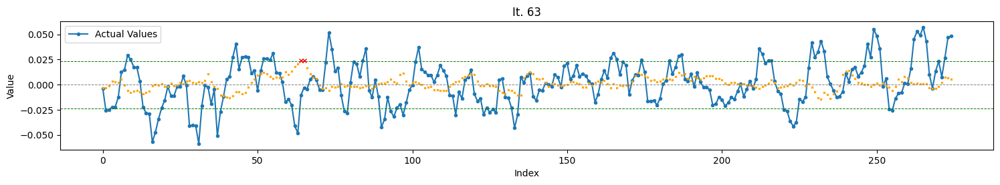

Total TH Pred.: 2
TH Pred. acc. : 0.00
Completed Iteration 63/144

Iteration 64/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (60, 10)
Model: "sequential_63"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_126 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_127 (LSTM)             (None, 75)                30300     
                                                                 
 dense_63 (Dense)            (None, 1)                 76   

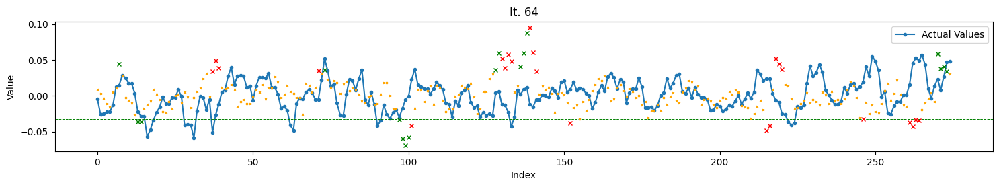

Total TH Pred.: 40
TH Pred. acc. : 42.50
Completed Iteration 64/144

Iteration 65/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (60, 10)
Model: "sequential_64"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_128 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_129 (LSTM)             (None, 75)                30300     
                                                                 
 dense_64 (Dense)            (None, 1)                 76 

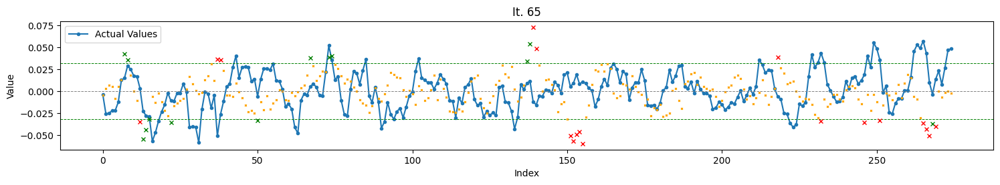

Total TH Pred.: 31
TH Pred. acc. : 41.94
Completed Iteration 65/144

Iteration 66/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (60, 10)
Model: "sequential_65"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_130 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_131 (LSTM)             (None, 75)                30300     
                                                                 
 dense_65 (Dense)            (None, 1)                 76  

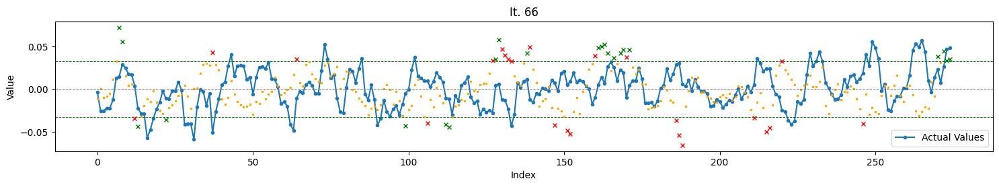

Total TH Pred.: 45
TH Pred. acc. : 48.89
Completed Iteration 66/144

Iteration 67/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (60, 10)
Model: "sequential_66"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_132 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_133 (LSTM)             (None, 75)                30300     
                                                                 
 dense_66 (Dense)            (None, 1)                 76

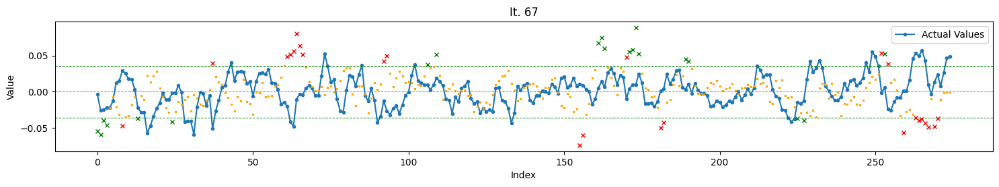

Total TH Pred.: 45
TH Pred. acc. : 44.44
Completed Iteration 67/144

Iteration 68/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (60, 10)
Model: "sequential_67"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_134 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_135 (LSTM)             (None, 75)                30300     
                                                                 
 dense_67 (Dense)            (None, 1)                 76

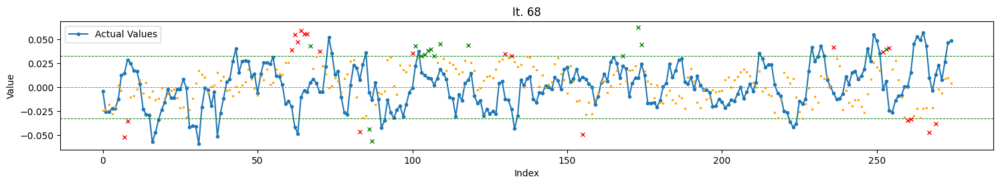

Total TH Pred.: 36
TH Pred. acc. : 41.67
Completed Iteration 68/144

Iteration 69/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (60, 10)
Model: "sequential_68"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_136 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_137 (LSTM)             (None, 75)                30300     
                                                                 
 dense_68 (Dense)            (None, 1)                 76 

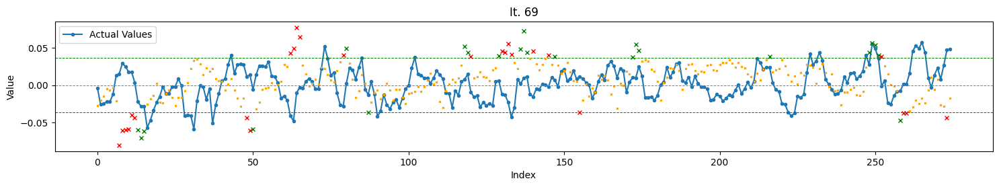

Total TH Pred.: 47
TH Pred. acc. : 46.81
Completed Iteration 69/144

Iteration 70/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (60, 10)
Model: "sequential_69"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_138 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_139 (LSTM)             (None, 75)                30300     
                                                                 
 dense_69 (Dense)            (None, 1)                 7

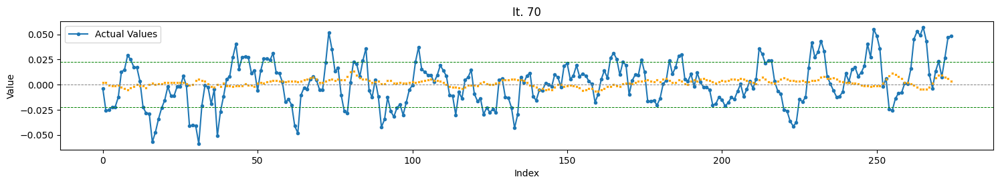

Total TH Pred.: 0
Completed Iteration 70/144

Iteration 71/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (60, 10)
Model: "sequential_70"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_140 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_141 (LSTM)             (None, 75)                30300     
                                                                 
 dense_70 (Dense)            (None, 1)                 76        
             

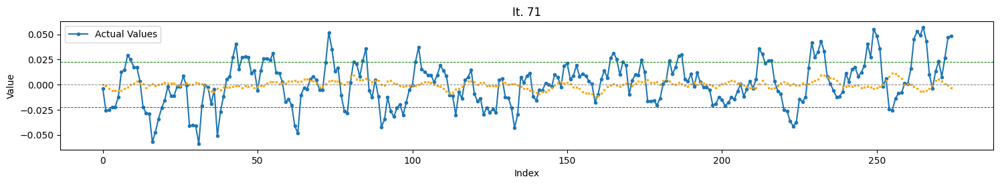

Total TH Pred.: 0
Completed Iteration 71/144

Iteration 72/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (60, 10)
Model: "sequential_71"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_142 (LSTM)             (None, 60, 25)            3600      
                                                                 
 lstm_143 (LSTM)             (None, 75)                30300     
                                                                 
 dense_71 (Dense)            (None, 1)                 76        
              

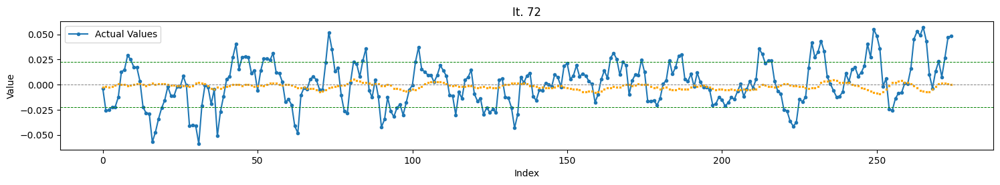

Total TH Pred.: 0
Completed Iteration 72/144

Iteration 73/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (60, 10)
Model: "sequential_72"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_144 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_145 (LSTM)             (None, 25)                10100     
                                                                 
 dense_72 (Dense)            (None, 1)                 26        
          

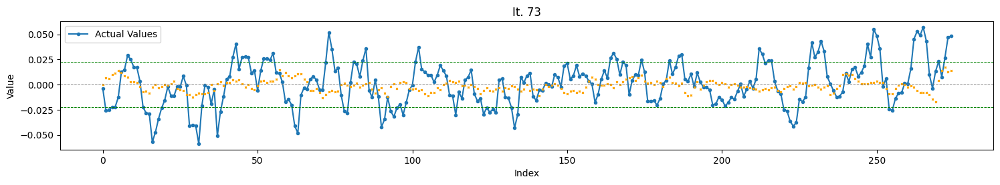

Total TH Pred.: 0
Completed Iteration 73/144

Iteration 74/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (60, 10)
Model: "sequential_73"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_146 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_147 (LSTM)             (None, 25)                10100     
                                                                 
 dense_73 (Dense)            (None, 1)                 26        
          

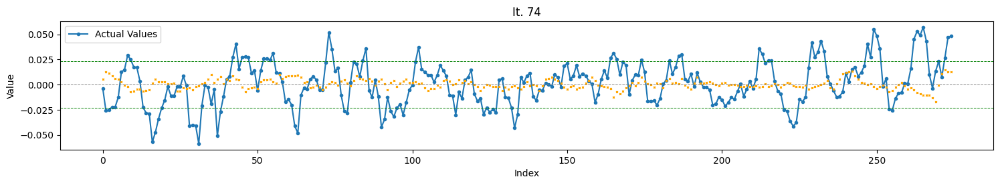

Total TH Pred.: 0
Completed Iteration 74/144

Iteration 75/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (60, 10)
Model: "sequential_74"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_148 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_149 (LSTM)             (None, 25)                10100     
                                                                 
 dense_74 (Dense)            (None, 1)                 26        
           

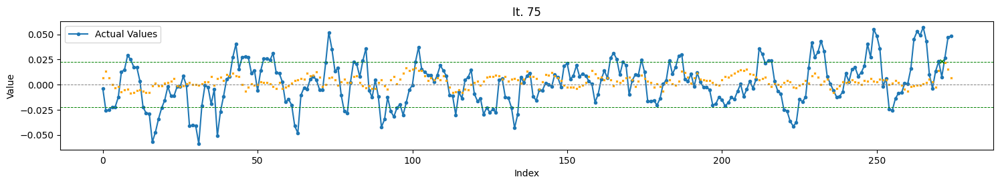

Total TH Pred.: 1
TH Pred. acc. : 100.00
Completed Iteration 75/144

Iteration 76/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (60, 10)
Model: "sequential_75"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_150 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_151 (LSTM)             (None, 25)                10100     
                                                                 
 dense_75 (Dense)            (None, 1)                 26 

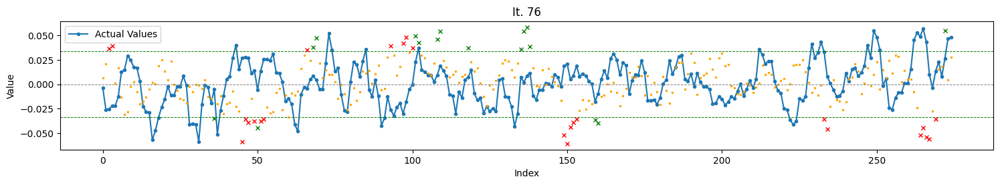

Total TH Pred.: 41
TH Pred. acc. : 39.02
Completed Iteration 76/144

Iteration 77/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (60, 10)
Model: "sequential_76"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_152 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_153 (LSTM)             (None, 25)                10100     
                                                                 
 dense_76 (Dense)            (None, 1)                 26 

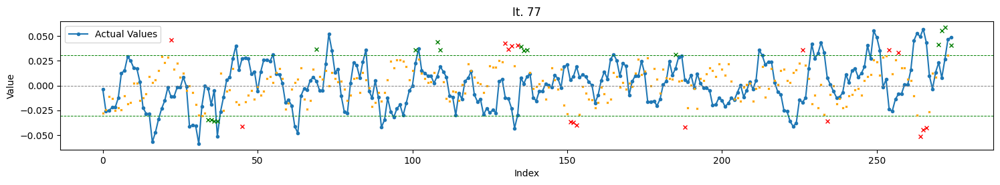

Total TH Pred.: 33
TH Pred. acc. : 48.48
Completed Iteration 77/144

Iteration 78/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (60, 10)
Model: "sequential_77"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_154 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_155 (LSTM)             (None, 25)                10100     
                                                                 
 dense_77 (Dense)            (None, 1)                 26  

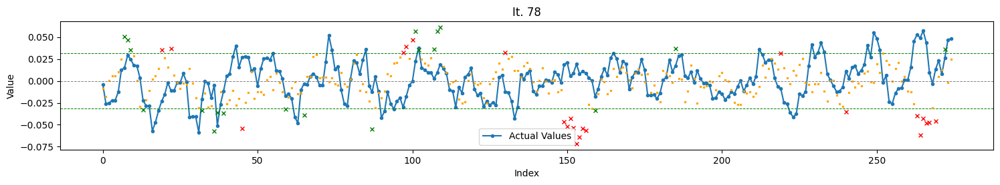

Total TH Pred.: 42
TH Pred. acc. : 45.24
Completed Iteration 78/144

Iteration 79/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (60, 10)
Model: "sequential_78"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_156 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_157 (LSTM)             (None, 25)                10100     
                                                                 
 dense_78 (Dense)            (None, 1)                 26

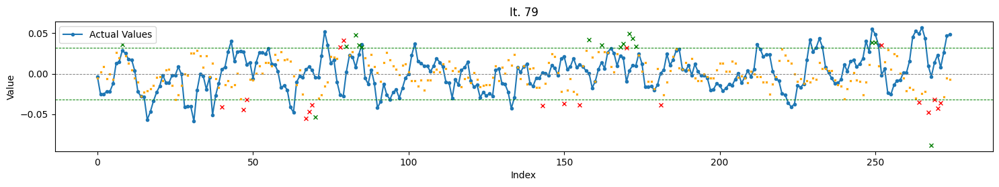

Total TH Pred.: 35
TH Pred. acc. : 45.71
Completed Iteration 79/144

Iteration 80/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (60, 10)
Model: "sequential_79"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_158 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_159 (LSTM)             (None, 25)                10100     
                                                                 
 dense_79 (Dense)            (None, 1)                 26

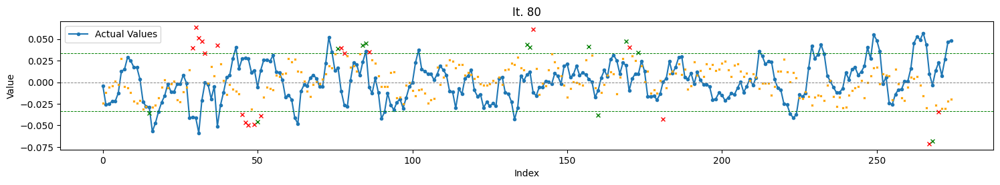

Total TH Pred.: 31
TH Pred. acc. : 38.71
Completed Iteration 80/144

Iteration 81/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (60, 10)
Model: "sequential_80"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_160 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_161 (LSTM)             (None, 25)                10100     
                                                                 
 dense_80 (Dense)            (None, 1)                 26 

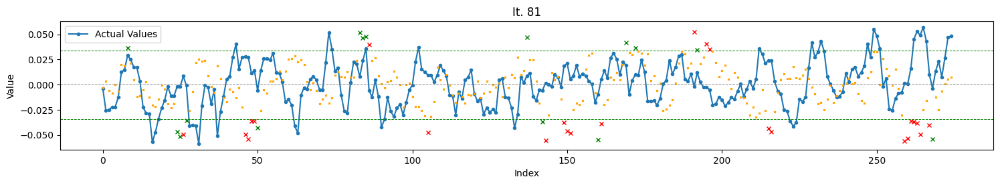

Total TH Pred.: 39
TH Pred. acc. : 38.46
Completed Iteration 81/144

Iteration 82/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (60, 10)
Model: "sequential_81"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_162 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_163 (LSTM)             (None, 25)                10100     
                                                                 
 dense_81 (Dense)            (None, 1)                 2

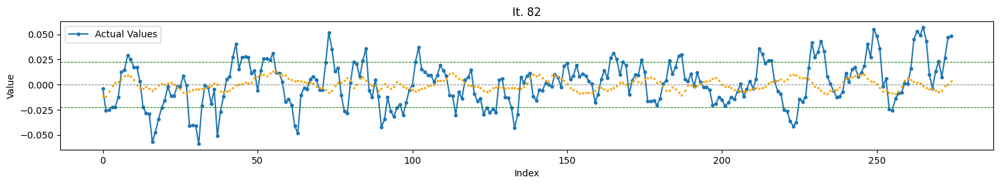

Total TH Pred.: 0
Completed Iteration 82/144

Iteration 83/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (60, 10)
Model: "sequential_82"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_164 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_165 (LSTM)             (None, 25)                10100     
                                                                 
 dense_82 (Dense)            (None, 1)                 26        
             

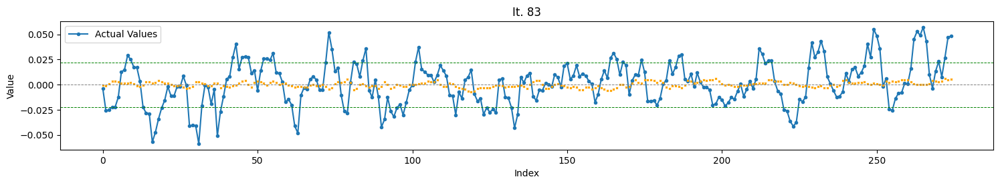

Total TH Pred.: 0
Completed Iteration 83/144

Iteration 84/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (60, 10)
Model: "sequential_83"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_166 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_167 (LSTM)             (None, 25)                10100     
                                                                 
 dense_83 (Dense)            (None, 1)                 26        
              

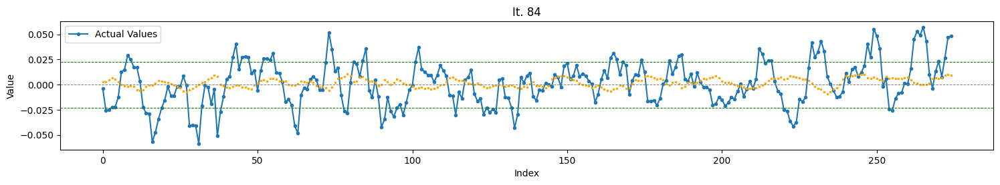

Total TH Pred.: 0
Completed Iteration 84/144

Iteration 85/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (60, 10)
Model: "sequential_84"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_168 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_169 (LSTM)             (None, 75)                45300     
                                                                 
 dense_84 (Dense)            (None, 1)                 76        
          

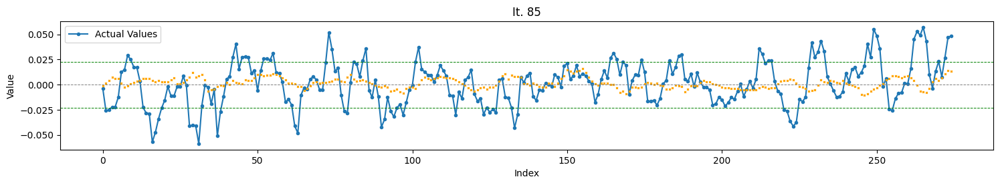

Total TH Pred.: 0
Completed Iteration 85/144

Iteration 86/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (60, 10)
Model: "sequential_85"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_170 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_171 (LSTM)             (None, 75)                45300     
                                                                 
 dense_85 (Dense)            (None, 1)                 76        
          

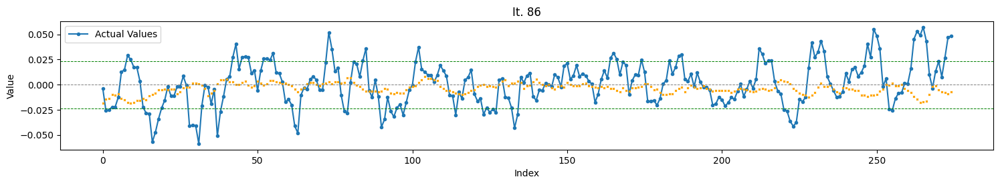

Total TH Pred.: 0
Completed Iteration 86/144

Iteration 87/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (60, 10)
Model: "sequential_86"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_172 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_173 (LSTM)             (None, 75)                45300     
                                                                 
 dense_86 (Dense)            (None, 1)                 76        
           

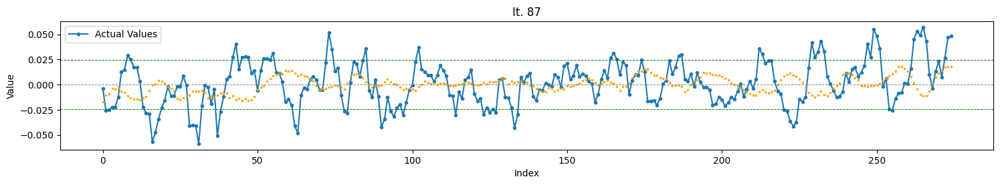

Total TH Pred.: 0
Completed Iteration 87/144

Iteration 88/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (60, 10)
Model: "sequential_87"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_174 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_175 (LSTM)             (None, 75)                45300     
                                                                 
 dense_87 (Dense)            (None, 1)                 76        
               

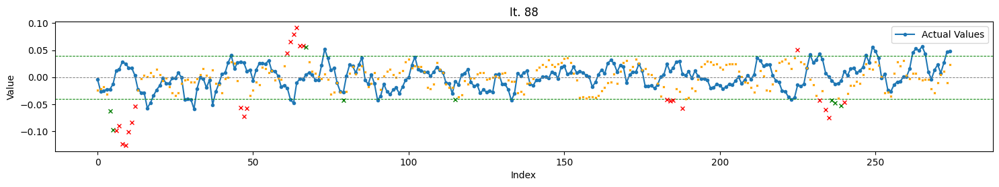

Total TH Pred.: 33
TH Pred. acc. : 24.24
Completed Iteration 88/144

Iteration 89/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (60, 10)
Model: "sequential_88"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_176 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_177 (LSTM)             (None, 75)                45300     
                                                                 
 dense_88 (Dense)            (None, 1)                 76 

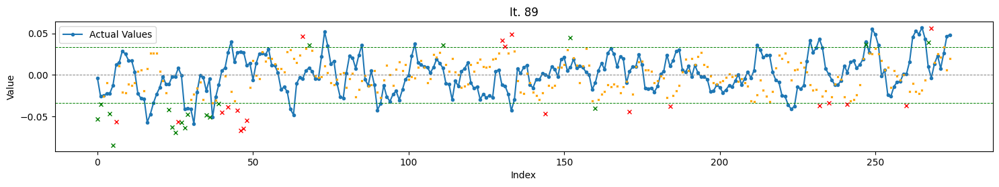

Total TH Pred.: 39
TH Pred. acc. : 48.72
Completed Iteration 89/144

Iteration 90/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (60, 10)
Model: "sequential_89"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_178 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_179 (LSTM)             (None, 75)                45300     
                                                                 
 dense_89 (Dense)            (None, 1)                 76  

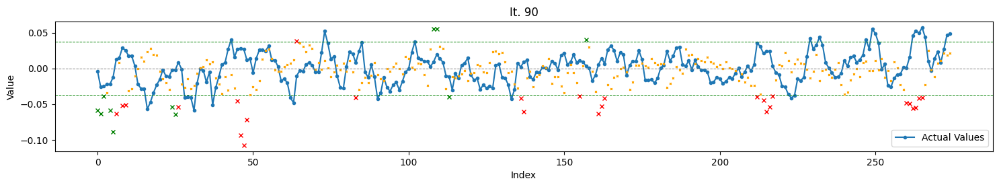

Total TH Pred.: 38
TH Pred. acc. : 28.95
Completed Iteration 90/144

Iteration 91/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (60, 10)
Model: "sequential_90"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_180 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_181 (LSTM)             (None, 75)                45300     
                                                                 
 dense_90 (Dense)            (None, 1)                 76

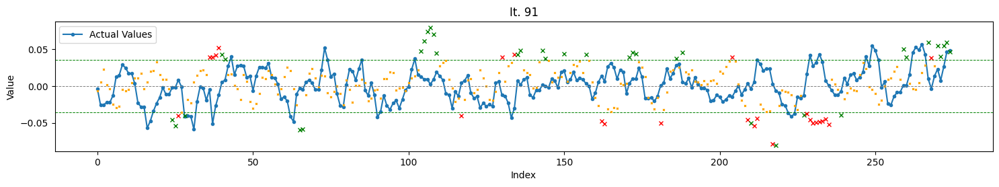

Total TH Pred.: 61
TH Pred. acc. : 59.02
Completed Iteration 91/144

Iteration 92/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (60, 10)
Model: "sequential_91"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_182 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_183 (LSTM)             (None, 75)                45300     
                                                                 
 dense_91 (Dense)            (None, 1)                 76

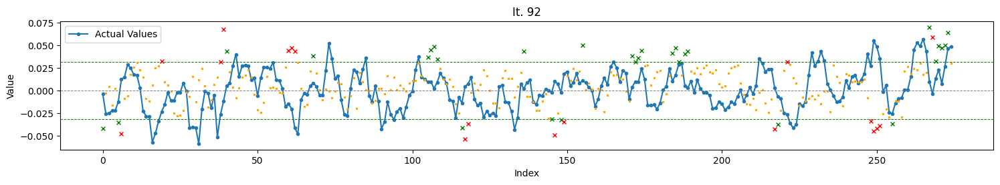

Total TH Pred.: 48
TH Pred. acc. : 62.50
Completed Iteration 92/144

Iteration 93/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (60, 10)
Model: "sequential_92"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_184 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_185 (LSTM)             (None, 75)                45300     
                                                                 
 dense_92 (Dense)            (None, 1)                 76 

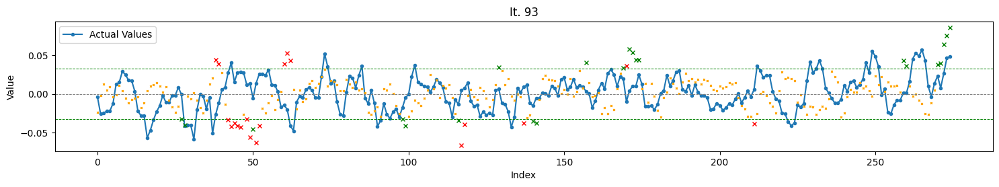

Total TH Pred.: 41
TH Pred. acc. : 53.66
Completed Iteration 93/144

Iteration 94/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (60, 10)
Model: "sequential_93"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_186 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_187 (LSTM)             (None, 75)                45300     
                                                                 
 dense_93 (Dense)            (None, 1)                 7

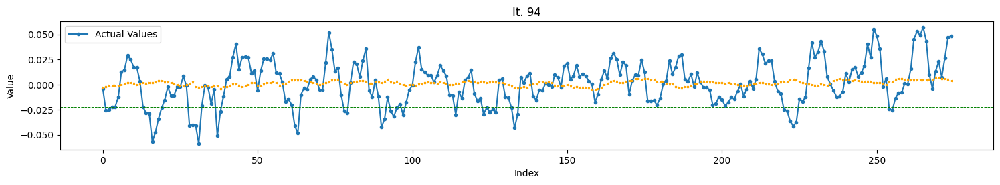

Total TH Pred.: 0
Completed Iteration 94/144

Iteration 95/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (60, 10)
Model: "sequential_94"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_188 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_189 (LSTM)             (None, 75)                45300     
                                                                 
 dense_94 (Dense)            (None, 1)                 76        
             

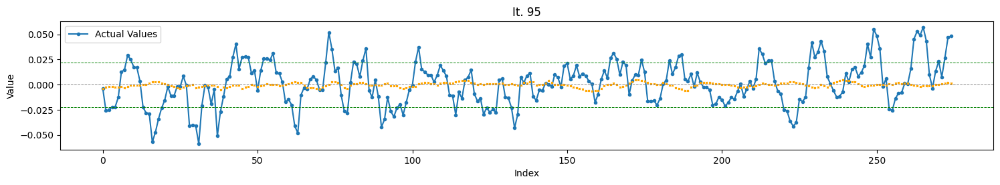

Total TH Pred.: 0
Completed Iteration 95/144

Iteration 96/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 60
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (60, 10)
Model: "sequential_95"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_190 (LSTM)             (None, 60, 75)            25800     
                                                                 
 lstm_191 (LSTM)             (None, 75)                45300     
                                                                 
 dense_95 (Dense)            (None, 1)                 76        
              

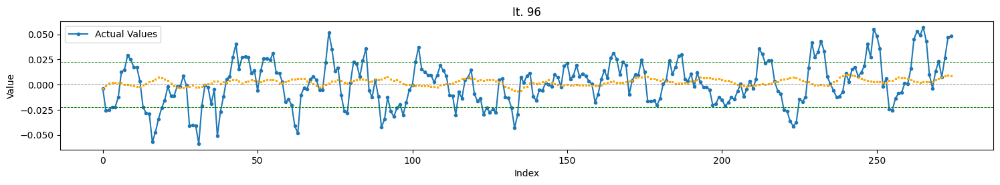

Total TH Pred.: 0
Completed Iteration 96/144

Iteration 97/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (120, 10)
Model: "sequential_96"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_192 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_193 (LSTM)             (None, 25)                5100      
                                                                 
 dense_96 (Dense)            (None, 1)                 26        
        

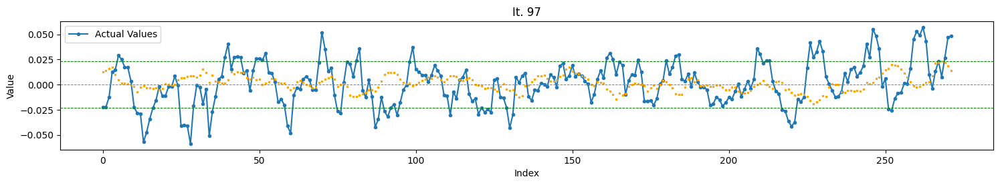

Total TH Pred.: 0
Completed Iteration 97/144

Iteration 98/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (120, 10)
Model: "sequential_97"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_194 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_195 (LSTM)             (None, 25)                5100      
                                                                 
 dense_97 (Dense)            (None, 1)                 26        
        

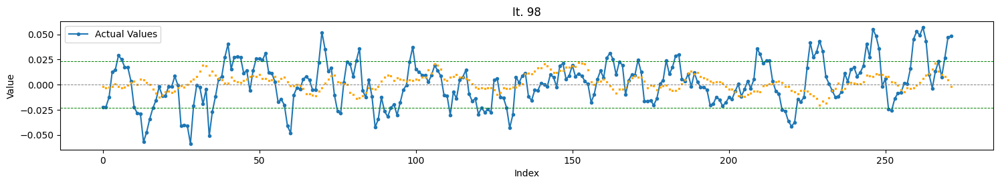

Total TH Pred.: 0
Completed Iteration 98/144

Iteration 99/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (120, 10)
Model: "sequential_98"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_196 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_197 (LSTM)             (None, 25)                5100      
                                                                 
 dense_98 (Dense)            (None, 1)                 26        
         

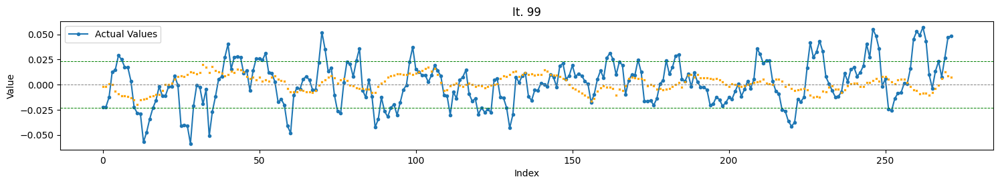

Total TH Pred.: 0
Completed Iteration 99/144

Iteration 100/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (120, 10)
Model: "sequential_99"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_198 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_199 (LSTM)             (None, 25)                5100      
                                                                 
 dense_99 (Dense)            (None, 1)                 26        
            

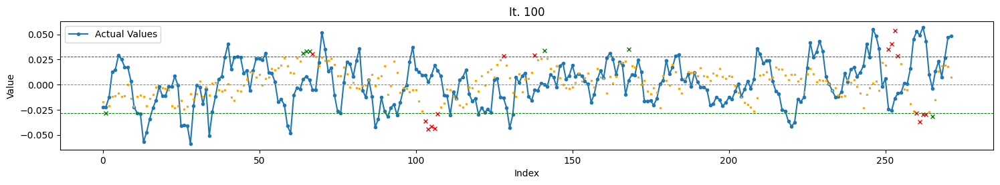

Total TH Pred.: 23
TH Pred. acc. : 30.43
Completed Iteration 100/144

Iteration 101/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (120, 10)
Model: "sequential_100"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_200 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_201 (LSTM)             (None, 25)                5100      
                                                                 
 dense_100 (Dense)           (None, 1)               

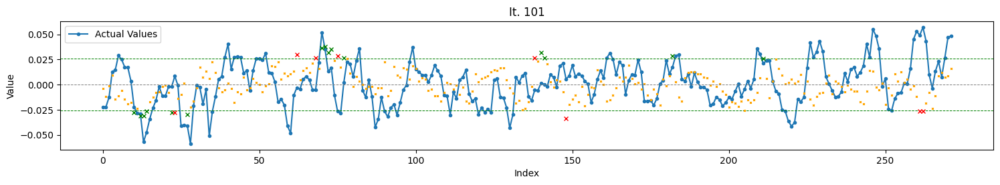

Total TH Pred.: 23
TH Pred. acc. : 65.22
Completed Iteration 101/144

Iteration 102/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (120, 10)
Model: "sequential_101"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_202 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_203 (LSTM)             (None, 25)                5100      
                                                                 
 dense_101 (Dense)           (None, 1)                

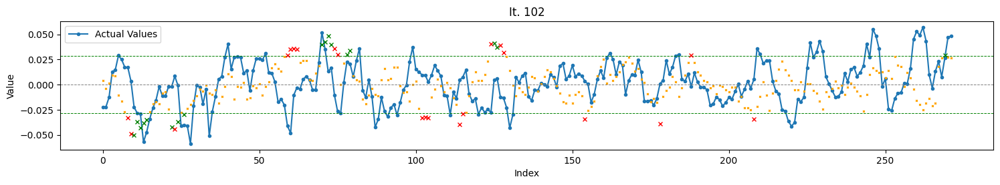

Total TH Pred.: 38
TH Pred. acc. : 44.74
Completed Iteration 102/144

Iteration 103/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (120, 10)
Model: "sequential_102"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_204 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_205 (LSTM)             (None, 25)                5100      
                                                                 
 dense_102 (Dense)           (None, 1)              

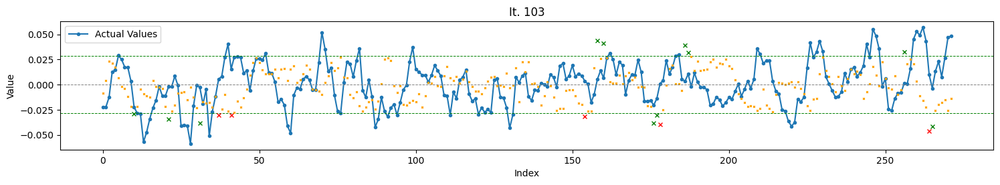

Total TH Pred.: 16
TH Pred. acc. : 68.75
Completed Iteration 103/144

Iteration 104/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (120, 10)
Model: "sequential_103"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_206 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_207 (LSTM)             (None, 25)                5100      
                                                                 
 dense_103 (Dense)           (None, 1)              

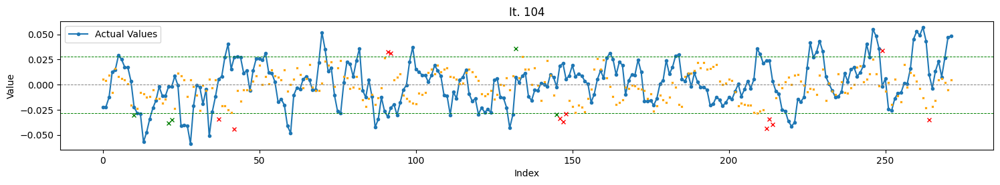

Total TH Pred.: 17
TH Pred. acc. : 29.41
Completed Iteration 104/144

Iteration 105/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (120, 10)
Model: "sequential_104"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_208 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_209 (LSTM)             (None, 25)                5100      
                                                                 
 dense_104 (Dense)           (None, 1)               

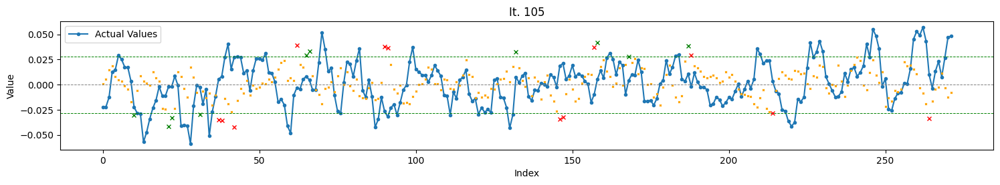

Total TH Pred.: 22
TH Pred. acc. : 45.45
Completed Iteration 105/144

Iteration 106/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (120, 10)
Model: "sequential_105"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_210 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_211 (LSTM)             (None, 25)                5100      
                                                                 
 dense_105 (Dense)           (None, 1)             

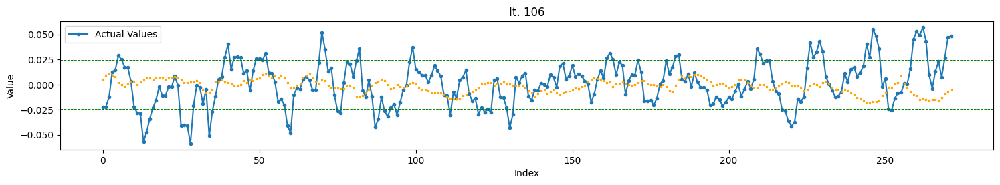

Total TH Pred.: 0
Completed Iteration 106/144

Iteration 107/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (120, 10)
Model: "sequential_106"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_212 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_213 (LSTM)             (None, 25)                5100      
                                                                 
 dense_106 (Dense)           (None, 1)                 26        
        

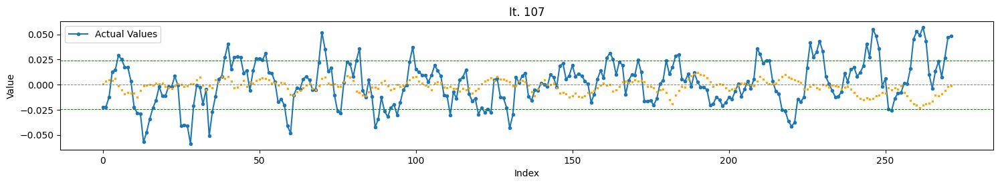

Total TH Pred.: 0
Completed Iteration 107/144

Iteration 108/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (120, 10)
Model: "sequential_107"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_214 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_215 (LSTM)             (None, 25)                5100      
                                                                 
 dense_107 (Dense)           (None, 1)                 26        
         

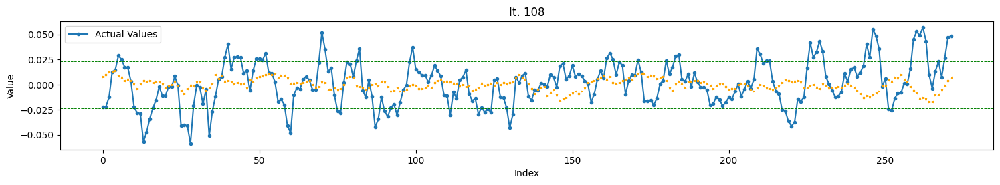

Total TH Pred.: 0
Completed Iteration 108/144

Iteration 109/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (120, 10)
Model: "sequential_108"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_216 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_217 (LSTM)             (None, 75)                30300     
                                                                 
 dense_108 (Dense)           (None, 1)                 76        
     

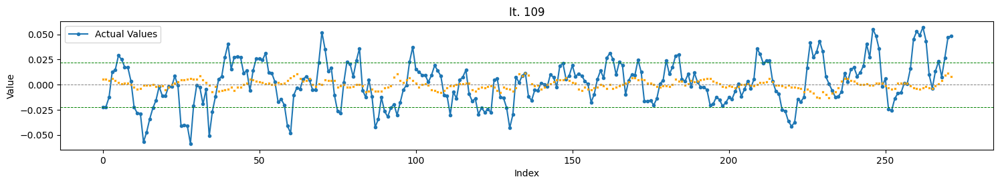

Total TH Pred.: 0
Completed Iteration 109/144

Iteration 110/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (120, 10)
Model: "sequential_109"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_218 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_219 (LSTM)             (None, 75)                30300     
                                                                 
 dense_109 (Dense)           (None, 1)                 76        
     

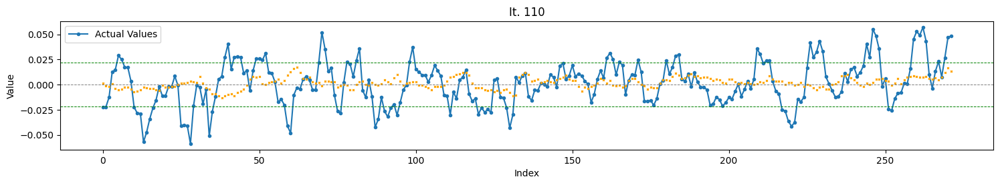

Total TH Pred.: 0
Completed Iteration 110/144

Iteration 111/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (120, 10)
Model: "sequential_110"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_220 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_221 (LSTM)             (None, 75)                30300     
                                                                 
 dense_110 (Dense)           (None, 1)                 76        
      

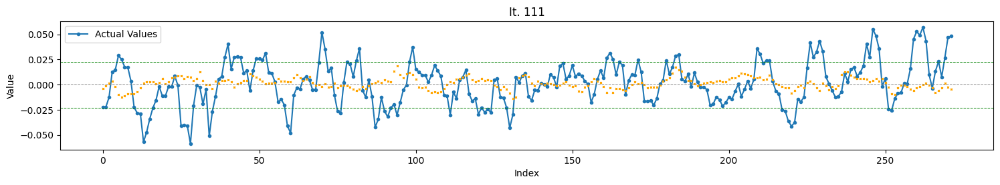

Total TH Pred.: 0
Completed Iteration 111/144

Iteration 112/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (120, 10)
Model: "sequential_111"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_222 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_223 (LSTM)             (None, 75)                30300     
                                                                 
 dense_111 (Dense)           (None, 1)                 76        
          

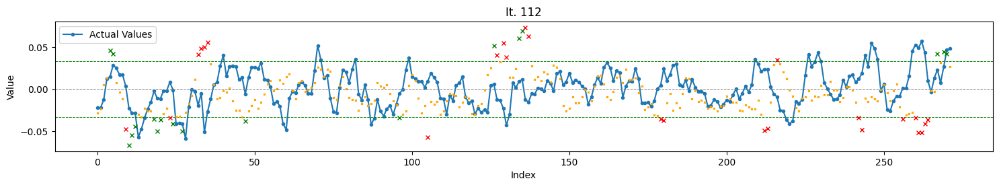

Total TH Pred.: 43
TH Pred. acc. : 41.86
Completed Iteration 112/144

Iteration 113/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (120, 10)
Model: "sequential_112"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_224 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_225 (LSTM)             (None, 75)                30300     
                                                                 
 dense_112 (Dense)           (None, 1)               

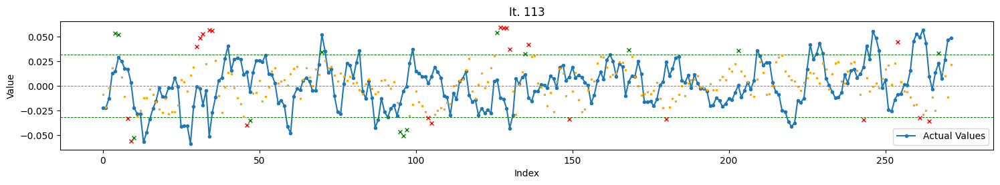

Total TH Pred.: 34
TH Pred. acc. : 38.24
Completed Iteration 113/144

Iteration 114/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (120, 10)
Model: "sequential_113"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_226 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_227 (LSTM)             (None, 75)                30300     
                                                                 
 dense_113 (Dense)           (None, 1)                

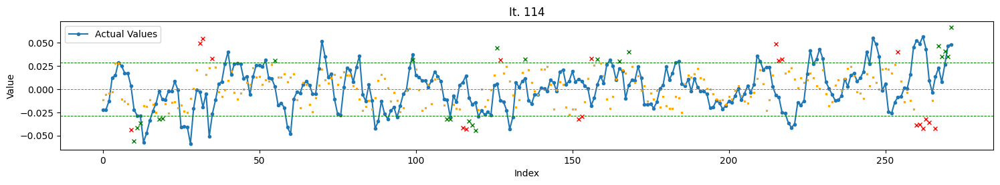

Total TH Pred.: 42
TH Pred. acc. : 52.38
Completed Iteration 114/144

Iteration 115/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (120, 10)
Model: "sequential_114"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_228 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_229 (LSTM)             (None, 75)                30300     
                                                                 
 dense_114 (Dense)           (None, 1)              

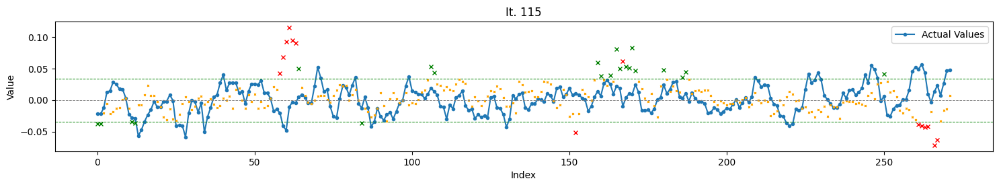

Total TH Pred.: 35
TH Pred. acc. : 60.00
Completed Iteration 115/144

Iteration 116/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (120, 10)
Model: "sequential_115"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_230 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_231 (LSTM)             (None, 75)                30300     
                                                                 
 dense_115 (Dense)           (None, 1)              

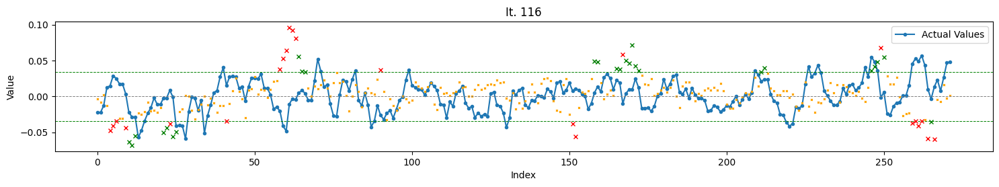

Total TH Pred.: 49
TH Pred. acc. : 53.06
Completed Iteration 116/144

Iteration 117/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (120, 10)
Model: "sequential_116"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_232 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_233 (LSTM)             (None, 75)                30300     
                                                                 
 dense_116 (Dense)           (None, 1)               

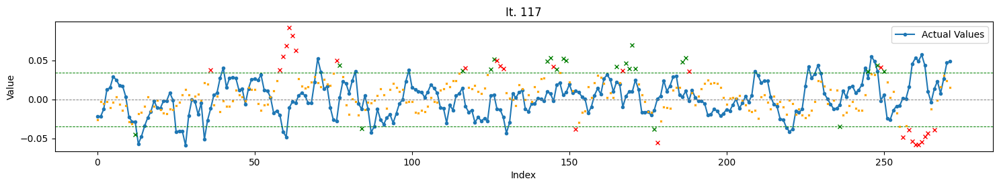

Total TH Pred.: 50
TH Pred. acc. : 46.00
Completed Iteration 117/144

Iteration 118/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (120, 10)
Model: "sequential_117"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_234 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_235 (LSTM)             (None, 75)                30300     
                                                                 
 dense_117 (Dense)           (None, 1)             

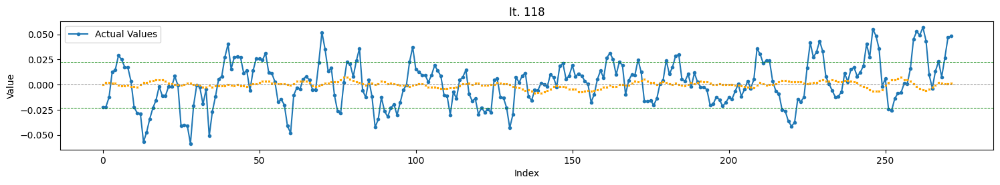

Total TH Pred.: 0
Completed Iteration 118/144

Iteration 119/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (120, 10)
Model: "sequential_118"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_236 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_237 (LSTM)             (None, 75)                30300     
                                                                 
 dense_118 (Dense)           (None, 1)                 76        
        

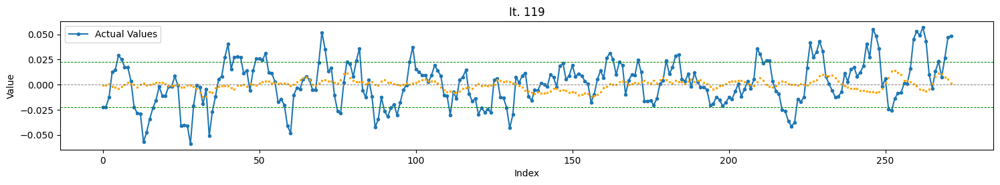

Total TH Pred.: 0
Completed Iteration 119/144

Iteration 120/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (120, 10)
Model: "sequential_119"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_238 (LSTM)             (None, 120, 25)           3600      
                                                                 
 lstm_239 (LSTM)             (None, 75)                30300     
                                                                 
 dense_119 (Dense)           (None, 1)                 76        
         

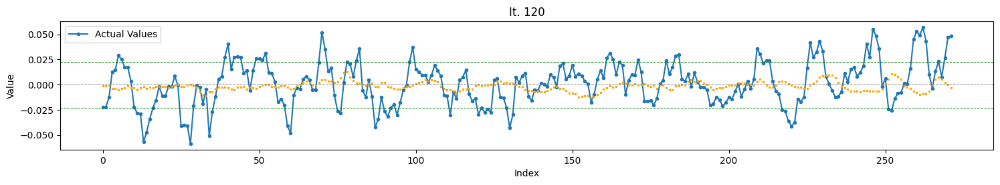

Total TH Pred.: 0
Completed Iteration 120/144

Iteration 121/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (120, 10)
Model: "sequential_120"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_240 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_241 (LSTM)             (None, 25)                10100     
                                                                 
 dense_120 (Dense)           (None, 1)                 26        
     

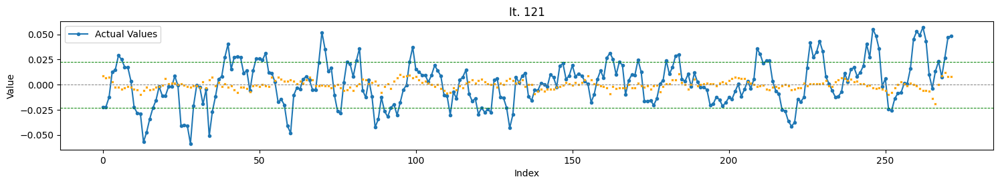

Total TH Pred.: 0
Completed Iteration 121/144

Iteration 122/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (120, 10)
Model: "sequential_121"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_242 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_243 (LSTM)             (None, 25)                10100     
                                                                 
 dense_121 (Dense)           (None, 1)                 26        
     

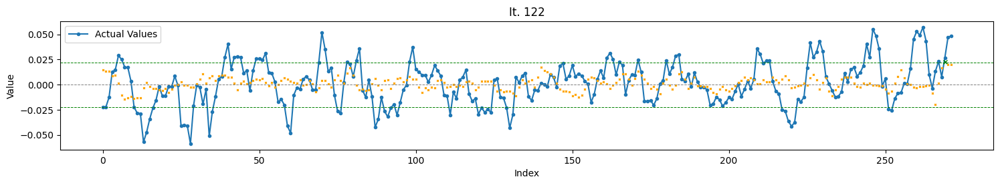

Total TH Pred.: 1
TH Pred. acc. : 100.00
Completed Iteration 122/144

Iteration 123/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (120, 10)
Model: "sequential_122"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_244 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_245 (LSTM)             (None, 25)                10100     
                                                                 
 dense_122 (Dense)           (None, 1)           

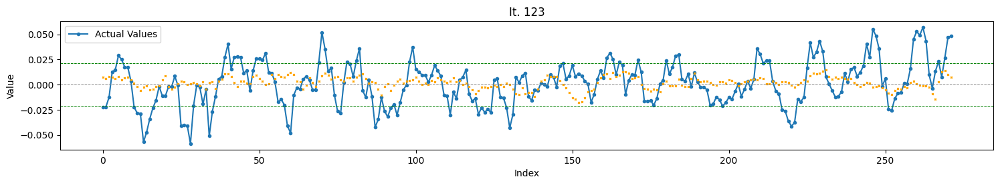

Total TH Pred.: 0
Completed Iteration 123/144

Iteration 124/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (120, 10)
Model: "sequential_123"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_246 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_247 (LSTM)             (None, 25)                10100     
                                                                 
 dense_123 (Dense)           (None, 1)                 26        
          

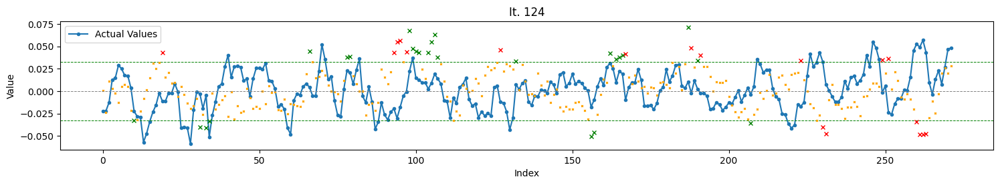

Total TH Pred.: 43
TH Pred. acc. : 58.14
Completed Iteration 124/144

Iteration 125/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (120, 10)
Model: "sequential_124"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_248 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_249 (LSTM)             (None, 25)                10100     
                                                                 
 dense_124 (Dense)           (None, 1)               

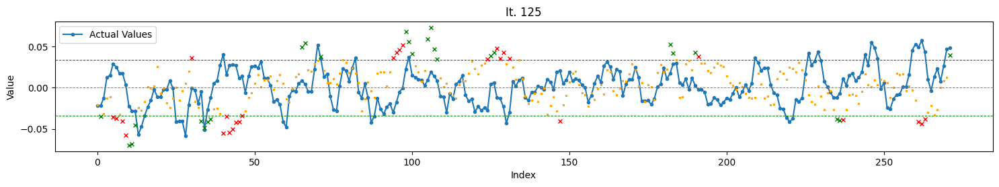

Total TH Pred.: 53
TH Pred. acc. : 49.06
Completed Iteration 125/144

Iteration 126/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (120, 10)
Model: "sequential_125"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_250 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_251 (LSTM)             (None, 25)                10100     
                                                                 
 dense_125 (Dense)           (None, 1)                

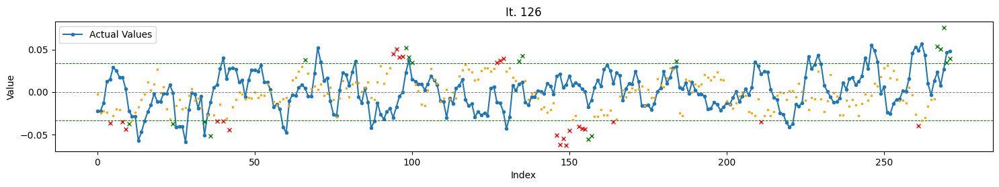

Total TH Pred.: 42
TH Pred. acc. : 42.86
Completed Iteration 126/144

Iteration 127/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (120, 10)
Model: "sequential_126"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_252 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_253 (LSTM)             (None, 25)                10100     
                                                                 
 dense_126 (Dense)           (None, 1)              

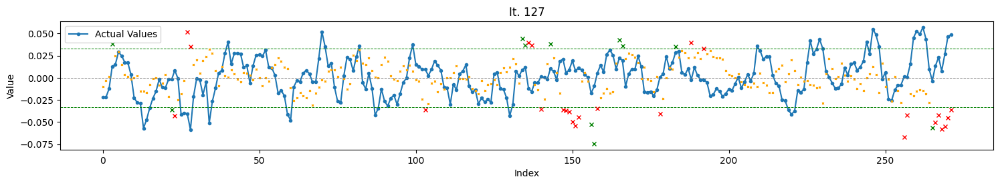

Total TH Pred.: 36
TH Pred. acc. : 30.56
Completed Iteration 127/144

Iteration 128/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (120, 10)
Model: "sequential_127"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_254 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_255 (LSTM)             (None, 25)                10100     
                                                                 
 dense_127 (Dense)           (None, 1)              

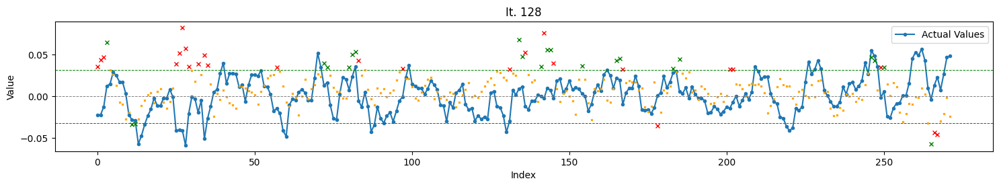

Total TH Pred.: 47
TH Pred. acc. : 46.81
Completed Iteration 128/144

Iteration 129/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (120, 10)
Model: "sequential_128"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_256 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_257 (LSTM)             (None, 25)                10100     
                                                                 
 dense_128 (Dense)           (None, 1)               

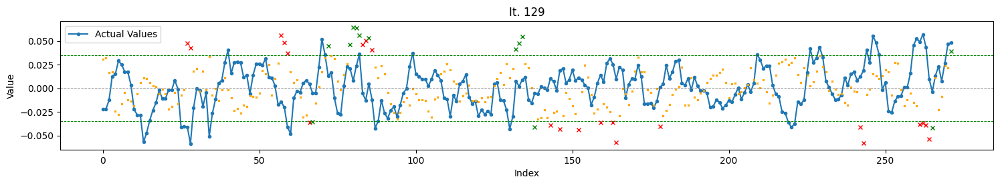

Total TH Pred.: 35
TH Pred. acc. : 37.14
Completed Iteration 129/144

Iteration 130/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (120, 10)
Model: "sequential_129"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_258 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_259 (LSTM)             (None, 25)                10100     
                                                                 
 dense_129 (Dense)           (None, 1)             

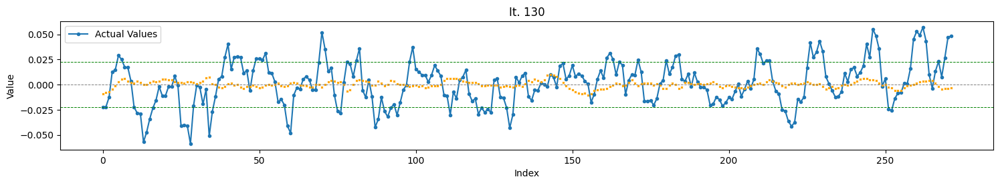

Total TH Pred.: 0
Completed Iteration 130/144

Iteration 131/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (120, 10)
Model: "sequential_130"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_260 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_261 (LSTM)             (None, 25)                10100     
                                                                 
 dense_130 (Dense)           (None, 1)                 26        
        

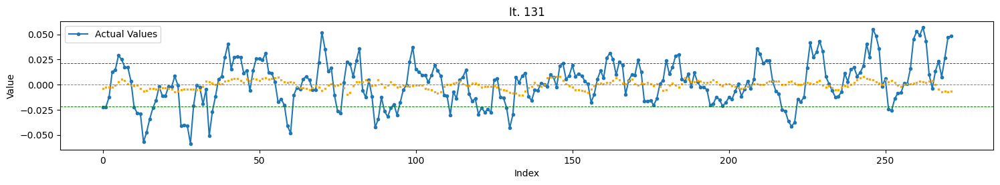

Total TH Pred.: 0
Completed Iteration 131/144

Iteration 132/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (120, 10)
Model: "sequential_131"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_262 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_263 (LSTM)             (None, 25)                10100     
                                                                 
 dense_131 (Dense)           (None, 1)                 26        
         

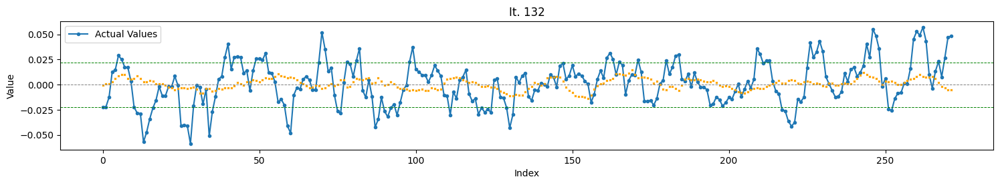

Total TH Pred.: 0
Completed Iteration 132/144

Iteration 133/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (120, 10)
Model: "sequential_132"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_264 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_265 (LSTM)             (None, 75)                45300     
                                                                 
 dense_132 (Dense)           (None, 1)                 76        
     

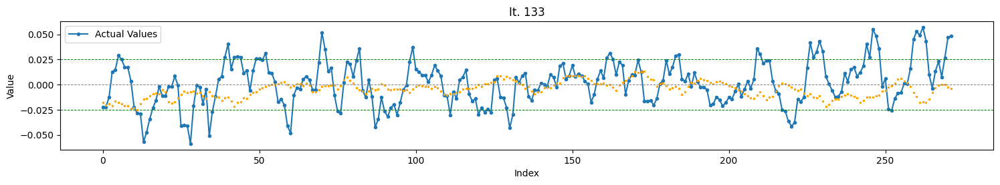

Total TH Pred.: 0
Completed Iteration 133/144

Iteration 134/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (120, 10)
Model: "sequential_133"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_266 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_267 (LSTM)             (None, 75)                45300     
                                                                 
 dense_133 (Dense)           (None, 1)                 76        
     

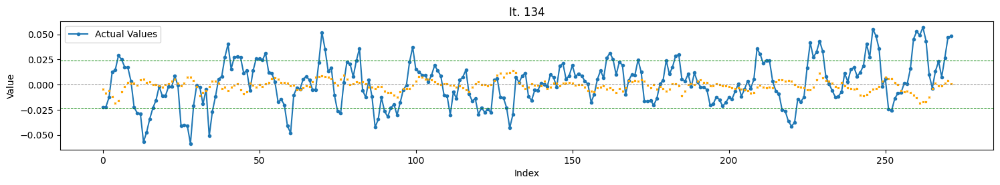

Total TH Pred.: 0
Completed Iteration 134/144

Iteration 135/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Input shape: (120, 10)
Model: "sequential_134"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_268 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_269 (LSTM)             (None, 75)                45300     
                                                                 
 dense_134 (Dense)           (None, 1)                 76        
      

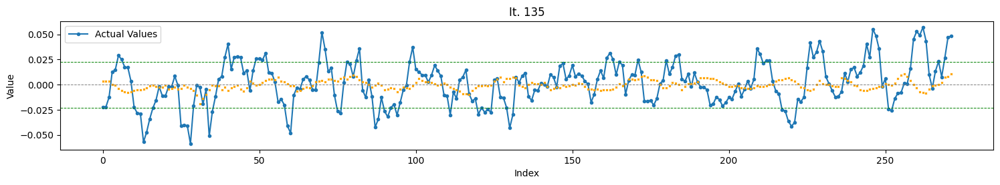

Total TH Pred.: 0
Completed Iteration 135/144

Iteration 136/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (120, 10)
Model: "sequential_135"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_270 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_271 (LSTM)             (None, 75)                45300     
                                                                 
 dense_135 (Dense)           (None, 1)                 76        
          

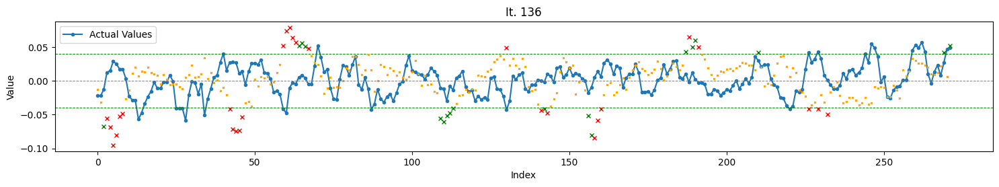

Total TH Pred.: 46
TH Pred. acc. : 39.13
Completed Iteration 136/144

Iteration 137/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (120, 10)
Model: "sequential_136"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_272 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_273 (LSTM)             (None, 75)                45300     
                                                                 
 dense_136 (Dense)           (None, 1)               

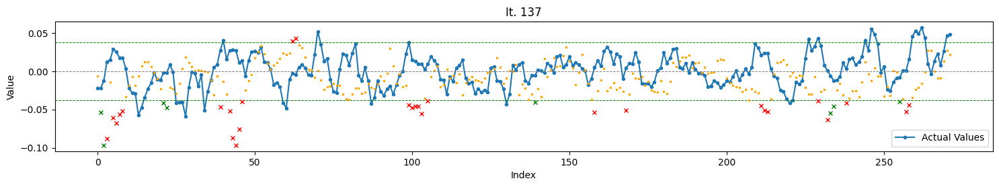

Total TH Pred.: 37
TH Pred. acc. : 21.62
Completed Iteration 137/144

Iteration 138/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Input shape: (120, 10)
Model: "sequential_137"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_274 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_275 (LSTM)             (None, 75)                45300     
                                                                 
 dense_137 (Dense)           (None, 1)                

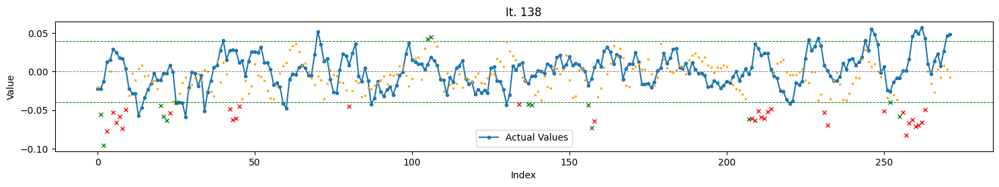

Total TH Pred.: 47
TH Pred. acc. : 31.91
Completed Iteration 138/144

Iteration 139/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (120, 10)
Model: "sequential_138"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_276 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_277 (LSTM)             (None, 75)                45300     
                                                                 
 dense_138 (Dense)           (None, 1)              

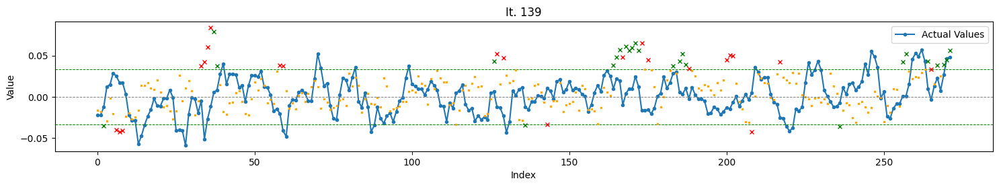

Total TH Pred.: 47
TH Pred. acc. : 53.19
Completed Iteration 139/144

Iteration 140/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (120, 10)
Model: "sequential_139"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_278 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_279 (LSTM)             (None, 75)                45300     
                                                                 
 dense_139 (Dense)           (None, 1)              

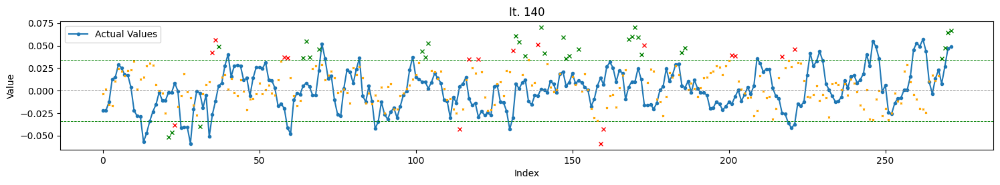

Total TH Pred.: 48
TH Pred. acc. : 64.58
Completed Iteration 140/144

Iteration 141/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeUniform object at 0x7494ee759e40>}
Input shape: (120, 10)
Model: "sequential_140"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_280 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_281 (LSTM)             (None, 75)                45300     
                                                                 
 dense_140 (Dense)           (None, 1)               

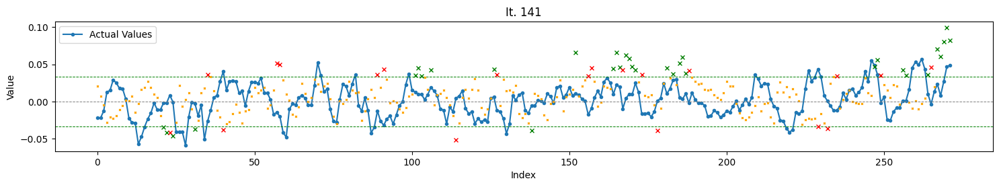

Total TH Pred.: 53
TH Pred. acc. : 62.26
Completed Iteration 141/144

Iteration 142/144
Train : batch    > 256
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (120, 10)
Model: "sequential_141"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_282 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_283 (LSTM)             (None, 75)                45300     
                                                                 
 dense_141 (Dense)           (None, 1)             

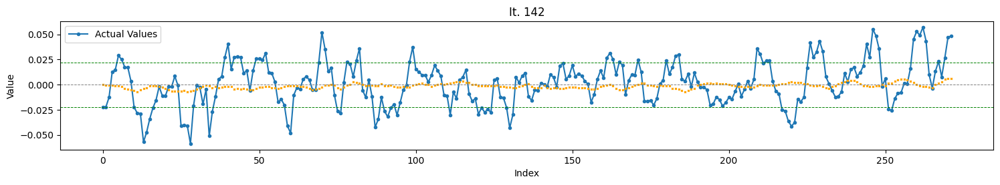

Total TH Pred.: 0
Completed Iteration 142/144

Iteration 143/144
Train : batch    > 128
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (120, 10)
Model: "sequential_142"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_284 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_285 (LSTM)             (None, 75)                45300     
                                                                 
 dense_142 (Dense)           (None, 1)                 76        
        

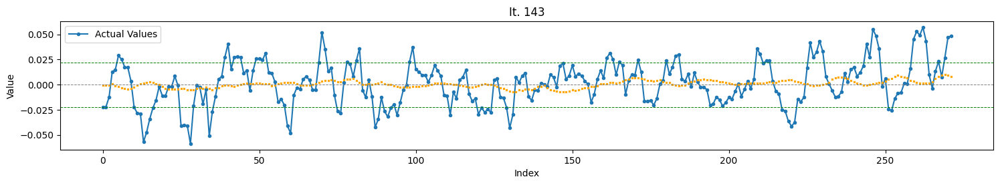

Total TH Pred.: 0
Completed Iteration 143/144

Iteration 144/144
Train : batch    > 64
        epochs   > 300
        n_steps  > 120
Features utilizados: Index(['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D',
       'ACU_3D', 'ACU_2D'],
      dtype='object')
Model params: 
{'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Input shape: (120, 10)
Model: "sequential_143"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_286 (LSTM)             (None, 120, 75)           25800     
                                                                 
 lstm_287 (LSTM)             (None, 75)                45300     
                                                                 
 dense_143 (Dense)           (None, 1)                 76        
         

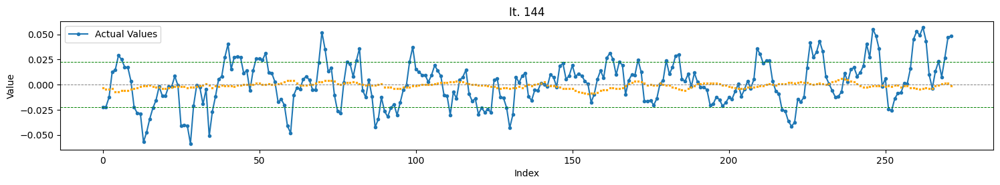

Total TH Pred.: 0
Completed Iteration 144/144


In [15]:
top_results = run_model_iterations()

In [19]:
top_results_sort = sorted(top_results, key=lambda x: x['diff'])[:15]

Top 1 - 0.5
RMSE: 0.021396, STD_DEV: 0.021968, STD_PRD: 0.007593, OBJDIFF: 0.003022, RDIFF: -0.000572
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023853, inv. diff> 0.009073
Trend accuracy       : 59.273
Trend up accuracy    : 76.712
Trend down accuracy  : 39.535


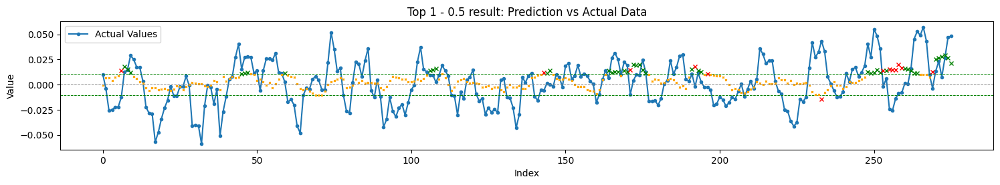

Total TH Pred.: 56
TH Pred. acc. : 76.79


Top 2 - 0.5
RMSE: 0.021314, STD_DEV: 0.022002, STD_PRD: 0.006986, OBJDIFF: 0.003066, RDIFF: -0.000688
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023377, inv. diff> 0.008883
Trend accuracy       : 53.650
Trend up accuracy    : 69.655
Trend down accuracy  : 35.659


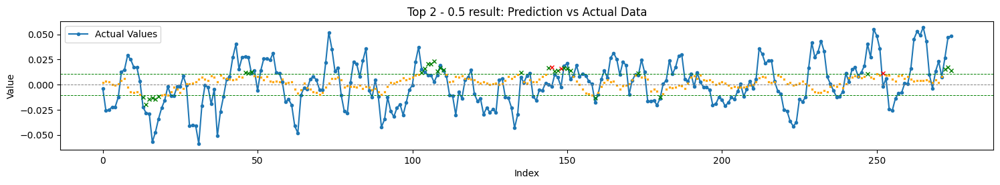

Total TH Pred.: 34
TH Pred. acc. : 91.18


Top 3 - 0.5
RMSE: 0.021549, STD_DEV: 0.022002, STD_PRD: 0.007305, OBJDIFF: 0.003222, RDIFF: -0.000452
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023508, inv. diff> 0.008855
Trend accuracy       : 59.124
Trend up accuracy    : 69.655
Trend down accuracy  : 47.287


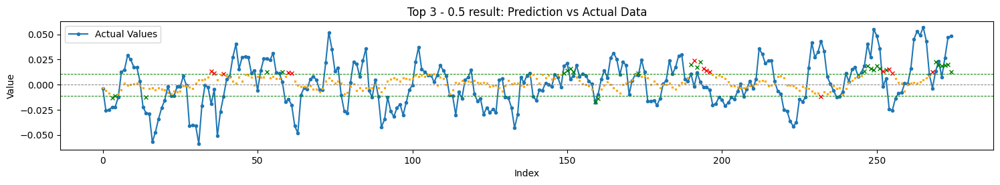

Total TH Pred.: 42
TH Pred. acc. : 66.67


Top 4 - 0.5
RMSE: 0.021346, STD_DEV: 0.022002, STD_PRD: 0.005851, OBJDIFF: 0.003382, RDIFF: -0.000656
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023008, inv. diff> 0.009081
Trend accuracy       : 57.934
Trend up accuracy    : 73.103
Trend down accuracy  : 40.476


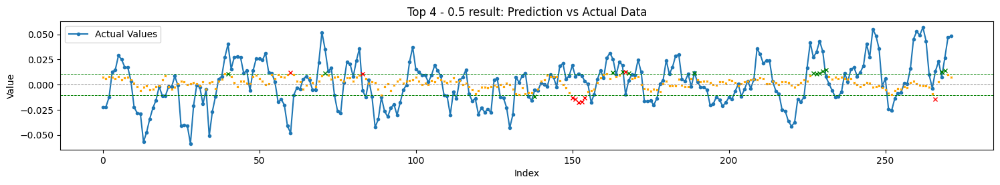

Total TH Pred.: 23
TH Pred. acc. : 60.87


Top 5 - 0.5
RMSE: 0.021730, STD_DEV: 0.021968, STD_PRD: 0.007309, OBJDIFF: 0.003427, RDIFF: -0.000238
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023367, inv. diff> 0.008729
Trend accuracy       : 58.909
Trend up accuracy    : 70.548
Trend down accuracy  : 45.736


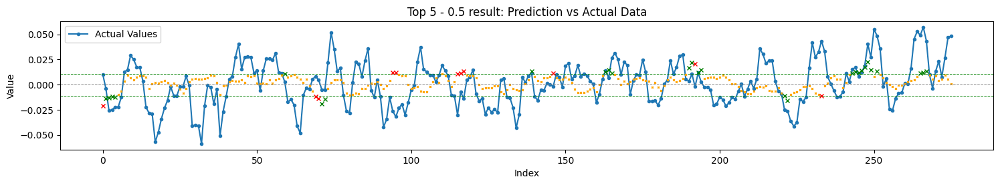

Total TH Pred.: 39
TH Pred. acc. : 71.79


Top 6 - 0.5
RMSE: 0.021968, STD_DEV: 0.021968, STD_PRD: 0.006441, OBJDIFF: 0.003881, RDIFF: -0.000001
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023266, inv. diff> 0.009062
Trend accuracy       : 56.364
Trend up accuracy    : 71.918
Trend down accuracy  : 38.760


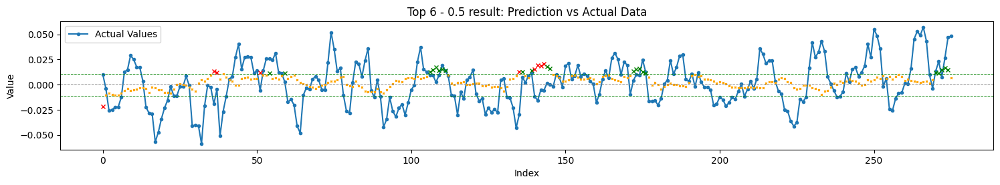

Total TH Pred.: 31
TH Pred. acc. : 70.97


Top 7 - 0.5
RMSE: 0.021253, STD_DEV: 0.021968, STD_PRD: 0.003182, OBJDIFF: 0.003981, RDIFF: -0.000715
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022365, inv. diff> 0.009790
Trend accuracy       : 53.455
Trend up accuracy    : 70.548
Trend down accuracy  : 34.109


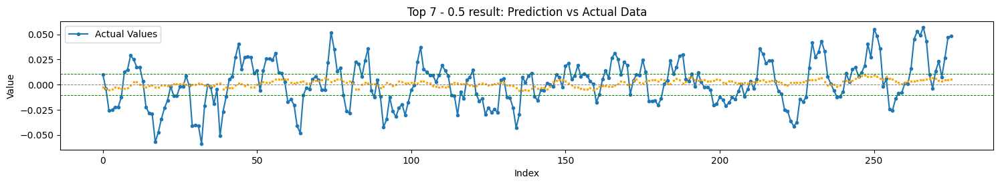

Total TH Pred.: 0


Top 8 - 0.5
RMSE: 0.021928, STD_DEV: 0.022002, STD_PRD: 0.005410, OBJDIFF: 0.004074, RDIFF: -0.000074
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022877, inv. diff> 0.009171
Trend accuracy       : 52.030
Trend up accuracy    : 64.828
Trend down accuracy  : 37.302


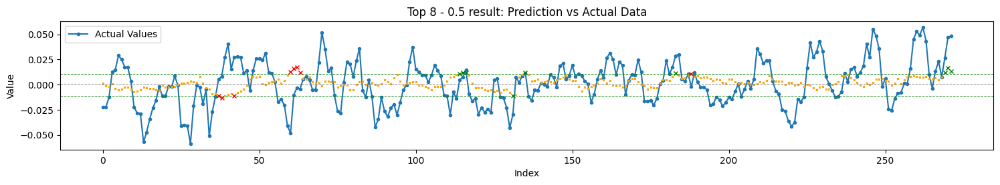

Total TH Pred.: 17
TH Pred. acc. : 52.94


Top 9 - 0.5
RMSE: 0.021642, STD_DEV: 0.022002, STD_PRD: 0.003914, OBJDIFF: 0.004162, RDIFF: -0.000359
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022384, inv. diff> 0.009426
Trend accuracy       : 57.934
Trend up accuracy    : 57.931
Trend down accuracy  : 57.937


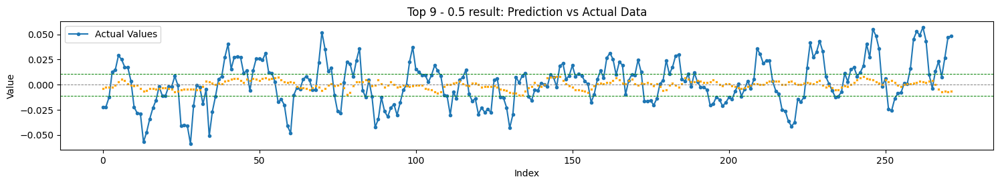

Total TH Pred.: 0


Top 10 - 0.5
RMSE: 0.021897, STD_DEV: 0.021968, STD_PRD: 0.003949, OBJDIFF: 0.004433, RDIFF: -0.000072
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022321, inv. diff> 0.009362
Trend accuracy       : 52.364
Trend up accuracy    : 39.041
Trend down accuracy  : 67.442


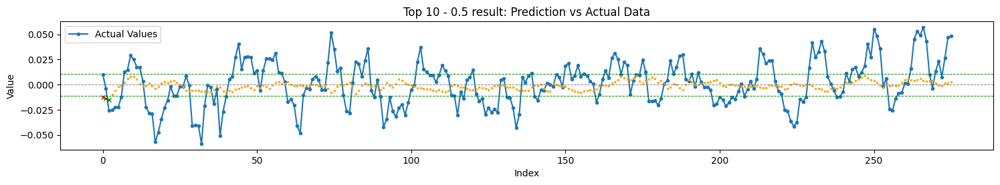

Total TH Pred.: 3
TH Pred. acc. : 66.67


Top 11 - 0.5
RMSE: 0.021910, STD_DEV: 0.021968, STD_PRD: 0.003931, OBJDIFF: 0.004451, RDIFF: -0.000059
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022419, inv. diff> 0.009469
Trend accuracy       : 49.455
Trend up accuracy    : 63.014
Trend down accuracy  : 34.109


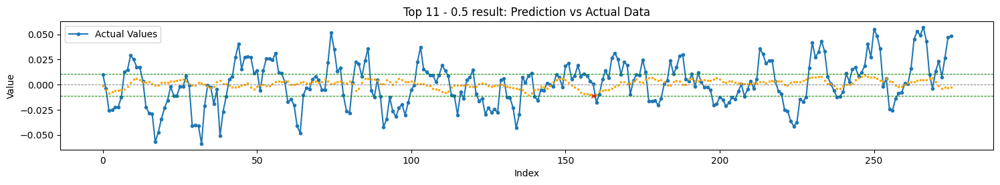

Total TH Pred.: 1
TH Pred. acc. : 0.00


Top 12 - 0.5
RMSE: 0.021988, STD_DEV: 0.022002, STD_PRD: 0.003545, OBJDIFF: 0.004601, RDIFF: -0.000014
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022379, inv. diff> 0.009605
Trend accuracy       : 47.601
Trend up accuracy    : 57.241
Trend down accuracy  : 36.508


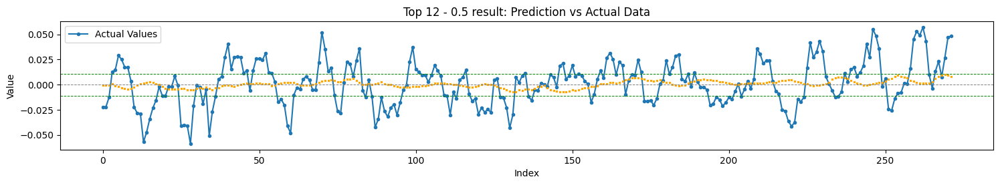

Total TH Pred.: 0


Top 13 - 0.5
RMSE: 0.021995, STD_DEV: 0.022002, STD_PRD: 0.002435, OBJDIFF: 0.004885, RDIFF: -0.000007
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022324, inv. diff> 0.010106
Trend accuracy       : 51.095
Trend up accuracy    : 76.552
Trend down accuracy  : 22.481


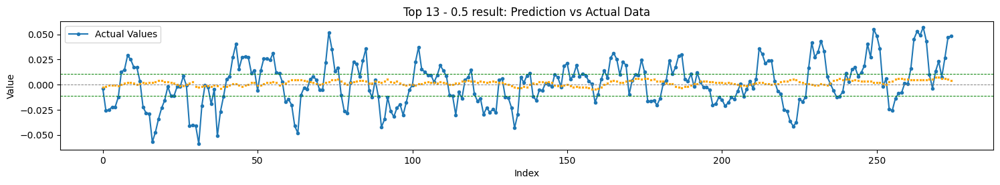

Total TH Pred.: 0


Top 14 - 0.5
RMSE: 0.028833, STD_DEV: 0.022002, STD_PRD: 0.020668, OBJDIFF: 0.007498, RDIFF: 0.006831
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.030244, inv. diff> 0.008909
Trend accuracy       : 55.720
Trend up accuracy    : 55.862
Trend down accuracy  : 55.556


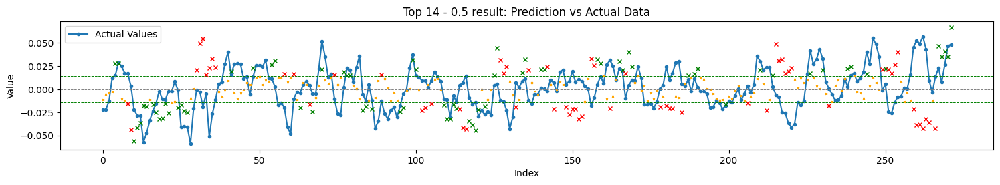

Total TH Pred.: 136
TH Pred. acc. : 53.68


Top 15 - 0.5
RMSE: 0.026621, STD_DEV: 0.021968, STD_PRD: 0.016179, OBJDIFF: 0.007547, RDIFF: 0.004653
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.027305, inv. diff> 0.008231
Trend accuracy       : 52.727
Trend up accuracy    : 49.315
Trend down accuracy  : 56.589


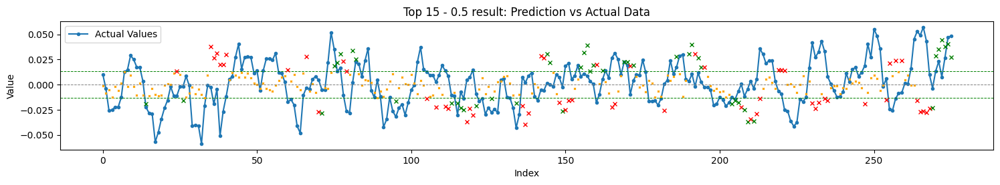

Total TH Pred.: 103
TH Pred. acc. : 44.66


Top 1 - 0.6
RMSE: 0.021396, STD_DEV: 0.021968, STD_PRD: 0.007593, OBJDIFF: 0.003022, RDIFF: -0.000572
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023853, inv. diff> 0.009073
Trend accuracy       : 59.273
Trend up accuracy    : 76.712
Trend down accuracy  : 39.535


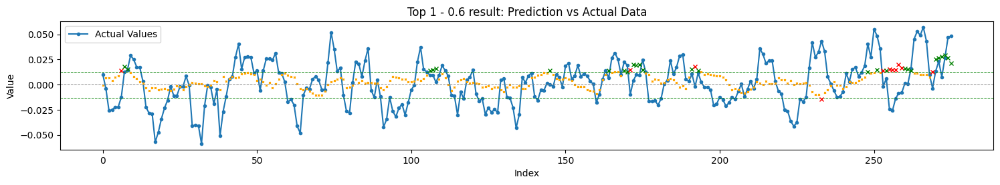

Total TH Pred.: 38
TH Pred. acc. : 71.05


Top 2 - 0.6
RMSE: 0.021314, STD_DEV: 0.022002, STD_PRD: 0.006986, OBJDIFF: 0.003066, RDIFF: -0.000688
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023377, inv. diff> 0.008883
Trend accuracy       : 53.650
Trend up accuracy    : 69.655
Trend down accuracy  : 35.659


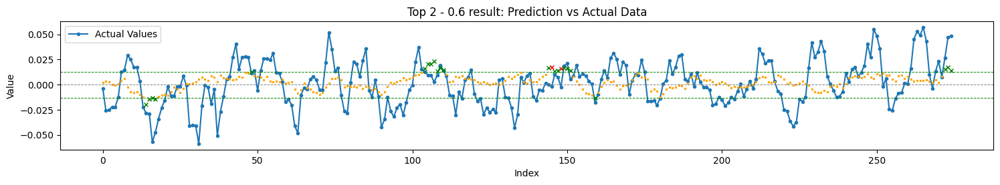

Total TH Pred.: 24
TH Pred. acc. : 91.67


Top 3 - 0.6
RMSE: 0.021549, STD_DEV: 0.022002, STD_PRD: 0.007305, OBJDIFF: 0.003222, RDIFF: -0.000452
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023508, inv. diff> 0.008855
Trend accuracy       : 59.124
Trend up accuracy    : 69.655
Trend down accuracy  : 47.287


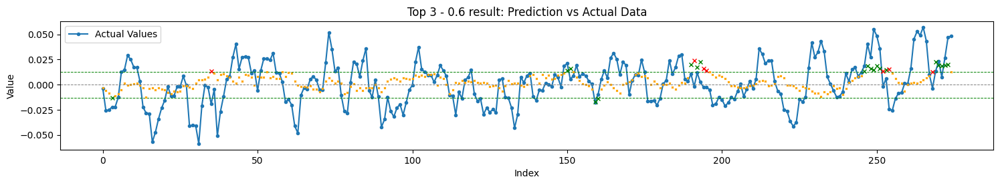

Total TH Pred.: 27
TH Pred. acc. : 74.07


Top 4 - 0.6
RMSE: 0.021346, STD_DEV: 0.022002, STD_PRD: 0.005851, OBJDIFF: 0.003382, RDIFF: -0.000656
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023008, inv. diff> 0.009081
Trend accuracy       : 57.934
Trend up accuracy    : 73.103
Trend down accuracy  : 40.476


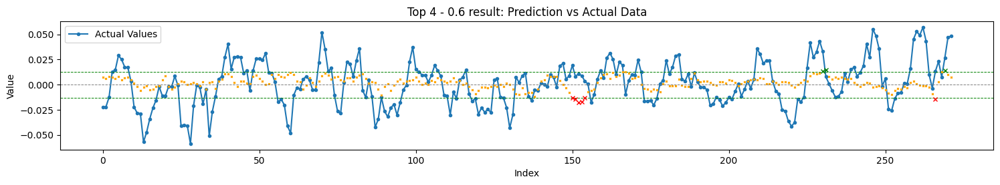

Total TH Pred.: 9
TH Pred. acc. : 33.33


Top 5 - 0.6
RMSE: 0.021730, STD_DEV: 0.021968, STD_PRD: 0.007309, OBJDIFF: 0.003427, RDIFF: -0.000238
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023367, inv. diff> 0.008729
Trend accuracy       : 58.909
Trend up accuracy    : 70.548
Trend down accuracy  : 45.736


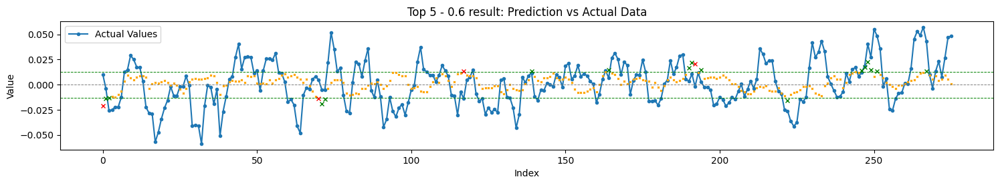

Total TH Pred.: 20
TH Pred. acc. : 80.00


Top 6 - 0.6
RMSE: 0.021968, STD_DEV: 0.021968, STD_PRD: 0.006441, OBJDIFF: 0.003881, RDIFF: -0.000001
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023266, inv. diff> 0.009062
Trend accuracy       : 56.364
Trend up accuracy    : 71.918
Trend down accuracy  : 38.760


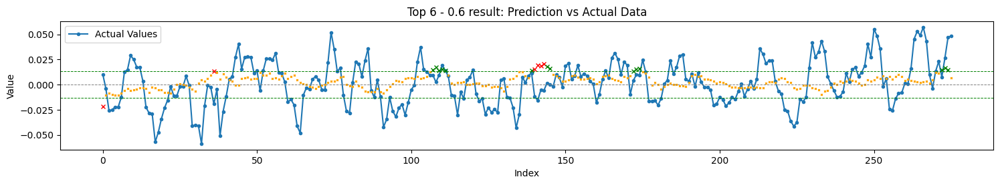

Total TH Pred.: 20
TH Pred. acc. : 70.00


Top 7 - 0.6
RMSE: 0.021253, STD_DEV: 0.021968, STD_PRD: 0.003182, OBJDIFF: 0.003981, RDIFF: -0.000715
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022365, inv. diff> 0.009790
Trend accuracy       : 53.455
Trend up accuracy    : 70.548
Trend down accuracy  : 34.109


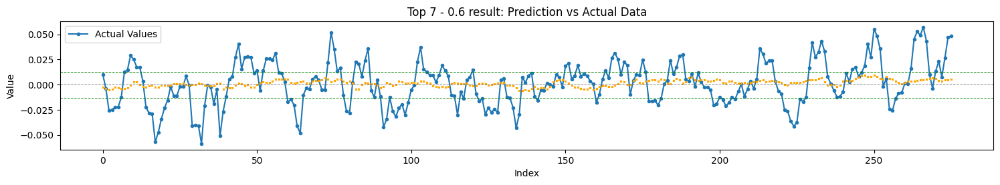

Total TH Pred.: 0


Top 8 - 0.6
RMSE: 0.021928, STD_DEV: 0.022002, STD_PRD: 0.005410, OBJDIFF: 0.004074, RDIFF: -0.000074
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022877, inv. diff> 0.009171
Trend accuracy       : 52.030
Trend up accuracy    : 64.828
Trend down accuracy  : 37.302


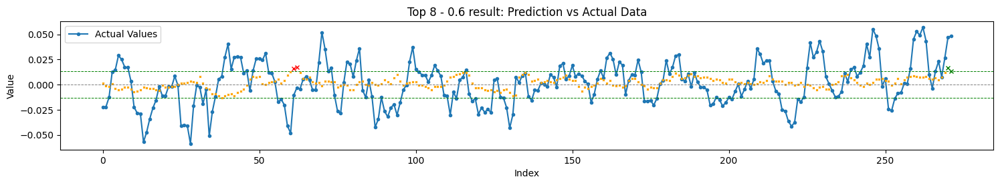

Total TH Pred.: 4
TH Pred. acc. : 50.00


Top 9 - 0.6
RMSE: 0.021642, STD_DEV: 0.022002, STD_PRD: 0.003914, OBJDIFF: 0.004162, RDIFF: -0.000359
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022384, inv. diff> 0.009426
Trend accuracy       : 57.934
Trend up accuracy    : 57.931
Trend down accuracy  : 57.937


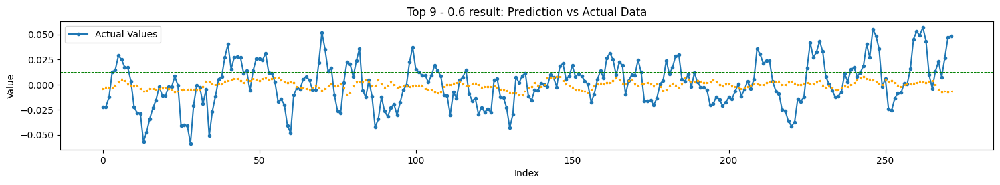

Total TH Pred.: 0


Top 10 - 0.6
RMSE: 0.021897, STD_DEV: 0.021968, STD_PRD: 0.003949, OBJDIFF: 0.004433, RDIFF: -0.000072
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022321, inv. diff> 0.009362
Trend accuracy       : 52.364
Trend up accuracy    : 39.041
Trend down accuracy  : 67.442


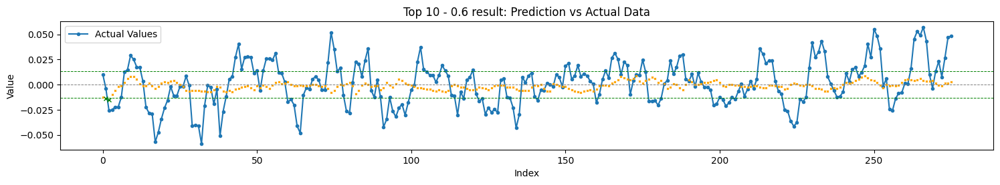

Total TH Pred.: 2
TH Pred. acc. : 100.00


Top 11 - 0.6
RMSE: 0.021910, STD_DEV: 0.021968, STD_PRD: 0.003931, OBJDIFF: 0.004451, RDIFF: -0.000059
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022419, inv. diff> 0.009469
Trend accuracy       : 49.455
Trend up accuracy    : 63.014
Trend down accuracy  : 34.109


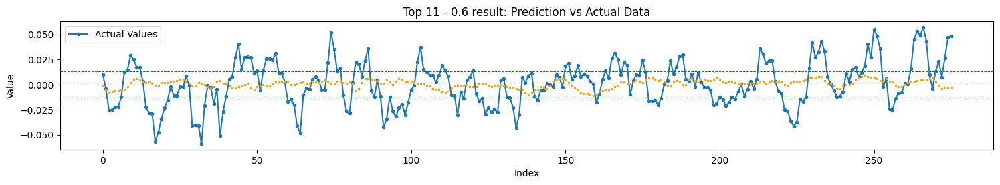

Total TH Pred.: 0


Top 12 - 0.6
RMSE: 0.021988, STD_DEV: 0.022002, STD_PRD: 0.003545, OBJDIFF: 0.004601, RDIFF: -0.000014
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022379, inv. diff> 0.009605
Trend accuracy       : 47.601
Trend up accuracy    : 57.241
Trend down accuracy  : 36.508


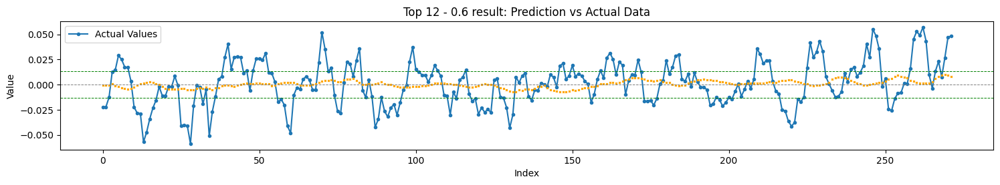

Total TH Pred.: 0


Top 13 - 0.6
RMSE: 0.021995, STD_DEV: 0.022002, STD_PRD: 0.002435, OBJDIFF: 0.004885, RDIFF: -0.000007
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022324, inv. diff> 0.010106
Trend accuracy       : 51.095
Trend up accuracy    : 76.552
Trend down accuracy  : 22.481


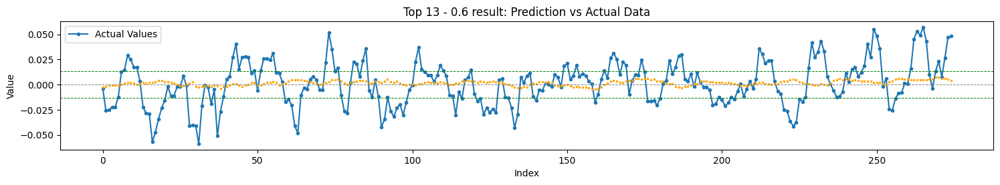

Total TH Pred.: 0


Top 14 - 0.6
RMSE: 0.028833, STD_DEV: 0.022002, STD_PRD: 0.020668, OBJDIFF: 0.007498, RDIFF: 0.006831
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.030244, inv. diff> 0.008909
Trend accuracy       : 55.720
Trend up accuracy    : 55.862
Trend down accuracy  : 55.556


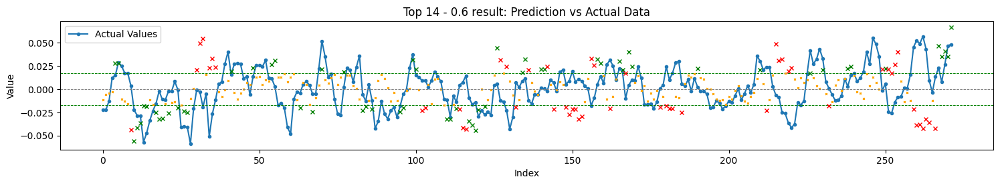

Total TH Pred.: 112
TH Pred. acc. : 53.57


Top 15 - 0.6
RMSE: 0.026621, STD_DEV: 0.021968, STD_PRD: 0.016179, OBJDIFF: 0.007547, RDIFF: 0.004653
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.027305, inv. diff> 0.008231
Trend accuracy       : 52.727
Trend up accuracy    : 49.315
Trend down accuracy  : 56.589


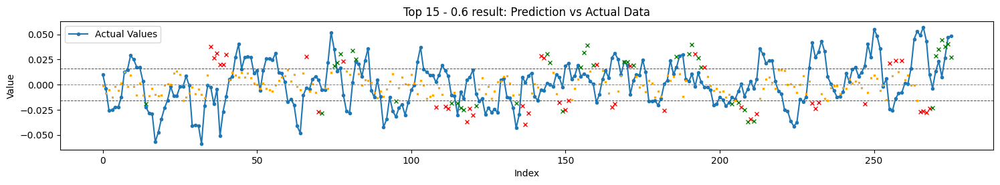

Total TH Pred.: 85
TH Pred. acc. : 48.24


Top 1 - 0.7
RMSE: 0.021396, STD_DEV: 0.021968, STD_PRD: 0.007593, OBJDIFF: 0.003022, RDIFF: -0.000572
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023853, inv. diff> 0.009073
Trend accuracy       : 59.273
Trend up accuracy    : 76.712
Trend down accuracy  : 39.535


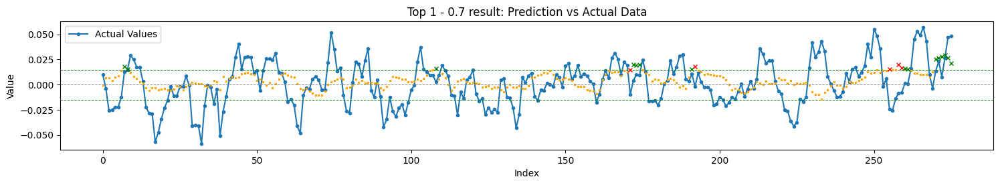

Total TH Pred.: 20
TH Pred. acc. : 75.00


Top 2 - 0.7
RMSE: 0.021314, STD_DEV: 0.022002, STD_PRD: 0.006986, OBJDIFF: 0.003066, RDIFF: -0.000688
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023377, inv. diff> 0.008883
Trend accuracy       : 53.650
Trend up accuracy    : 69.655
Trend down accuracy  : 35.659


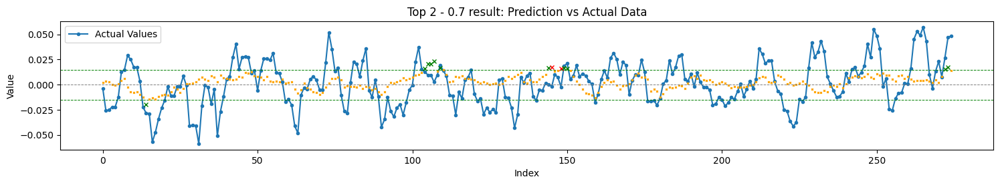

Total TH Pred.: 13
TH Pred. acc. : 84.62


Top 3 - 0.7
RMSE: 0.021549, STD_DEV: 0.022002, STD_PRD: 0.007305, OBJDIFF: 0.003222, RDIFF: -0.000452
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023508, inv. diff> 0.008855
Trend accuracy       : 59.124
Trend up accuracy    : 69.655
Trend down accuracy  : 47.287


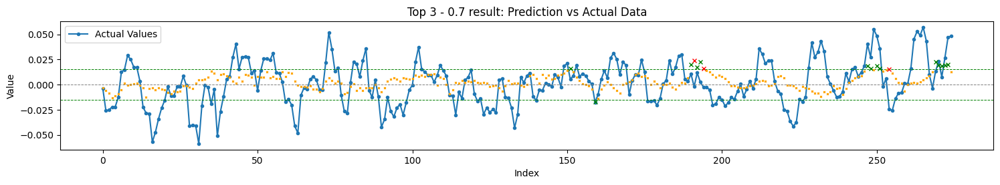

Total TH Pred.: 17
TH Pred. acc. : 82.35


Top 4 - 0.7
RMSE: 0.021346, STD_DEV: 0.022002, STD_PRD: 0.005851, OBJDIFF: 0.003382, RDIFF: -0.000656
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023008, inv. diff> 0.009081
Trend accuracy       : 57.934
Trend up accuracy    : 73.103
Trend down accuracy  : 40.476


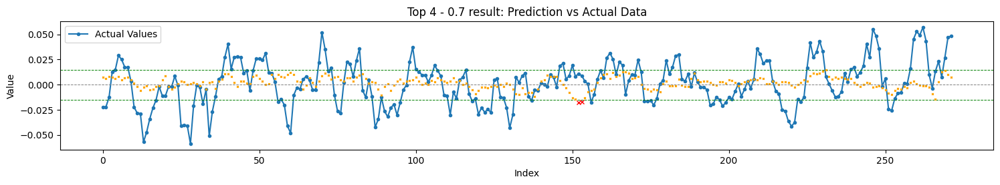

Total TH Pred.: 2
TH Pred. acc. : 0.00


Top 5 - 0.7
RMSE: 0.021730, STD_DEV: 0.021968, STD_PRD: 0.007309, OBJDIFF: 0.003427, RDIFF: -0.000238
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023367, inv. diff> 0.008729
Trend accuracy       : 58.909
Trend up accuracy    : 70.548
Trend down accuracy  : 45.736


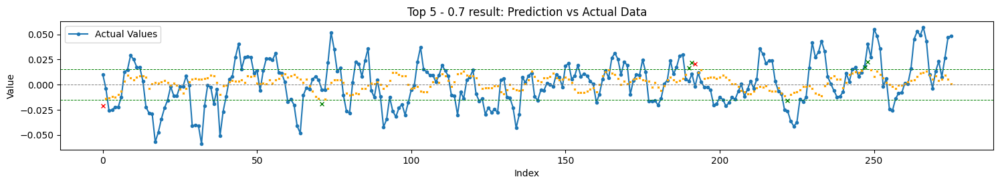

Total TH Pred.: 8
TH Pred. acc. : 75.00


Top 6 - 0.7
RMSE: 0.021968, STD_DEV: 0.021968, STD_PRD: 0.006441, OBJDIFF: 0.003881, RDIFF: -0.000001
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023266, inv. diff> 0.009062
Trend accuracy       : 56.364
Trend up accuracy    : 71.918
Trend down accuracy  : 38.760


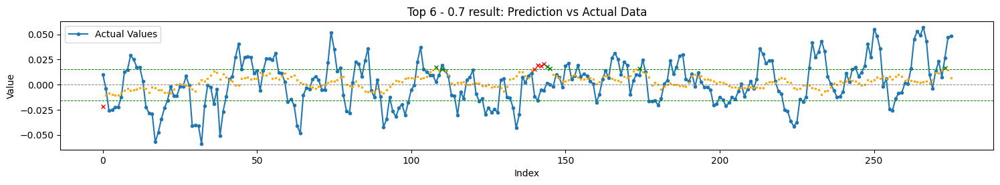

Total TH Pred.: 11
TH Pred. acc. : 54.55


Top 7 - 0.7
RMSE: 0.021253, STD_DEV: 0.021968, STD_PRD: 0.003182, OBJDIFF: 0.003981, RDIFF: -0.000715
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022365, inv. diff> 0.009790
Trend accuracy       : 53.455
Trend up accuracy    : 70.548
Trend down accuracy  : 34.109


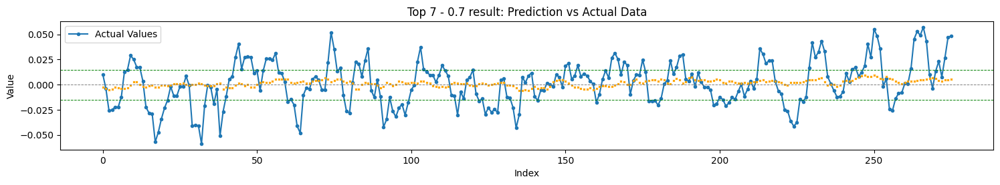

Total TH Pred.: 0


Top 8 - 0.7
RMSE: 0.021928, STD_DEV: 0.022002, STD_PRD: 0.005410, OBJDIFF: 0.004074, RDIFF: -0.000074
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022877, inv. diff> 0.009171
Trend accuracy       : 52.030
Trend up accuracy    : 64.828
Trend down accuracy  : 37.302


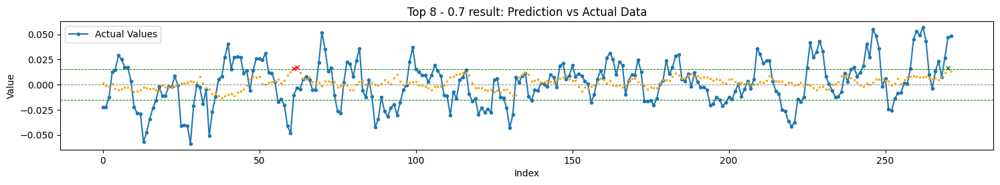

Total TH Pred.: 3
TH Pred. acc. : 33.33


Top 9 - 0.7
RMSE: 0.021642, STD_DEV: 0.022002, STD_PRD: 0.003914, OBJDIFF: 0.004162, RDIFF: -0.000359
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022384, inv. diff> 0.009426
Trend accuracy       : 57.934
Trend up accuracy    : 57.931
Trend down accuracy  : 57.937


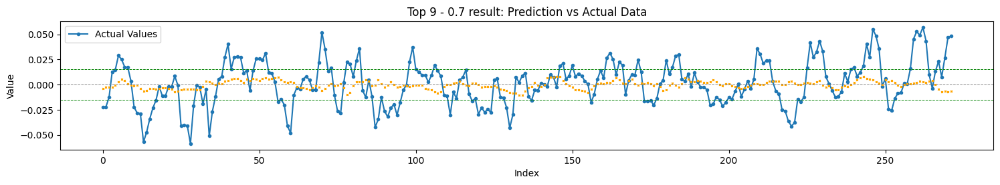

Total TH Pred.: 0


Top 10 - 0.7
RMSE: 0.021897, STD_DEV: 0.021968, STD_PRD: 0.003949, OBJDIFF: 0.004433, RDIFF: -0.000072
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022321, inv. diff> 0.009362
Trend accuracy       : 52.364
Trend up accuracy    : 39.041
Trend down accuracy  : 67.442


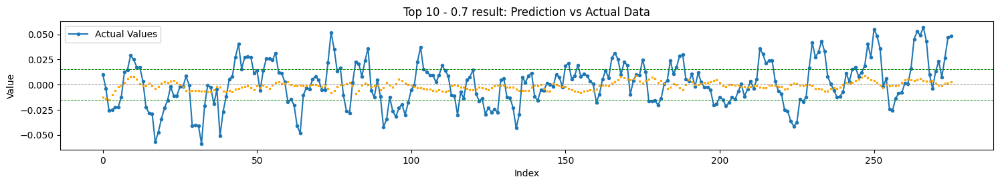

Total TH Pred.: 0


Top 11 - 0.7
RMSE: 0.021910, STD_DEV: 0.021968, STD_PRD: 0.003931, OBJDIFF: 0.004451, RDIFF: -0.000059
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022419, inv. diff> 0.009469
Trend accuracy       : 49.455
Trend up accuracy    : 63.014
Trend down accuracy  : 34.109


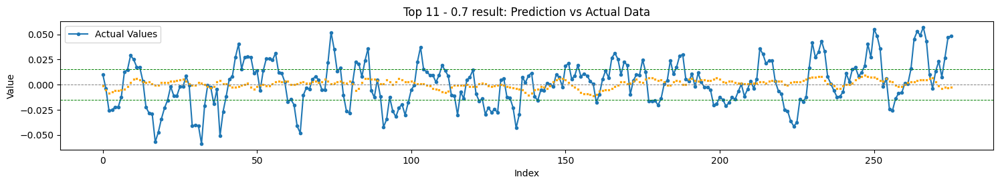

Total TH Pred.: 0


Top 12 - 0.7
RMSE: 0.021988, STD_DEV: 0.022002, STD_PRD: 0.003545, OBJDIFF: 0.004601, RDIFF: -0.000014
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022379, inv. diff> 0.009605
Trend accuracy       : 47.601
Trend up accuracy    : 57.241
Trend down accuracy  : 36.508


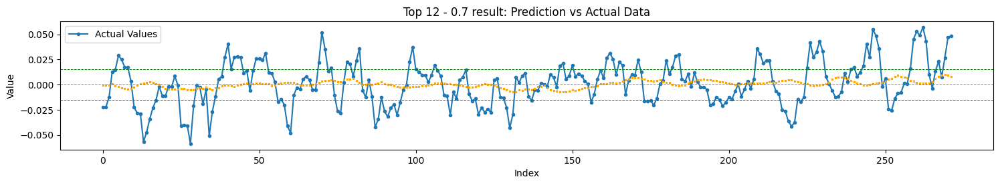

Total TH Pred.: 0


Top 13 - 0.7
RMSE: 0.021995, STD_DEV: 0.022002, STD_PRD: 0.002435, OBJDIFF: 0.004885, RDIFF: -0.000007
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022324, inv. diff> 0.010106
Trend accuracy       : 51.095
Trend up accuracy    : 76.552
Trend down accuracy  : 22.481


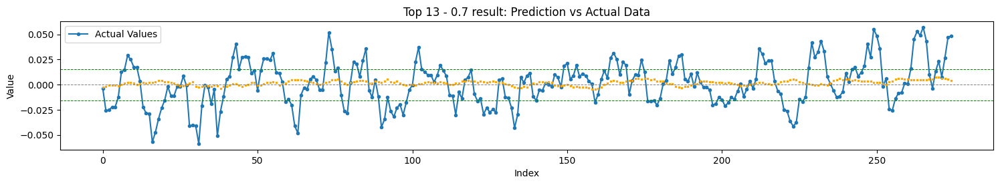

Total TH Pred.: 0


Top 14 - 0.7
RMSE: 0.028833, STD_DEV: 0.022002, STD_PRD: 0.020668, OBJDIFF: 0.007498, RDIFF: 0.006831
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.030244, inv. diff> 0.008909
Trend accuracy       : 55.720
Trend up accuracy    : 55.862
Trend down accuracy  : 55.556


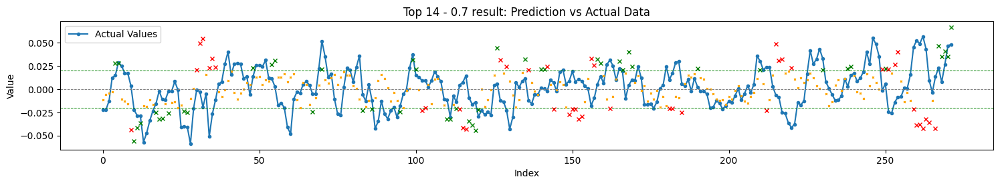

Total TH Pred.: 93
TH Pred. acc. : 52.69


Top 15 - 0.7
RMSE: 0.026621, STD_DEV: 0.021968, STD_PRD: 0.016179, OBJDIFF: 0.007547, RDIFF: 0.004653
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.027305, inv. diff> 0.008231
Trend accuracy       : 52.727
Trend up accuracy    : 49.315
Trend down accuracy  : 56.589


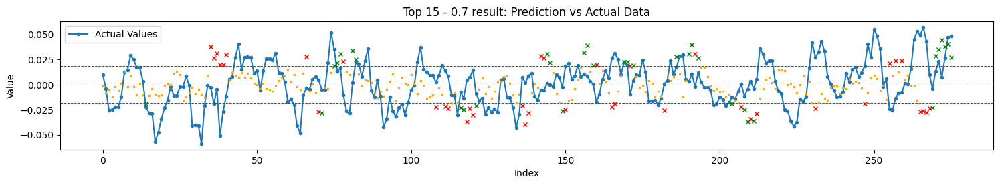

Total TH Pred.: 73
TH Pred. acc. : 46.58


Top 1 - 0.8
RMSE: 0.021396, STD_DEV: 0.021968, STD_PRD: 0.007593, OBJDIFF: 0.003022, RDIFF: -0.000572
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023853, inv. diff> 0.009073
Trend accuracy       : 59.273
Trend up accuracy    : 76.712
Trend down accuracy  : 39.535


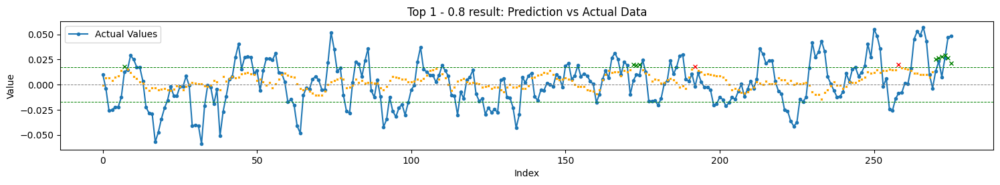

Total TH Pred.: 12
TH Pred. acc. : 83.33


Top 2 - 0.8
RMSE: 0.021314, STD_DEV: 0.022002, STD_PRD: 0.006986, OBJDIFF: 0.003066, RDIFF: -0.000688
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023377, inv. diff> 0.008883
Trend accuracy       : 53.650
Trend up accuracy    : 69.655
Trend down accuracy  : 35.659


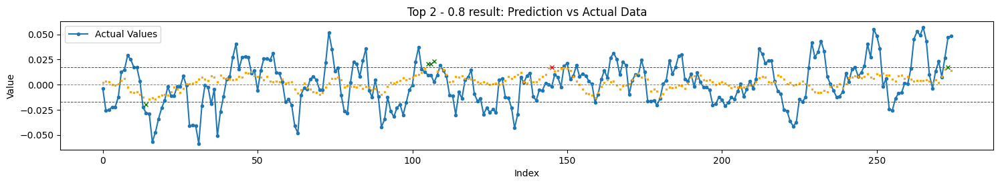

Total TH Pred.: 6
TH Pred. acc. : 83.33


Top 3 - 0.8
RMSE: 0.021549, STD_DEV: 0.022002, STD_PRD: 0.007305, OBJDIFF: 0.003222, RDIFF: -0.000452
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023508, inv. diff> 0.008855
Trend accuracy       : 59.124
Trend up accuracy    : 69.655
Trend down accuracy  : 47.287


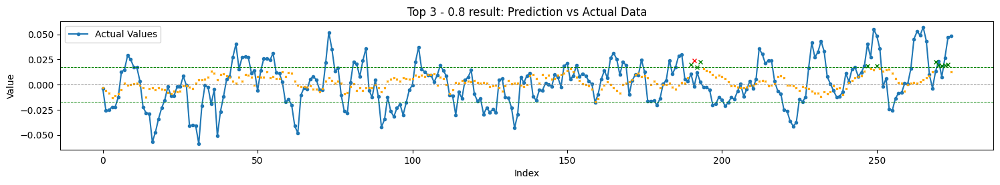

Total TH Pred.: 11
TH Pred. acc. : 90.91


Top 4 - 0.8
RMSE: 0.021346, STD_DEV: 0.022002, STD_PRD: 0.005851, OBJDIFF: 0.003382, RDIFF: -0.000656
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023008, inv. diff> 0.009081
Trend accuracy       : 57.934
Trend up accuracy    : 73.103
Trend down accuracy  : 40.476


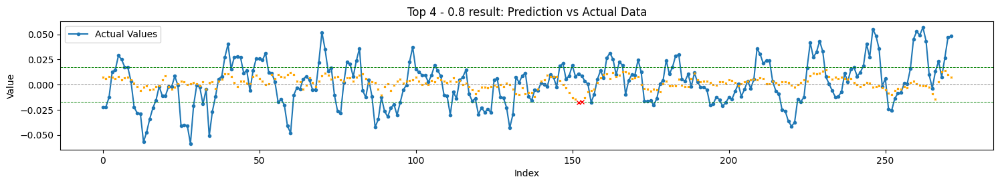

Total TH Pred.: 2
TH Pred. acc. : 0.00


Top 5 - 0.8
RMSE: 0.021730, STD_DEV: 0.021968, STD_PRD: 0.007309, OBJDIFF: 0.003427, RDIFF: -0.000238
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023367, inv. diff> 0.008729
Trend accuracy       : 58.909
Trend up accuracy    : 70.548
Trend down accuracy  : 45.736


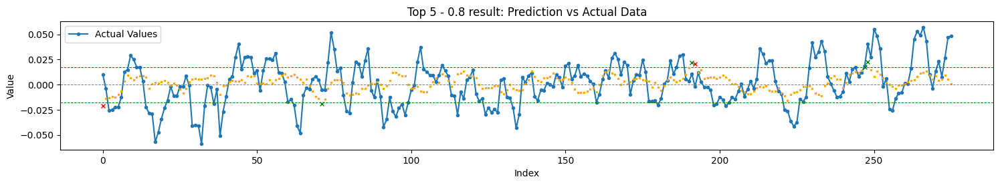

Total TH Pred.: 6
TH Pred. acc. : 66.67


Top 6 - 0.8
RMSE: 0.021968, STD_DEV: 0.021968, STD_PRD: 0.006441, OBJDIFF: 0.003881, RDIFF: -0.000001
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023266, inv. diff> 0.009062
Trend accuracy       : 56.364
Trend up accuracy    : 71.918
Trend down accuracy  : 38.760


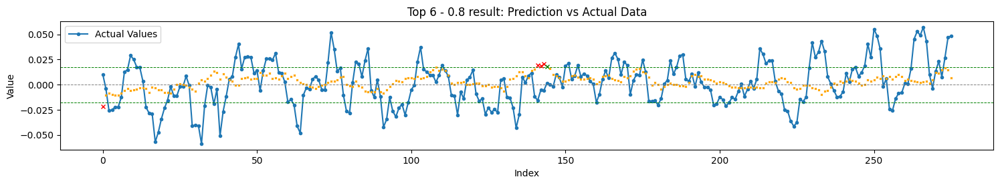

Total TH Pred.: 5
TH Pred. acc. : 20.00


Top 7 - 0.8
RMSE: 0.021253, STD_DEV: 0.021968, STD_PRD: 0.003182, OBJDIFF: 0.003981, RDIFF: -0.000715
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022365, inv. diff> 0.009790
Trend accuracy       : 53.455
Trend up accuracy    : 70.548
Trend down accuracy  : 34.109


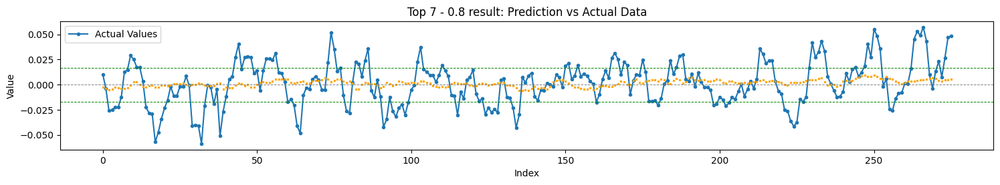

Total TH Pred.: 0


Top 8 - 0.8
RMSE: 0.021928, STD_DEV: 0.022002, STD_PRD: 0.005410, OBJDIFF: 0.004074, RDIFF: -0.000074
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022877, inv. diff> 0.009171
Trend accuracy       : 52.030
Trend up accuracy    : 64.828
Trend down accuracy  : 37.302


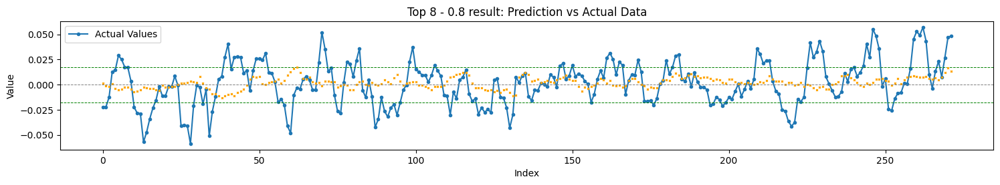

Total TH Pred.: 0


Top 9 - 0.8
RMSE: 0.021642, STD_DEV: 0.022002, STD_PRD: 0.003914, OBJDIFF: 0.004162, RDIFF: -0.000359
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022384, inv. diff> 0.009426
Trend accuracy       : 57.934
Trend up accuracy    : 57.931
Trend down accuracy  : 57.937


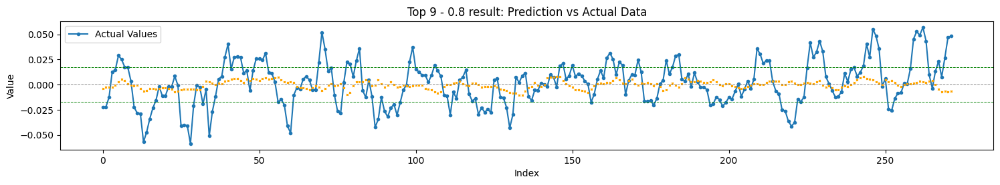

Total TH Pred.: 0


Top 10 - 0.8
RMSE: 0.021897, STD_DEV: 0.021968, STD_PRD: 0.003949, OBJDIFF: 0.004433, RDIFF: -0.000072
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022321, inv. diff> 0.009362
Trend accuracy       : 52.364
Trend up accuracy    : 39.041
Trend down accuracy  : 67.442


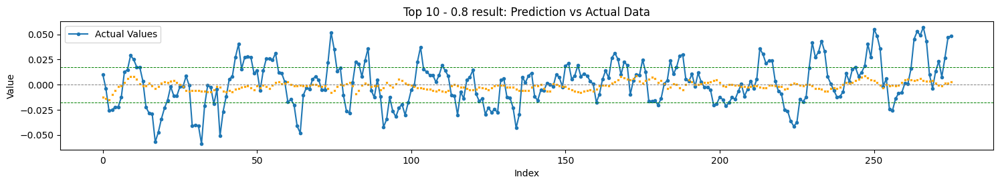

Total TH Pred.: 0


Top 11 - 0.8
RMSE: 0.021910, STD_DEV: 0.021968, STD_PRD: 0.003931, OBJDIFF: 0.004451, RDIFF: -0.000059
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022419, inv. diff> 0.009469
Trend accuracy       : 49.455
Trend up accuracy    : 63.014
Trend down accuracy  : 34.109


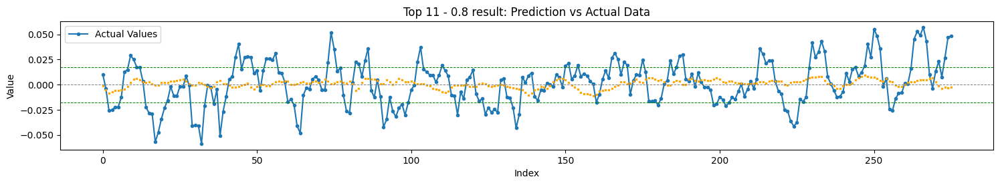

Total TH Pred.: 0


Top 12 - 0.8
RMSE: 0.021988, STD_DEV: 0.022002, STD_PRD: 0.003545, OBJDIFF: 0.004601, RDIFF: -0.000014
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022379, inv. diff> 0.009605
Trend accuracy       : 47.601
Trend up accuracy    : 57.241
Trend down accuracy  : 36.508


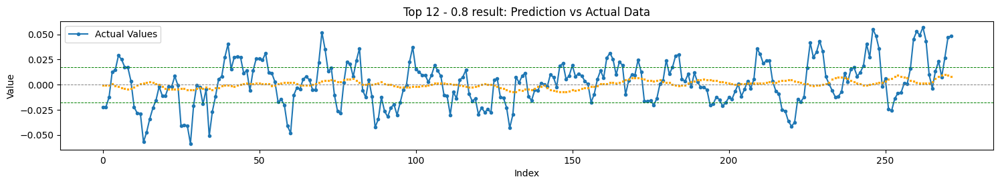

Total TH Pred.: 0


Top 13 - 0.8
RMSE: 0.021995, STD_DEV: 0.022002, STD_PRD: 0.002435, OBJDIFF: 0.004885, RDIFF: -0.000007
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022324, inv. diff> 0.010106
Trend accuracy       : 51.095
Trend up accuracy    : 76.552
Trend down accuracy  : 22.481


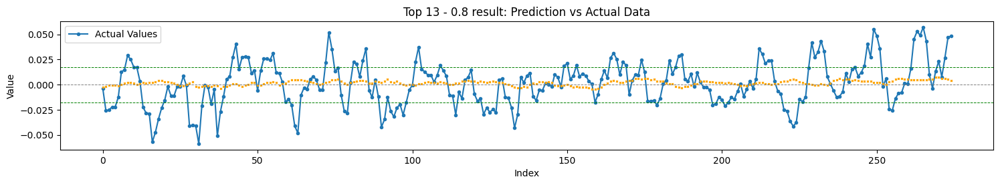

Total TH Pred.: 0


Top 14 - 0.8
RMSE: 0.028833, STD_DEV: 0.022002, STD_PRD: 0.020668, OBJDIFF: 0.007498, RDIFF: 0.006831
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.030244, inv. diff> 0.008909
Trend accuracy       : 55.720
Trend up accuracy    : 55.862
Trend down accuracy  : 55.556


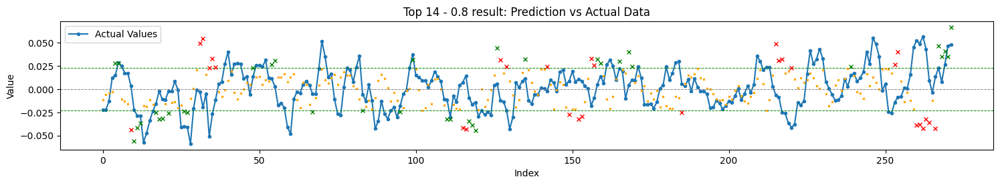

Total TH Pred.: 65
TH Pred. acc. : 55.38


Top 15 - 0.8
RMSE: 0.026621, STD_DEV: 0.021968, STD_PRD: 0.016179, OBJDIFF: 0.007547, RDIFF: 0.004653
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.027305, inv. diff> 0.008231
Trend accuracy       : 52.727
Trend up accuracy    : 49.315
Trend down accuracy  : 56.589


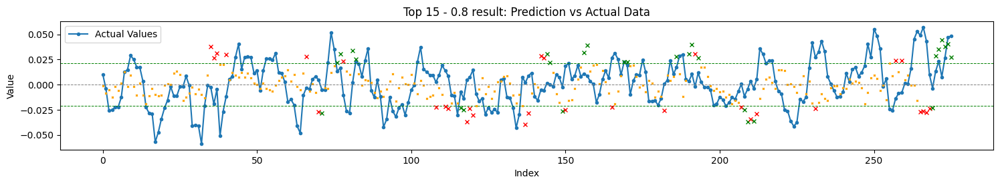

Total TH Pred.: 59
TH Pred. acc. : 47.46


Top 1 - 0.9
RMSE: 0.021396, STD_DEV: 0.021968, STD_PRD: 0.007593, OBJDIFF: 0.003022, RDIFF: -0.000572
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023853, inv. diff> 0.009073
Trend accuracy       : 59.273
Trend up accuracy    : 76.712
Trend down accuracy  : 39.535


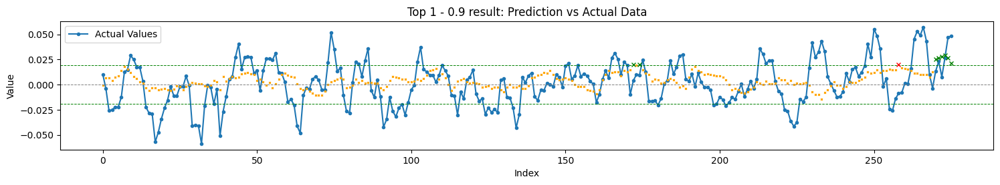

Total TH Pred.: 9
TH Pred. acc. : 88.89


Top 2 - 0.9
RMSE: 0.021314, STD_DEV: 0.022002, STD_PRD: 0.006986, OBJDIFF: 0.003066, RDIFF: -0.000688
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023377, inv. diff> 0.008883
Trend accuracy       : 53.650
Trend up accuracy    : 69.655
Trend down accuracy  : 35.659


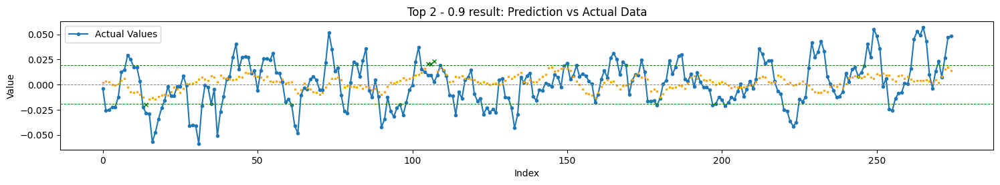

Total TH Pred.: 4
TH Pred. acc. : 100.00


Top 3 - 0.9
RMSE: 0.021549, STD_DEV: 0.022002, STD_PRD: 0.007305, OBJDIFF: 0.003222, RDIFF: -0.000452
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023508, inv. diff> 0.008855
Trend accuracy       : 59.124
Trend up accuracy    : 69.655
Trend down accuracy  : 47.287


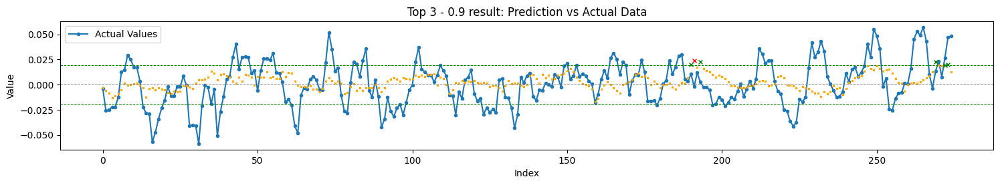

Total TH Pred.: 6
TH Pred. acc. : 83.33


Top 4 - 0.9
RMSE: 0.021346, STD_DEV: 0.022002, STD_PRD: 0.005851, OBJDIFF: 0.003382, RDIFF: -0.000656
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023008, inv. diff> 0.009081
Trend accuracy       : 57.934
Trend up accuracy    : 73.103
Trend down accuracy  : 40.476


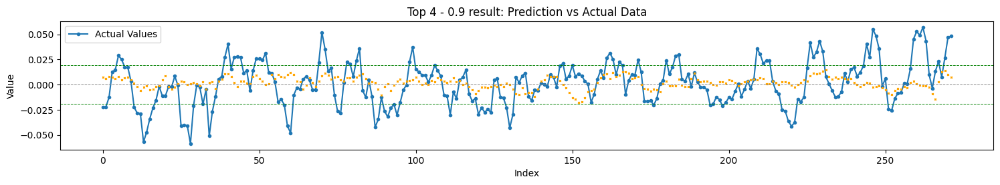

Total TH Pred.: 0


Top 5 - 0.9
RMSE: 0.021730, STD_DEV: 0.021968, STD_PRD: 0.007309, OBJDIFF: 0.003427, RDIFF: -0.000238
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023367, inv. diff> 0.008729
Trend accuracy       : 58.909
Trend up accuracy    : 70.548
Trend down accuracy  : 45.736


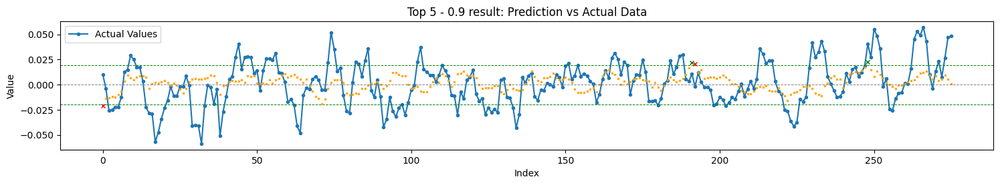

Total TH Pred.: 4
TH Pred. acc. : 50.00


Top 6 - 0.9
RMSE: 0.021968, STD_DEV: 0.021968, STD_PRD: 0.006441, OBJDIFF: 0.003881, RDIFF: -0.000001
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023266, inv. diff> 0.009062
Trend accuracy       : 56.364
Trend up accuracy    : 71.918
Trend down accuracy  : 38.760


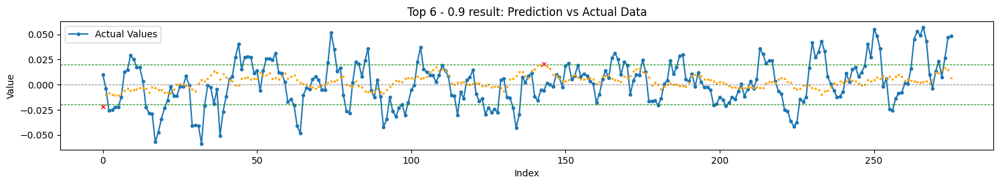

Total TH Pred.: 2
TH Pred. acc. : 0.00


Top 7 - 0.9
RMSE: 0.021253, STD_DEV: 0.021968, STD_PRD: 0.003182, OBJDIFF: 0.003981, RDIFF: -0.000715
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022365, inv. diff> 0.009790
Trend accuracy       : 53.455
Trend up accuracy    : 70.548
Trend down accuracy  : 34.109


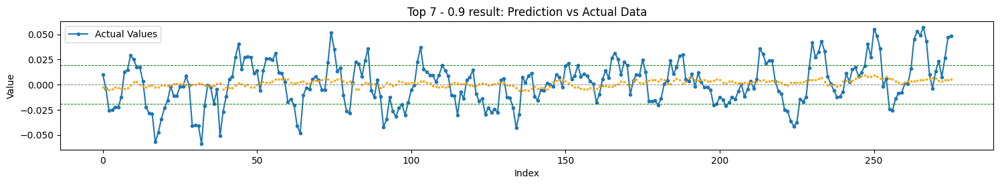

Total TH Pred.: 0


Top 8 - 0.9
RMSE: 0.021928, STD_DEV: 0.022002, STD_PRD: 0.005410, OBJDIFF: 0.004074, RDIFF: -0.000074
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022877, inv. diff> 0.009171
Trend accuracy       : 52.030
Trend up accuracy    : 64.828
Trend down accuracy  : 37.302


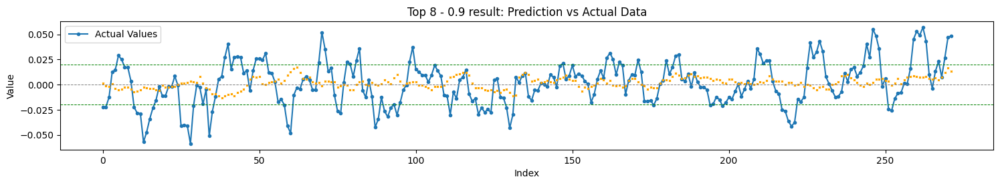

Total TH Pred.: 0


Top 9 - 0.9
RMSE: 0.021642, STD_DEV: 0.022002, STD_PRD: 0.003914, OBJDIFF: 0.004162, RDIFF: -0.000359
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022384, inv. diff> 0.009426
Trend accuracy       : 57.934
Trend up accuracy    : 57.931
Trend down accuracy  : 57.937


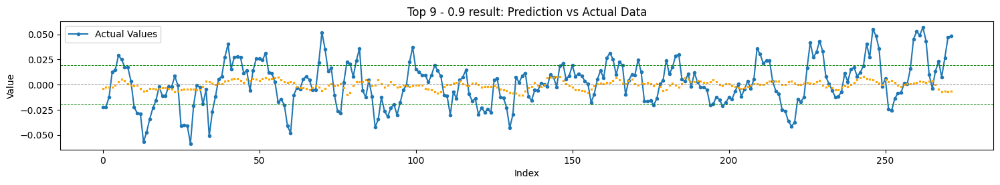

Total TH Pred.: 0


Top 10 - 0.9
RMSE: 0.021897, STD_DEV: 0.021968, STD_PRD: 0.003949, OBJDIFF: 0.004433, RDIFF: -0.000072
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022321, inv. diff> 0.009362
Trend accuracy       : 52.364
Trend up accuracy    : 39.041
Trend down accuracy  : 67.442


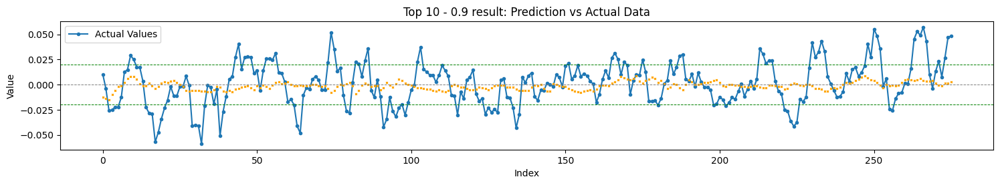

Total TH Pred.: 0


Top 11 - 0.9
RMSE: 0.021910, STD_DEV: 0.021968, STD_PRD: 0.003931, OBJDIFF: 0.004451, RDIFF: -0.000059
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022419, inv. diff> 0.009469
Trend accuracy       : 49.455
Trend up accuracy    : 63.014
Trend down accuracy  : 34.109


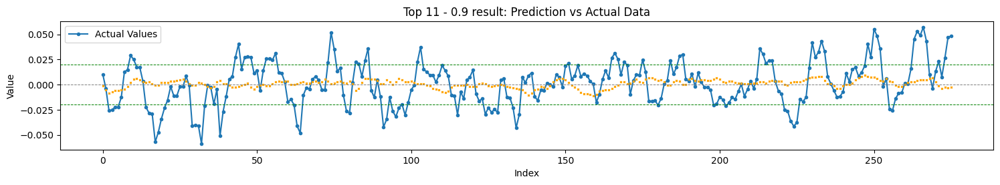

Total TH Pred.: 0


Top 12 - 0.9
RMSE: 0.021988, STD_DEV: 0.022002, STD_PRD: 0.003545, OBJDIFF: 0.004601, RDIFF: -0.000014
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022379, inv. diff> 0.009605
Trend accuracy       : 47.601
Trend up accuracy    : 57.241
Trend down accuracy  : 36.508


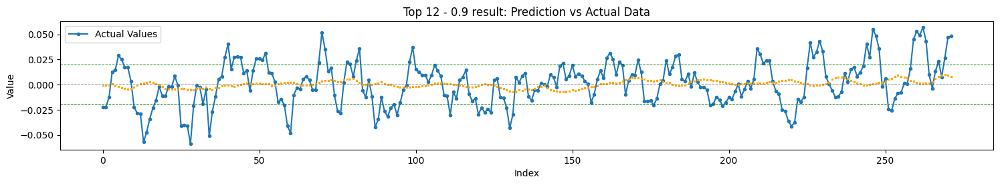

Total TH Pred.: 0


Top 13 - 0.9
RMSE: 0.021995, STD_DEV: 0.022002, STD_PRD: 0.002435, OBJDIFF: 0.004885, RDIFF: -0.000007
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022324, inv. diff> 0.010106
Trend accuracy       : 51.095
Trend up accuracy    : 76.552
Trend down accuracy  : 22.481


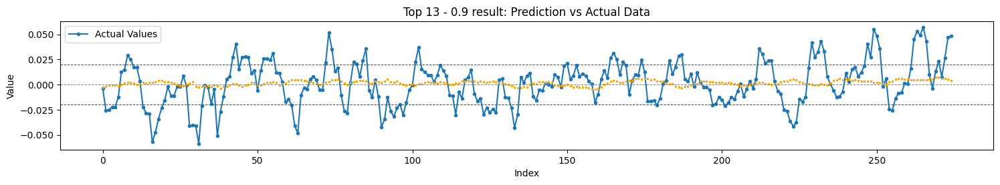

Total TH Pred.: 0


Top 14 - 0.9
RMSE: 0.028833, STD_DEV: 0.022002, STD_PRD: 0.020668, OBJDIFF: 0.007498, RDIFF: 0.006831
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.030244, inv. diff> 0.008909
Trend accuracy       : 55.720
Trend up accuracy    : 55.862
Trend down accuracy  : 55.556


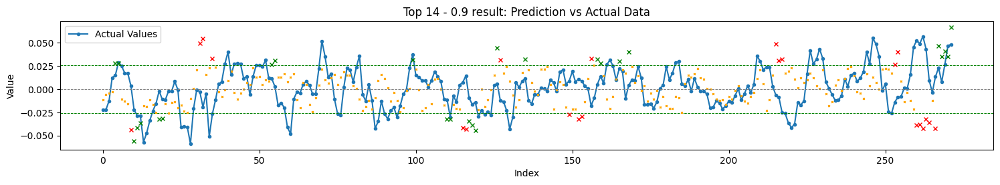

Total TH Pred.: 48
TH Pred. acc. : 54.17


Top 15 - 0.9
RMSE: 0.026621, STD_DEV: 0.021968, STD_PRD: 0.016179, OBJDIFF: 0.007547, RDIFF: 0.004653
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.027305, inv. diff> 0.008231
Trend accuracy       : 52.727
Trend up accuracy    : 49.315
Trend down accuracy  : 56.589


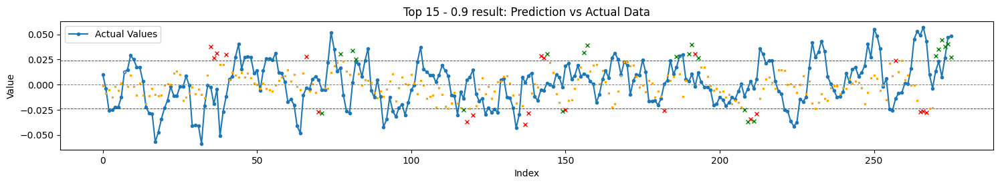

Total TH Pred.: 43
TH Pred. acc. : 51.16


Top 1 - 1.0
RMSE: 0.021396, STD_DEV: 0.021968, STD_PRD: 0.007593, OBJDIFF: 0.003022, RDIFF: -0.000572
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023853, inv. diff> 0.009073
Trend accuracy       : 59.273
Trend up accuracy    : 76.712
Trend down accuracy  : 39.535


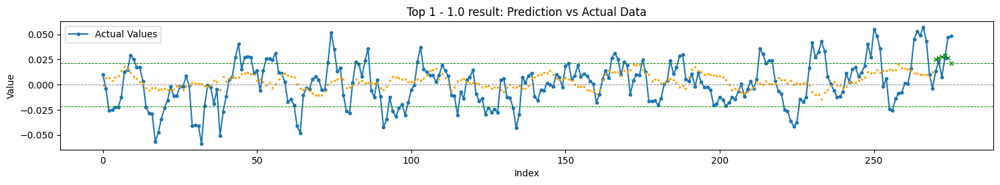

Total TH Pred.: 6
TH Pred. acc. : 100.00


Top 2 - 1.0
RMSE: 0.021314, STD_DEV: 0.022002, STD_PRD: 0.006986, OBJDIFF: 0.003066, RDIFF: -0.000688
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023377, inv. diff> 0.008883
Trend accuracy       : 53.650
Trend up accuracy    : 69.655
Trend down accuracy  : 35.659


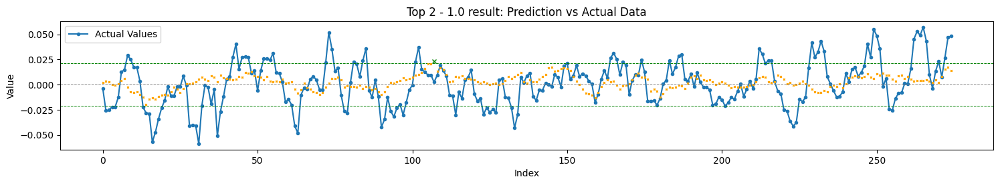

Total TH Pred.: 1
TH Pred. acc. : 100.00


Top 3 - 1.0
RMSE: 0.021549, STD_DEV: 0.022002, STD_PRD: 0.007305, OBJDIFF: 0.003222, RDIFF: -0.000452
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023508, inv. diff> 0.008855
Trend accuracy       : 59.124
Trend up accuracy    : 69.655
Trend down accuracy  : 47.287


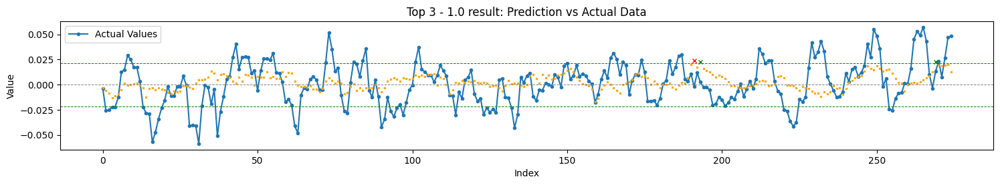

Total TH Pred.: 3
TH Pred. acc. : 66.67


Top 4 - 1.0
RMSE: 0.021346, STD_DEV: 0.022002, STD_PRD: 0.005851, OBJDIFF: 0.003382, RDIFF: -0.000656
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023008, inv. diff> 0.009081
Trend accuracy       : 57.934
Trend up accuracy    : 73.103
Trend down accuracy  : 40.476


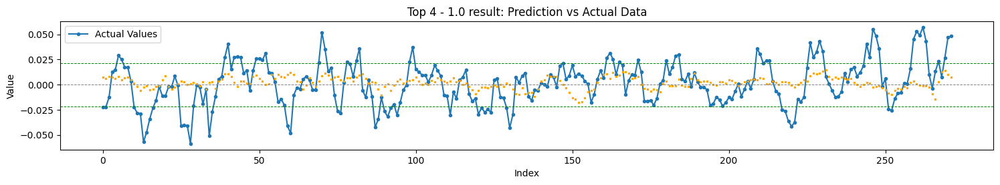

Total TH Pred.: 0


Top 5 - 1.0
RMSE: 0.021730, STD_DEV: 0.021968, STD_PRD: 0.007309, OBJDIFF: 0.003427, RDIFF: -0.000238
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023367, inv. diff> 0.008729
Trend accuracy       : 58.909
Trend up accuracy    : 70.548
Trend down accuracy  : 45.736


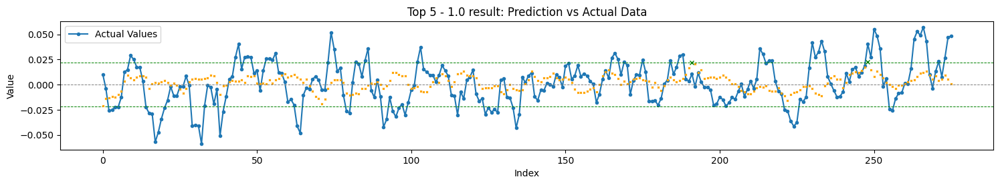

Total TH Pred.: 2
TH Pred. acc. : 100.00


Top 6 - 1.0
RMSE: 0.021968, STD_DEV: 0.021968, STD_PRD: 0.006441, OBJDIFF: 0.003881, RDIFF: -0.000001
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.023266, inv. diff> 0.009062
Trend accuracy       : 56.364
Trend up accuracy    : 71.918
Trend down accuracy  : 38.760


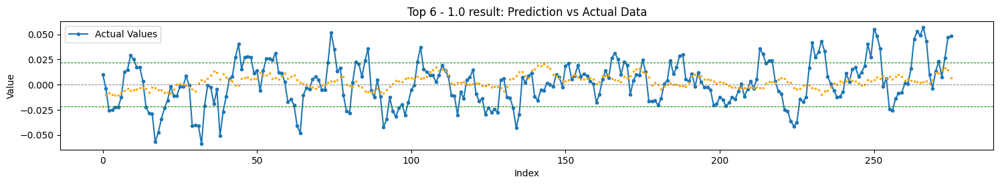

Total TH Pred.: 0


Top 7 - 1.0
RMSE: 0.021253, STD_DEV: 0.021968, STD_PRD: 0.003182, OBJDIFF: 0.003981, RDIFF: -0.000715
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022365, inv. diff> 0.009790
Trend accuracy       : 53.455
Trend up accuracy    : 70.548
Trend down accuracy  : 34.109


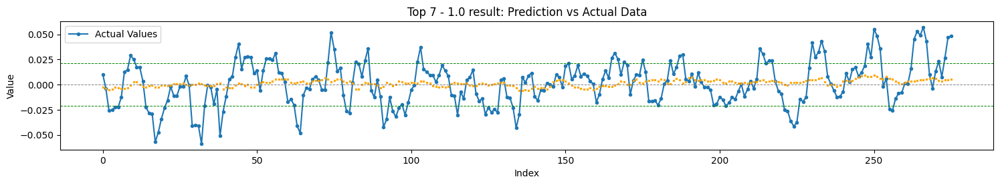

Total TH Pred.: 0


Top 8 - 1.0
RMSE: 0.021928, STD_DEV: 0.022002, STD_PRD: 0.005410, OBJDIFF: 0.004074, RDIFF: -0.000074
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.GlorotUniform object at 0x7495cd0f7b50>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022877, inv. diff> 0.009171
Trend accuracy       : 52.030
Trend up accuracy    : 64.828
Trend down accuracy  : 37.302


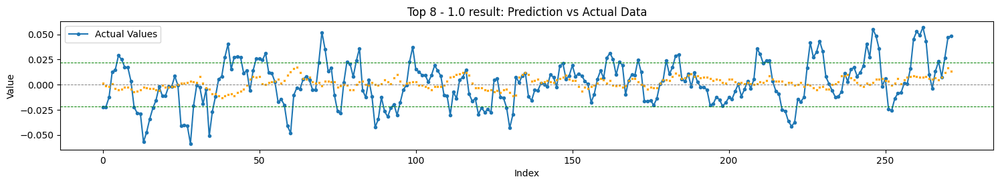

Total TH Pred.: 0


Top 9 - 1.0
RMSE: 0.021642, STD_DEV: 0.022002, STD_PRD: 0.003914, OBJDIFF: 0.004162, RDIFF: -0.000359
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022384, inv. diff> 0.009426
Trend accuracy       : 57.934
Trend up accuracy    : 57.931
Trend down accuracy  : 57.937


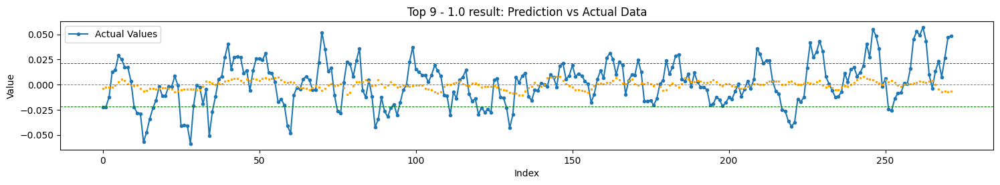

Total TH Pred.: 0


Top 10 - 1.0
RMSE: 0.021897, STD_DEV: 0.021968, STD_PRD: 0.003949, OBJDIFF: 0.004433, RDIFF: -0.000072
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022321, inv. diff> 0.009362
Trend accuracy       : 52.364
Trend up accuracy    : 39.041
Trend down accuracy  : 67.442


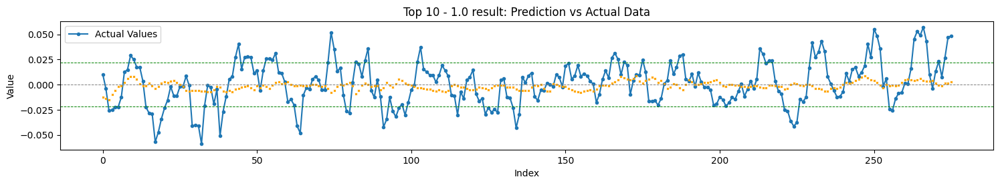

Total TH Pred.: 0


Top 11 - 1.0
RMSE: 0.021910, STD_DEV: 0.021968, STD_PRD: 0.003931, OBJDIFF: 0.004451, RDIFF: -0.000059
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022419, inv. diff> 0.009469
Trend accuracy       : 49.455
Trend up accuracy    : 63.014
Trend down accuracy  : 34.109


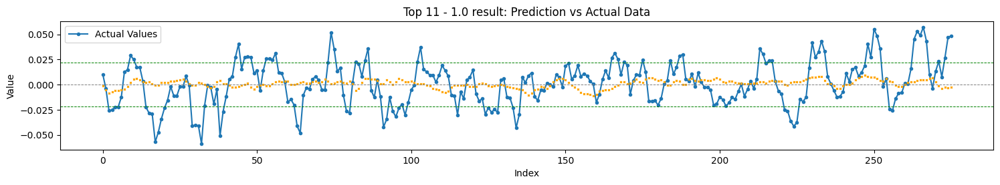

Total TH Pred.: 0


Top 12 - 1.0
RMSE: 0.021988, STD_DEV: 0.022002, STD_PRD: 0.003545, OBJDIFF: 0.004601, RDIFF: -0.000014
batch_size: 128, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022379, inv. diff> 0.009605
Trend accuracy       : 47.601
Trend up accuracy    : 57.241
Trend down accuracy  : 36.508


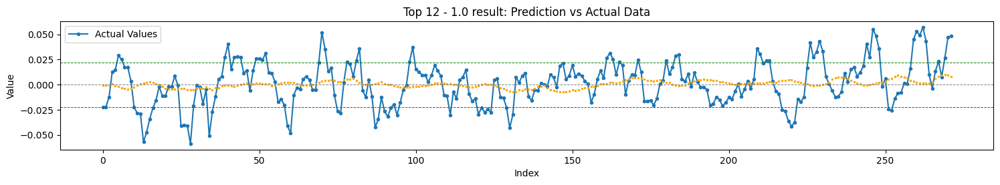

Total TH Pred.: 0


Top 13 - 1.0
RMSE: 0.021995, STD_DEV: 0.022002, STD_PRD: 0.002435, OBJDIFF: 0.004885, RDIFF: -0.000007
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 75, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.Orthogonal object at 0x7494ee759de0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.022324, inv. diff> 0.010106
Trend accuracy       : 51.095
Trend up accuracy    : 76.552
Trend down accuracy  : 22.481


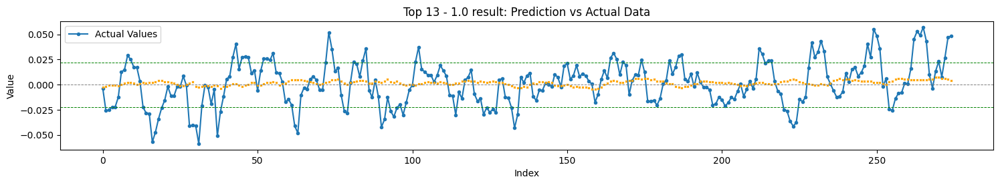

Total TH Pred.: 0


Top 14 - 1.0
RMSE: 0.028833, STD_DEV: 0.022002, STD_PRD: 0.020668, OBJDIFF: 0.007498, RDIFF: 0.006831
batch_size: 64, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 75, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.030244, inv. diff> 0.008909
Trend accuracy       : 55.720
Trend up accuracy    : 55.862
Trend down accuracy  : 55.556


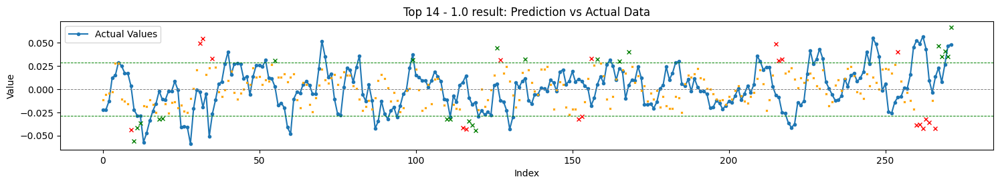

Total TH Pred.: 42
TH Pred. acc. : 52.38


Top 15 - 1.0
RMSE: 0.026621, STD_DEV: 0.021968, STD_PRD: 0.016179, OBJDIFF: 0.007547, RDIFF: 0.004653
batch_size: 256, epochs: 300
Model params:  {'lstm_units1': 25, 'lstm_units2': 25, 'activation': 'relu', 'dropout': 0.15, 'num_layers': 2, 'initializer': <keras.src.initializers.initializers.HeNormal object at 0x7495c47879a0>}
Feature list:  ['LMCADS03', 'LMCADY', 'SPX', 'MXWD', 'XAG', 'XAU', 'ACU_5D', 'ACU_4D', 'ACU_3D', 'ACU_2D']
Inv. rmse> 0.027305, inv. diff> 0.008231
Trend accuracy       : 52.727
Trend up accuracy    : 49.315
Trend down accuracy  : 56.589


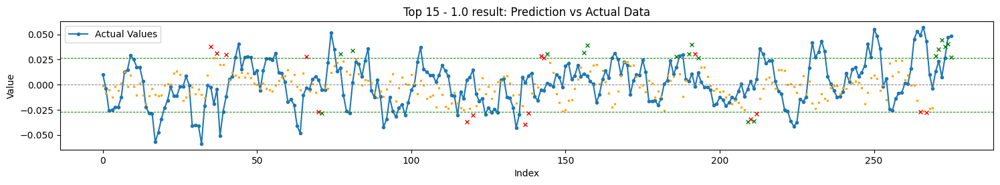

Total TH Pred.: 34
TH Pred. acc. : 52.94




In [17]:
for mult in [.5,.6,.7,.8,.9,1.0]:
    for i,result in enumerate(top_results_sort,1):

        # if result['rmse']-result['std_dev'] >= 0:
        #     continue

        print(f"Top {i} - {mult}")

        # if (result['rmse']<result['std_dev']):
        #     result['diff'] = result['rmse']-result['std_dev'] + abs(np.std(result['predictions']) - result['std_dev'])/4.0
        # else:
        #     result['diff'] = (result['rmse']- result['std_dev']) + abs(np.std(result['predictions']) - result['std_dev'])/2.0

        print("RMSE: {:.6f}, STD_DEV: {:.6f}, STD_PRD: {:.6f}, OBJDIFF: {:.6f}, RDIFF: {:.6f}".format(result['rmse'], result['std_dev'], np.std(result['predictions']), result['diff'],result['rmse']-result['std_dev']))
        # print("n_steps: {}, batch_size: {}, epochs: {}".format(result['n_steps'], result['batch_size'], result['epochs']))
        print("batch_size: {}, epochs: {}".format(result['batch_size'], result['epochs']))
        print("Model params: ", result['md_prm'])
        print("Feature list: ", result['feature_list'])

        # var_tot     = set(variable_options)
        # fea_list    = set(result['feature_list'])
        # print("Discarded var: {}".format(var_tot - fea_list))

        result['inv_rmse'] = inv_rmse = rmse(result['true_values'], result['predictions']*-1)
        inv_diff = (inv_rmse - result['std_dev']) + abs(np.std(result['predictions']) - result['std_dev'])/2.0
        print("Inv. rmse> {:.6f}, inv. diff> {:.6f}".format(inv_rmse, inv_diff))

        # calculate trend prediction percentage

        trend_up_true   = 0
        trend_down_true = 0
        trend_up_pred   = 0
        trend_down_pred = 0

        for j in range(len(result['true_values'])-1):
            if result['true_values'][j] > 0.0:
                trend_up_pred += 1
                if result['predictions'][j] > 0.0:
                    trend_up_true += 1
            if result['true_values'][j] < 0.0:
                trend_down_pred += 1
                if result['predictions'][j] < 0.0:
                    trend_down_true += 1

        trend_true      = trend_up_true + trend_down_true
        trend_pred      = trend_up_pred + trend_down_pred
        trend_accuracy  = trend_true/trend_pred
        print("Trend accuracy       : {:.3f}".format(trend_accuracy*100))
        print("Trend up accuracy    : {:.3f}".format(trend_up_true*100/trend_up_pred))
        print("Trend down accuracy  : {:.3f}".format(trend_down_true*100/trend_down_pred))


        tot_pred, prof, loss = plot_predictions(result['true_values'], result['predictions'],-1, title=f"Top {i} - {mult} result: Prediction vs Actual Data",rmse=result['rmse']*mult)
        print("Total TH Pred.: {}".format(tot_pred))
        if tot_pred != 0:
            print("TH Pred. acc. : {:.2f}".format(prof*100.0/tot_pred))
        print('\n')


In [20]:
# export the best result predictions and true values to a csv file
best_result = top_results[6]
best_result_df = pd.DataFrame({'True Values': best_result['true_values'], 'Predictions': best_result['predictions'].flatten()})
best_result_df.to_csv('../output/lstm_best_result.csv', index=False)